In [1]:
import fasttext
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
import numpy as np

In [2]:
# functions
def cossim(vec1, vec2):
    """Return cosine similarity between vec1 and vec2"""
    dot_product = sum(a*b for a, b in zip(vec1, vec2))
    magnitude1 = math.sqrt(sum([val**2 for val in vec1]))
    magnitude2 = math.sqrt(sum([val**2 for val in vec2]))
    return dot_product / (magnitude1 * magnitude2)
def euclid(vec1, vec2):
    vec1, vec2 = np.array(vec1), np.array(vec2)
    return np.linalg.norm(vec1 - vec2)
def get(model, word):
    """Return word embedding for word as in model"""
    return model.get_word_vector(word)

In [3]:
# word embedding models load
en_model_path = 'cc.en.300.bin'
es_model_path = 'cc.es.300.bin'
de_model_path = 'cc.de.300.bin'

In [4]:
en = fasttext.load_model(en_model_path)
es = fasttext.load_model(es_model_path)
de = fasttext.load_model(de_model_path)

In [5]:
# target group: gender names
genders = {
    "en":[
        # ['male', 'he', 'him', 'his', 'man', 'boy', 'son', 'brother'], 
        # ['female', 'she', 'her', 'hers', 'woman', 'girl', 'daughter', 'sister'], 
        # ['nonbinary', 'they', 'them', 'theirs', 'person', 'child', 'children', 'sibling']
        ['man'],
        ['woman'],
        # ['person']
        ],
    "es":[
        # ['masculino', 'él', 'hombre', 'chico', 'hijo', 'hermano'], 
        # ['feminino', 'ella', 'mujer', 'chica', 'hija', 'hermana'], 
        # ['persona', 'individual'],
        ['hombre'],
        ['mujer'],
        # ['persona']
        ],
    "de":[
        # ['er', 'ihm', 'sein', 'Mann', 'Junge', 'Sohn', 'Bruder'],
        # ['sie', 'ihr', 'Frau', 'Mädchen', 'Tochter', 'Schwester'],
        # ['nichtbinär', 'ihres', 'Person', 'Kind', 'Kinder', 'Geschwister'],
        ['Mann'],
        ['Frau'],
        # ['Individuum']
        ],
}

# target group: determiners (gendered or ungendered definite articles)
determiners = {
    "en":[['the']],
    "es":[['el', 'la']],
    "de":[['der', 'die', 'das']]
}


In [37]:
bar = '---------------------------------------------------------------'

In [6]:

# CONTROL DATA dataframe initialization
control_data = pd.DataFrame(columns=["LANGUAGE", "TARGET CATEGORY", "TARGET WORD", "REFERENCE PART OF SPEECH", 
                                     "REFERENCE ASSOCIATION/GRAMMATICAL GENDER", "REFERENCE TRANSLATION", 
                                     "REFERENCE WORD", "COSINE SIMILARITY"])

# TEST DATA dataframe initialization
test_data = pd.DataFrame(columns=["LANGUAGE", "NOUN GRAMMATICAL GENDER", "NOUN TRANSLATION", "NOUN", 
                                  "ADJECTIVE ASSOCIATION", "ADJECTIVE TRANSLATION", "ADJECTIVE", "COSINE SIMILARITY"])


In [7]:

# giving variables string names for writing to csv
models = {"en": en, "es": es, "de": de}
target_types = {"genders": genders, "determiners": determiners}



In [42]:
# Corrected dataframe loading and checking
df = pd.read_csv('RAW_DATA.csv', sep=',')
for lang in languages:
    noun_df = df[(df['LANGUAGE'] == lang) & (df['PART OF SPEECH'] == 'noun')]
    adj_df = df[(df['LANGUAGE'] == lang) & (df['PART OF SPEECH'] == 'adjective')]
    print(f"{lang} nouns: {len(noun_df)}")
    print(f"{lang} adjectives: {len(adj_df)}")


en nouns: 86
en adjectives: 400
es nouns: 80
es adjectives: 400
de nouns: 76
de adjectives: 400


In [43]:
# calculation type - cossim (cosine similarity) or euclid (euclidian distance)
calc = cossim

In [44]:
# collection of data (writing to csv for CONTROL DATA and TEST DATA)
for lang in models.keys():
    print(bar*2)
    print(f'processing: {lang}')
    for target_category, target_lists in target_types.items():
        print(f'processing: {target_category}')
        for sublist_index, target_list in enumerate(target_lists[lang]):
            print(f'processing: {target_list}')
            for pos in ['noun', 'adjective']:
                for target_word in target_list:
                    print(f'processing: {target_word}')
                    for assoc_gender in ['masculine', 'feminine', 'neuter']:
                        print(f'processing: {assoc_gender}')
                        temp_df = df[(df['LANGUAGE'] == lang) & 
                                    (df['PART OF SPEECH'] == pos) & 
                                    (df['ASSOCIATION/GRAMMATICAL GENDER'] == assoc_gender)]
                        
                        for _, ref_row in temp_df.iterrows():
                            ref_vec = get(models[lang], ref_row['WORD'])
                            target_vec = get(models[lang], target_word)
                            similarity = calc(ref_vec, target_vec)
                            sublist_name = target_word if target_category == 'determiners' else ["Male attributes", "Female attributes", "Neuter attributes"][sublist_index]
                            control_data = control_data._append({"LANGUAGE": lang, 
                                                                "TARGET CATEGORY": target_category, 
                                                                "TARGET WORD": target_word, 
                                                                "SUB-LIST": sublist_name,
                                                                "REFERENCE PART OF SPEECH": pos, 
                                                                "REFERENCE ASSOCIATION/GRAMMATICAL GENDER": assoc_gender,
                                                                "REFERENCE TRANSLATION": ref_row['TRANSLATION'], 
                                                                "REFERENCE WORD": ref_row['WORD'], 
                                                                "COSINE SIMILARITY": similarity}, ignore_index=True)

    noun_df = df[(df['LANGUAGE'] == lang) & (df['PART OF SPEECH'] == 'noun')]
    adj_df = df[(df['LANGUAGE'] == lang) & (df['PART OF SPEECH'] == 'adjective')]
    print(bar)
    for _, noun_row in noun_df.iterrows():
        print(f'processing: {noun_row}')
        for _, adj_row in adj_df.iterrows():
            print(f'processing: {adj_row}')
            noun_vec = get(models[lang], noun_row['WORD'])
            adj_vec = get(models[lang], adj_row['WORD'])
            similarity = calc(noun_vec, adj_vec)
            test_data = test_data._append({"LANGUAGE": lang, 
                                        "NOUN GRAMMATICAL GENDER": noun_row['ASSOCIATION/GRAMMATICAL GENDER'], 
                                        "NOUN TRANSLATION": noun_row['TRANSLATION'], 
                                        "NOUN": noun_row['WORD'], 
                                        "ADJECTIVE ASSOCIATION": adj_row['ASSOCIATION/GRAMMATICAL GENDER'], 
                                        "ADJECTIVE TRANSLATION": adj_row['TRANSLATION'], 
                                        "ADJECTIVE": adj_row['WORD'], 
                                        "COSINE SIMILARITY": similarity}, ignore_index=True)

------------------------------------------------------------------------------------------------------------------------------
processing: en
processing: genders
processing: ['man']
processing: man
processing: masculine
processing: feminine
processing: neuter
processing: man
processing: masculine
processing: feminine
processing: neuter
processing: ['woman']
processing: woman
processing: masculine
processing: feminine
processing: neuter
processing: woman
processing: masculine
processing: feminine
processing: neuter
processing: determiners
processing: ['the']
processing: the
processing: masculine
processing: feminine
processing: neuter
processing: the
processing: masculine
processing: feminine
processing: neuter
---------------------------------------------------------------
processing: PART OF SPEECH                      noun
LANGUAGE                              en
ASSOCIATION/GRAMMATICAL GENDER    neuter
WORD                               spoon
TRANSLATION                        spoon

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fittest
TRANSLATION                         fittest
cosine_similarity_to_target        0.314992
Name: 342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   poor
TRANSLATION                            poor
cosine_similarity_to_target        0.314694
Name: 343, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              invincible
TRANSLATION                       invincible
cosine_similarity_to_target          0.31275
Name: 344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              unmarried
TRANSLATION                       unmarried
cosine_similarity_to_target        0.511415
Name: 443, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  young
TRANSLATION                           young
cosine_similarity_to_target        0.504642
Name: 444, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.456597
Name: 445, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.299523
Name: 546, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              lascivious
TRANSLATION                       lascivious
cosine_similarity_to_target         0.298449
Name: 547, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              surrogate
TRANSLATION                       surrogate
cosine_similarity_to_target        0.297624
Name: 548, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target        0.419548
Name: 247, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              paraplegic
TRANSLATION                       paraplegic
cosine_similarity_to_target         0.412933
Name: 248, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              chivalrous
TRANSLATION                       chivalrous
cosine_similarity_to_target         0.409298
Name: 249, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              contemptible
TRANSLATION                       contemptible
cosine_similarity_to_target           0.311604
Name: 347, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              garrulous
TRANSLATION                       garrulous
cosine_similarity_to_target        0.311568
Name: 348, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              illiterate
TRANSLATION                       illiterate
cosine_similarity_to_target         0.311554
Name: 349, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              transexual
TRANSLATION                       transexual
cosine_similarity_to_target         0.422599
Name: 452, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuous
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.422189
Name: 453, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               biracial
TRANSLATION                        biracial
cosine_similarity_to_target        0.420332
Name: 454, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               alluring
TRANSLATION                        alluring
cosine_similarity_to_target         0.29277
Name: 555, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              aboriginal
TRANSLATION                       aboriginal
cosine_similarity_to_target         0.291131
Name: 556, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               amourous
TRANSLATION                        amourous
cosine_similarity_to_target        0.290623
Name: 557, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               homeless
TRANSLATION                        homeless
cosine_similarity_to_target         0.37692
Name: 262, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              sagacious
TRANSLATION                       sagacious
cosine_similarity_to_target        0.374567
Name: 263, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.374136
Name: 264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              peaceable
TRANSLATION                       peaceable
cosine_similarity_to_target        0.305811
Name: 362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.305656
Name: 363, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.403103
Name: 463, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 trampy
TRANSLATION                          trampy
cosine_similarity_to_target        0.396896
Name: 464, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Caucasian
TRANSLATION                       Caucasian
cosine_similarity_to_target        0.395229
Name: 465, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              gynaecological
TRANSLATION                       gynaecological
cosine_similarity_to_target              0.29012
Name: 559, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              matrilineal
TRANSLATION                       matrilineal
cosine_similarity_to_target            0.2901
Name: 560, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spunkiest
TRANSLATION                       spunkiest
cosine_similarity_to_target        0.289562
Name: 561, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.398227
Name: 256, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                brutish
TRANSLATION                         brutish
cosine_similarity_to_target        0.393265
Name: 257, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                swarthy
TRANSLATION                         swarthy
cosine_similarity_to_target        0.389303
Name: 258, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              honerable
TRANSLATION                       honerable
cosine_similarity_to_target        0.306254
Name: 360, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              defenceless
TRANSLATION                       defenceless
cosine_similarity_to_target          0.305877
Name: 361, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              peaceable
TRANSLATION                       peaceable
cosine_similarity_to_target        0.305811
Name: 362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                pregent
TRANSLATION                         pregent
cosine_similarity_to_target        0.412572
Name: 458, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               hispanic
TRANSLATION                        hispanic
cosine_similarity_to_target        0.412258
Name: 459, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unmarriageable
TRANSLATION                       unmarriageable
cosine_similarity_to_target             0.410857
Name: 460, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               amourous
TRANSLATION                        amourous
cosine_similarity_to_target        0.290623
Name: 557, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              mysterious
TRANSLATION                       mysterious
cosine_similarity_to_target         0.290474
Name: 558, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              gynaecological
TRANSLATION                       gynaecological
cosine_similarity_to_target              0.29012
Name: 559, dtype: object
processing: PART OF SPEECH                      adjective
LAN

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  lanky
TRANSLATION                           lanky
cosine_similarity_to_target        0.383488
Name: 260, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrious
TRANSLATION                       industrious
cosine_similarity_to_target          0.381433
Name: 261, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               homeless
TRANSLATION                        homeless
cosine_similarity_to_target         0.37692
Name: 262, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unworthy
TRANSLATION                        unworthy
cosine_similarity_to_target        0.305073
Name: 366, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              scrawniest
TRANSLATION                       scrawniest
cosine_similarity_to_target         0.304376
Name: 367, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target        0.302492
Name: 368, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.403103
Name: 463, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 trampy
TRANSLATION                          trampy
cosine_similarity_to_target        0.396896
Name: 464, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Caucasian
TRANSLATION                       Caucasian
cosine_similarity_to_target        0.395229
Name: 465, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              matrilineal
TRANSLATION                       matrilineal
cosine_similarity_to_target            0.2901
Name: 560, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spunkiest
TRANSLATION                       spunkiest
cosine_similarity_to_target        0.289562
Name: 561, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              consensual
TRANSLATION                       consensual
cosine_similarity_to_target         0.287076
Name: 562, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                brutish
TRANSLATION                         brutish
cosine_similarity_to_target        0.393265
Name: 257, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                swarthy
TRANSLATION                         swarthy
cosine_similarity_to_target        0.389303
Name: 258, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hulky
TRANSLATION                           hulky
cosine_similarity_to_target        0.387978
Name: 259, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wisest
TRANSLATION                          wisest
cosine_similarity_to_target        0.307482
Name: 358, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unmutilated
TRANSLATION                       unmutilated
cosine_similarity_to_target          0.306762
Name: 359, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              honerable
TRANSLATION                       honerable
cosine_similarity_to_target        0.306254
Name: 360, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 haired
TRANSLATION                          haired
cosine_similarity_to_target        0.365524
Name: 483, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              misogynistic
TRANSLATION                       misogynistic
cosine_similarity_to_target           0.365181
Name: 484, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target          0.3651
Name: 485, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                Prudish
TRANSLATION                         Prudish
cosine_similarity_to_target         0.26897
Name: 583, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.268783
Name: 584, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               charmful
TRANSLATION                        charmful
cosine_similarity_to_target        0.268508
Name: 585, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              workaholic
TRANSLATION                       workaholic
cosine_similarity_to_target          0.35698
Name: 282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                lunatic
TRANSLATION                         lunatic
cosine_similarity_to_target         0.35576
Name: 283, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              unidentified
TRANSLATION                       unidentified
cosine_similarity_to_target           0.354817
Name: 284, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              indefatigable
TRANSLATION                       indefatigable
cosine_similarity_to_target             0.29731
Name: 384, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              benevolent
TRANSLATION                       benevolent
cosine_similarity_to_target         0.297258
Name: 385, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pregnant
TRANSLATION                        Pregnant
cosine_similarity_to_target        0.365587
Name: 482, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 haired
TRANSLATION                          haired
cosine_similarity_to_target        0.365524
Name: 483, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              misogynistic
TRANSLATION                       misogynistic
cosine_similarity_to_target           0.365181
Name: 484, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Menopausal
TRANSLATION                       Menopausal
cosine_similarity_to_target         0.273525
Name: 579, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 carnal
TRANSLATION                          carnal
cosine_similarity_to_target        0.272709
Name: 580, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sterotypical
TRANSLATION                       sterotypical
cosine_similarity_to_target           0.270976
Name: 581, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.357356
Name: 281, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              workaholic
TRANSLATION                       workaholic
cosine_similarity_to_target          0.35698
Name: 282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 haired
TRANSLATION                          haired
cosine_similarity_to_target        0.365524
Name: 483, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              misogynistic
TRANSLATION                       misogynistic
cosine_similarity_to_target           0.365181
Name: 484, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target          0.3651
Name: 485, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.268783
Name: 584, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               charmful
TRANSLATION                        charmful
cosine_similarity_to_target        0.268508
Name: 585, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                UNARMED
TRANSLATION                         UNARMED
cosine_similarity_to_target        0.267556
Name: 586, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.357356
Name: 281, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              workaholic
TRANSLATION                       workaholic
cosine_similarity_to_target          0.35698
Name: 282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                lunatic
TRANSLATION                         lunatic
cosine_similarity_to_target         0.35576
Name: 283, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE     

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              patriarchical
TRANSLATION                       patriarchical
cosine_similarity_to_target            0.366852
Name: 480, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.366536
Name: 481, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pregnant
TRANSLATION                        Pregnant
cosine_similarity_to_target        0.365587
Name: 482, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Menopausal
TRANSLATION                       Menopausal
cosine_similarity_to_target         0.273525
Name: 579, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 carnal
TRANSLATION                          carnal
cosine_similarity_to_target        0.272709
Name: 580, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sterotypical
TRANSLATION                       sterotypical
cosine_similarity_to_target           0.270976
Name: 581, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.357356
Name: 281, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              workaholic
TRANSLATION                       workaholic
cosine_similarity_to_target          0.35698
Name: 282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.298422
Name: 378, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               trustful
TRANSLATION                        trustful
cosine_similarity_to_target        0.298059
Name: 379, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              egoistical
TRANSLATION                       egoistical
cosine_similarity_to_target         0.298037
Name: 380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nymphomaniacal
TRANSLATION                       nymphomaniacal
cosine_similarity_to_target             0.372061
Name: 476, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfeminine
TRANSLATION                       unfeminine
cosine_similarity_to_target         0.371038
Name: 477, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               handsome
TRANSLATION                        handsome
cosine_similarity_to_target        0.370911
Name: 478, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Menopausal
TRANSLATION                       Menopausal
cosine_similarity_to_target         0.273525
Name: 579, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 carnal
TRANSLATION                          carnal
cosine_similarity_to_target        0.272709
Name: 580, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sterotypical
TRANSLATION                       sterotypical
cosine_similarity_to_target           0.270976
Name: 581, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.361506
Name: 276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              righteous
TRANSLATION                       righteous
cosine_similarity_to_target        0.361077
Name: 277, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                lovable
TRANSLATION                         lovable
cosine_similarity_to_target        0.300584
Name: 374, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              avuncular
TRANSLATION                       avuncular
cosine_similarity_to_target        0.299819
Name: 375, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               studious
TRANSLATION                        studious
cosine_similarity_to_target        0.298693
Name: 376, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nymphomaniacal
TRANSLATION                       nymphomaniacal
cosine_similarity_to_target             0.372061
Name: 476, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfeminine
TRANSLATION                       unfeminine
cosine_similarity_to_target         0.371038
Name: 477, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               handsome
TRANSLATION                        handsome
cosine_similarity_to_target        0.370911
Name: 478, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sterotypical
TRANSLATION                       sterotypical
cosine_similarity_to_target           0.270976
Name: 581, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.270174
Name: 582, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                Prudish
TRANSLATION                         Prudish
cosine_similarity_to_target         0.26897
Name: 583, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.348932
Name: 288, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schizophrenic
TRANSLATION                       schizophrenic
cosine_similarity_to_target            0.347645
Name: 289, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                wealthy
TRANSLATION                         wealthy
cosine_similarity_to_target        0.347305
Name: 290, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              indefatigable
TRANSLATION                       indefatigable
cosine_similarity_to_target             0.29731
Name: 384, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              benevolent
TRANSLATION                       benevolent
cosine_similarity_to_target         0.297258
Name: 385, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              defenseless
TRANSLATION                       defenseless
cosine_similarity_to_target          0.297012
Name: 386, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  busty
TRANSLATION                           busty
cosine_similarity_to_target         0.36141
Name: 487, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              attracive
TRANSLATION                       attracive
cosine_similarity_to_target        0.361262
Name: 488, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muslim
TRANSLATION                          muslim
cosine_similarity_to_target        0.359341
Name: 489, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inoccent
TRANSLATION                        inoccent
cosine_similarity_to_target        0.267249
Name: 588, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.265104
Name: 589, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              interacial
TRANSLATION                       interacial
cosine_similarity_to_target          0.26432
Name: 590, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              unidentified
TRANSLATION                       unidentified
cosine_similarity_to_target           0.354817
Name: 284, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                vagrant
TRANSLATION                         vagrant
cosine_similarity_to_target        0.351387
Name: 285, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               innocent
TRANSLATION                        innocent
cosine_similarity_to_target        0.349741
Name: 286, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              egoistical
TRANSLATION                       egoistical
cosine_similarity_to_target         0.298037
Name: 380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  naked
TRANSLATION                           naked
cosine_similarity_to_target        0.374053
Name: 475, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nymphomaniacal
TRANSLATION                       nymphomaniacal
cosine_similarity_to_target             0.372061
Name: 476, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfeminine
TRANSLATION                       unfeminine
cosine_similarity_to_target         0.371038
Name: 477, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 SINGLE
TRANSLATION                          SINGLE
cosine_similarity_to_target        0.283706
Name: 568, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.282668
Name: 569, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   lewd
TRANSLATION                            lewd
cosine_similarity_to_target        0.280289
Name: 570, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.374136
Name: 264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               immortal
TRANSLATION                        immortal
cosine_similarity_to_target        0.372683
Name: 265, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target        0.371383
Name: 266, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  dumpy
TRANSLATION                           dumpy
cosine_similarity_to_target        0.308394
Name: 357, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wisest
TRANSLATION                          wisest
cosine_similarity_to_target        0.307482
Name: 358, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unmutilated
TRANSLATION                       unmutilated
cosine_similarity_to_target          0.306762
Name: 359, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.431153
Name: 450, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target         0.42728
Name: 451, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              transexual
TRANSLATION                       transexual
cosine_similarity_to_target         0.422599
Name: 452, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              multiracial
TRANSLATION                       multiracial
cosine_similarity_to_target          0.300461
Name: 544, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.300182
Name: 545, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.299523
Name: 546, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              osteoporotic
TRANSLATION                       osteoporotic
cosine_similarity_to_target           0.241896
Name: 636, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                titular
TRANSLATION                         titular
cosine_similarity_to_target        0.241342
Name: 637, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  leady
TRANSLATION                           leady
cosine_similarity_to_target        0.241223
Name: 638, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              incorruptible
TRANSLATION                       incorruptible
cosine_similarity_to_target            0.324461
Name: 328, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              blameless
TRANSLATION                       blameless
cosine_similarity_to_target        0.324188
Name: 329, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              ambisexual
TRANSLATION                       ambisexual
cosine_similarity_to_target         0.323855
Name: 330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.286604
Name: 421, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.286519
Name: 422, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              unwealthy
TRANSLATION                       unwealthy
cosine_similarity_to_target         0.28651
Name: 423, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lustful
TRANSLATION                         lustful
cosine_similarity_to_target        0.326675
Name: 515, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.326271
Name: 516, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.326185
Name: 517, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                genital
TRANSLATION                         genital
cosine_similarity_to_target           0.254
Name: 609, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fictional
TRANSLATION                       fictional
cosine_similarity_to_target         0.25338
Name: 610, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                brutish
TRANSLATION                         brutish
cosine_similarity_to_target        0.253369
Name: 611, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 devout
TRANSLATION                          devout
cosine_similarity_to_target        0.341349
Name: 301, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              irascible
TRANSLATION                       irascible
cosine_similarity_to_target         0.34046
Name: 302, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340316
Name: 303, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fallible
TRANSLATION                        fallible
cosine_similarity_to_target        0.294438
Name: 396, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.293694
Name: 397, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target            0.29366
Name: 398, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.354922
Name: 491, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              flirtatious
TRANSLATION                       flirtatious
cosine_similarity_to_target          0.353652
Name: 492, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptious
TRANSLATION                       voluptious
cosine_similarity_to_target         0.353295
Name: 493, dtype: object
processing: PART OF SPEECH                     adjective
LANG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inoccent
TRANSLATION                        inoccent
cosine_similarity_to_target        0.267249
Name: 588, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.265104
Name: 589, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              interacial
TRANSLATION                       interacial
cosine_similarity_to_target          0.26432
Name: 590, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                vagrant
TRANSLATION                         vagrant
cosine_similarity_to_target        0.351387
Name: 285, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               innocent
TRANSLATION                        innocent
cosine_similarity_to_target        0.349741
Name: 286, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  brave
TRANSLATION                           brave
cosine_similarity_to_target        0.349652
Name: 287, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              indefatigable
TRANSLATION                       indefatigable
cosine_similarity_to_target             0.29731
Name: 384, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              benevolent
TRANSLATION                       benevolent
cosine_similarity_to_target         0.297258
Name: 385, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bearded
TRANSLATION                         bearded
cosine_similarity_to_target        0.370197
Name: 479, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              patriarchical
TRANSLATION                       patriarchical
cosine_similarity_to_target            0.366852
Name: 480, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.366536
Name: 481, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.275774
Name: 576, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                butiful
TRANSLATION                         butiful
cosine_similarity_to_target         0.27468
Name: 577, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              interracial
TRANSLATION                       interracial
cosine_similarity_to_target          0.274421
Name: 578, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                affable
TRANSLATION                         affable
cosine_similarity_to_target         0.36248
Name: 274, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                    old
TRANSLATION                             old
cosine_similarity_to_target        0.362344
Name: 275, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.361506
Name: 276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 carnal
TRANSLATION                          carnal
cosine_similarity_to_target        0.301248
Name: 372, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              incorrigible
TRANSLATION                       incorrigible
cosine_similarity_to_target           0.300933
Name: 373, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                lovable
TRANSLATION                         lovable
cosine_similarity_to_target        0.300584
Name: 374, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 unborn
TRANSLATION                          unborn
cosine_similarity_to_target        0.375815
Name: 474, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  naked
TRANSLATION                           naked
cosine_similarity_to_target        0.374053
Name: 475, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nymphomaniacal
TRANSLATION                       nymphomaniacal
cosine_similarity_to_target             0.372061
Name: 476, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                younder
TRANSLATION                         younder
cosine_similarity_to_target         0.27847
Name: 573, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              animalistic
TRANSLATION                       animalistic
cosine_similarity_to_target          0.277871
Name: 574, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               underage
TRANSLATION                        underage
cosine_similarity_to_target        0.277455
Name: 575, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                noblest
TRANSLATION                         noblest
cosine_similarity_to_target        0.370548
Name: 268, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.367806
Name: 269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.367286
Name: 270, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              peaceable
TRANSLATION                       peaceable
cosine_similarity_to_target        0.305811
Name: 362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.305656
Name: 363, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               hispanic
TRANSLATION                        hispanic
cosine_similarity_to_target        0.412258
Name: 459, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unmarriageable
TRANSLATION                       unmarriageable
cosine_similarity_to_target             0.410857
Name: 460, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virginal
TRANSLATION                        virginal
cosine_similarity_to_target        0.405972
Name: 461, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               alluring
TRANSLATION                        alluring
cosine_similarity_to_target         0.29277
Name: 555, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              aboriginal
TRANSLATION                       aboriginal
cosine_similarity_to_target         0.291131
Name: 556, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               amourous
TRANSLATION                        amourous
cosine_similarity_to_target        0.290623
Name: 557, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 stocky
TRANSLATION                          stocky
cosine_similarity_to_target        0.409203
Name: 250, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 brawny
TRANSLATION                          brawny
cosine_similarity_to_target         0.40622
Name: 251, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              handsomest
TRANSLATION                       handsomest
cosine_similarity_to_target          0.40524
Name: 252, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              illiterate
TRANSLATION                       illiterate
cosine_similarity_to_target         0.311554
Name: 349, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lowliest
TRANSLATION                        lowliest
cosine_similarity_to_target        0.310052
Name: 350, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              childless
TRANSLATION                       childless
cosine_similarity_to_target        0.444178
Name: 446, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target         0.44038
Name: 447, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              marriagable
TRANSLATION                       marriagable
cosine_similarity_to_target          0.437544
Name: 448, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              mysterious
TRANSLATION                       mysterious
cosine_similarity_to_target         0.290474
Name: 558, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              gynaecological
TRANSLATION                       gynaecological
cosine_similarity_to_target              0.29012
Name: 559, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              matrilineal
TRANSLATION                       matrilineal
cosine_similarity_to_target            0.2901
Name: 560, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.402764
Name: 254, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.399602
Name: 255, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.398227
Name: 256, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.309717
Name: 353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.437199
Name: 449, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.431153
Name: 450, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target         0.42728
Name: 451, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              lascivious
TRANSLATION                       lascivious
cosine_similarity_to_target         0.298449
Name: 547, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              surrogate
TRANSLATION                       surrogate
cosine_similarity_to_target        0.297624
Name: 548, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              Androgynous
TRANSLATION                       Androgynous
cosine_similarity_to_target          0.296734
Name: 549, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              blameless
TRANSLATION                       blameless
cosine_similarity_to_target         0.23866
Name: 641, dtype: object
processing: PART OF SPEECH                       noun
LANGUAGE                               en
ASSOCIATION/GRAMMATICAL GENDER     neuter
WORD                              ketchup
TRANSLATION                       ketchup
cosine_similarity_to_target           NaN
Name: 60, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  young
TRANSLATION                           young
cosine_similarity_to_target         0.51076
Name: 242, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATIO

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   tall
TRANSLATION                            tall
cosine_similarity_to_target        0.321303
Name: 334, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               helpless
TRANSLATION                        helpless
cosine_similarity_to_target        0.320393
Name: 335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.319679
Name: 336, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zealous
TRANSLATION                         zealous
cosine_similarity_to_target        0.285052
Name: 430, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              archetypical
TRANSLATION                       archetypical
cosine_similarity_to_target           0.284932
Name: 431, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  sober
TRANSLATION                           sober
cosine_similarity_to_target        0.284825
Name: 432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                slender
TRANSLATION                         slender
cosine_similarity_to_target        0.314075
Name: 524, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvacious
TRANSLATION                       curvacious
cosine_similarity_to_target         0.313457
Name: 525, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              handsomest
TRANSLATION                       handsomest
cosine_similarity_to_target         0.313215
Name: 526, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 Indian
TRANSLATION                          Indian
cosine_similarity_to_target        0.251543
Name: 617, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gorgerous
TRANSLATION                       gorgerous
cosine_similarity_to_target        0.251175
Name: 618, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  OLDER
TRANSLATION                           OLDER
cosine_similarity_to_target        0.250924
Name: 619, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 manful
TRANSLATION                          manful
cosine_similarity_to_target        0.338832
Name: 307, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  stoic
TRANSLATION                           stoic
cosine_similarity_to_target        0.337953
Name: 308, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                foolish
TRANSLATION                         foolish
cosine_similarity_to_target         0.33718
Name: 309, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.293694
Name: 397, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target            0.29366
Name: 398, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                unlucky
TRANSLATION                         unlucky
cosine_similarity_to_target        0.293435
Name: 399, dtype: object
processing: PART OF SPEECH                         adjective


processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              flirtatious
TRANSLATION                       flirtatious
cosine_similarity_to_target          0.353652
Name: 492, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptious
TRANSLATION                       voluptious
cosine_similarity_to_target         0.353295
Name: 493, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              ungendered
TRANSLATION                       ungendered
cosine_similarity_to_target         0.351905
Name: 494, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  Asian
TRANSLATION                           Asian
cosine_similarity_to_target        0.267472
Name: 587, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inoccent
TRANSLATION                        inoccent
cosine_similarity_to_target        0.267249
Name: 588, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.265104
Name: 589, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.361506
Name: 276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              righteous
TRANSLATION                       righteous
cosine_similarity_to_target        0.361077
Name: 277, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                skilful
TRANSLATION                         skilful
cosine_similarity_to_target         0.30552
Name: 365, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unworthy
TRANSLATION                        unworthy
cosine_similarity_to_target        0.305073
Name: 366, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target         0.42728
Name: 451, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              transexual
TRANSLATION                       transexual
cosine_similarity_to_target         0.422599
Name: 452, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuous
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.422189
Name: 453, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target           0.301035
Name: 543, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              multiracial
TRANSLATION                       multiracial
cosine_similarity_to_target          0.300461
Name: 544, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.300182
Name: 545, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                          adjective
LANGUAGE                                       en
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              entreprenuerial
TRANSLATION                       entreprenuerial
cosine_similarity_to_target              0.244672
Name: 631, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 mounty
TRANSLATION                          mounty
cosine_similarity_to_target        0.244537
Name: 632, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              obstetric
TRANSLATION                       obstetric
cosine_similarity_to_target        0.243938
Name: 633, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dutiful
TRANSLATION                         dutiful
cosine_similarity_to_target        0.329753
Name: 318, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              honorable
TRANSLATION                       honorable
cosine_similarity_to_target        0.329714
Name: 319, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  lusty
TRANSLATION                           lusty
cosine_similarity_to_target        0.329693
Name: 320, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               merciful
TRANSLATION                        merciful
cosine_similarity_to_target        0.289824
Name: 412, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target        0.289777
Name: 413, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                hatless
TRANSLATION                         hatless
cosine_similarity_to_target        0.289777
Name: 414, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  black
TRANSLATION                           black
cosine_similarity_to_target         0.34199
Name: 501, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  lusty
TRANSLATION                           lusty
cosine_similarity_to_target        0.341963
Name: 502, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                curvier
TRANSLATION                         curvier
cosine_similarity_to_target         0.34103
Name: 503, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inoccent
TRANSLATION                        inoccent
cosine_similarity_to_target        0.267249
Name: 588, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.265104
Name: 589, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              interacial
TRANSLATION                       interacial
cosine_similarity_to_target          0.26432
Name: 590, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amiable
TRANSLATION                         amiable
cosine_similarity_to_target        0.358368
Name: 279, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wisest
TRANSLATION                          wisest
cosine_similarity_to_target        0.307482
Name: 358, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unmutilated
TRANSLATION                       unmutilated
cosine_similarity_to_target          0.306762
Name: 359, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              honerable
TRANSLATION                       honerable
cosine_similarity_to_target        0.306254
Name: 360, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              archetypical
TRANSLATION                       archetypical
cosine_similarity_to_target           0.284932
Name: 431, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  sober
TRANSLATION                           sober
cosine_similarity_to_target        0.284825
Name: 432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ruthless
TRANSLATION                        ruthless
cosine_similarity_to_target        0.283403
Name: 433, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                wealthy
TRANSLATION                         wealthy
cosine_similarity_to_target        0.323162
Name: 519, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorous
TRANSLATION                         amorous
cosine_similarity_to_target        0.322065
Name: 520, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unattractive
TRANSLATION                       unattractive
cosine_similarity_to_target           0.320655
Name: 521, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gynecological
TRANSLATION                       gynecological
cosine_similarity_to_target            0.252741
Name: 612, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              honorable
TRANSLATION                       honorable
cosine_similarity_to_target        0.252569
Name: 613, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target         0.25223
Name: 614, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              indomitable
TRANSLATION                       indomitable
cosine_similarity_to_target          0.342992
Name: 297, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravest
TRANSLATION                         bravest
cosine_similarity_to_target         0.34259
Name: 298, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              courageous
TRANSLATION                       courageous
cosine_similarity_to_target         0.341961
Name: 299, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Caucasian
TRANSLATION                       Caucasian
cosine_similarity_to_target        0.395229
Name: 465, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.392897
Name: 466, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  curvy
TRANSLATION                           curvy
cosine_similarity_to_target        0.392391
Name: 467, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   aged
TRANSLATION                            aged
cosine_similarity_to_target        0.295732
Name: 550, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravest
TRANSLATION                         bravest
cosine_similarity_to_target        0.295525
Name: 551, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.293761
Name: 552, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.242309
Name: 635, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              osteoporotic
TRANSLATION                       osteoporotic
cosine_similarity_to_target           0.241896
Name: 636, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                titular
TRANSLATION                         titular
cosine_similarity_to_target        0.241342
Name: 637, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               arrogant
TRANSLATION                        arrogant
cosine_similarity_to_target        0.329065
Name: 322, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unconscious
TRANSLATION                       unconscious
cosine_similarity_to_target          0.327642
Name: 323, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              egotistic
TRANSLATION                       egotistic
cosine_similarity_to_target        0.327332
Name: 324, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                boorish
TRANSLATION                         boorish
cosine_similarity_to_target        0.291325
Name: 408, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                kindest
TRANSLATION                         kindest
cosine_similarity_to_target        0.291111
Name: 409, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               eloquent
TRANSLATION                        eloquent
cosine_similarity_to_target        0.290771
Name: 410, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                             

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              ungendered
TRANSLATION                       ungendered
cosine_similarity_to_target         0.351905
Name: 494, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              courageous
TRANSLATION                       courageous
cosine_similarity_to_target         0.350254
Name: 495, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beaufiful
TRANSLATION                       beaufiful
cosine_similarity_to_target        0.346465
Name: 496, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.275774
Name: 576, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                butiful
TRANSLATION                         butiful
cosine_similarity_to_target         0.27468
Name: 577, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              interracial
TRANSLATION                       interracial
cosine_similarity_to_target          0.274421
Name: 578, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrious
TRANSLATION                       industrious
cosine_similarity_to_target          0.381433
Name: 261, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               homeless
TRANSLATION                        homeless
cosine_similarity_to_target         0.37692
Name: 262, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              sagacious
TRANSLATION                       sagacious
cosine_similarity_to_target        0.374567
Name: 263, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humble
TRANSLATION                          humble
cosine_similarity_to_target        0.312502
Name: 345, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuous
TRANSLATION                       impetuous
cosine_similarity_to_target        0.312208
Name: 346, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              contemptible
TRANSLATION                       contemptible
cosine_similarity_to_target           0.311604
Name: 347, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              insensible
TRANSLATION                       insensible
cosine_similarity_to_target         0.285129
Name: 428, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              cleverest
TRANSLATION                       cleverest
cosine_similarity_to_target        0.285115
Name: 429, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zealous
TRANSLATION                         zealous
cosine_similarity_to_target        0.285052
Name: 430, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lustful
TRANSLATION                         lustful
cosine_similarity_to_target        0.326675
Name: 515, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.326271
Name: 516, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.326185
Name: 517, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              obstetrical
TRANSLATION                       obstetrical
cosine_similarity_to_target          0.260637
Name: 601, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beautful
TRANSLATION                        beautful
cosine_similarity_to_target        0.259816
Name: 602, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              syphilitic
TRANSLATION                       syphilitic
cosine_similarity_to_target          0.25906
Name: 603, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  brave
TRANSLATION                           brave
cosine_similarity_to_target        0.349652
Name: 287, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.348932
Name: 288, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schizophrenic
TRANSLATION                       schizophrenic
cosine_similarity_to_target            0.347645
Name: 289, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.298422
Name: 378, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               trustful
TRANSLATION                        trustful
cosine_similarity_to_target        0.298059
Name: 379, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              egoistical
TRANSLATION                       egoistical
cosine_similarity_to_target         0.298037
Name: 380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  mousy
TRANSLATION                           mousy
cosine_similarity_to_target        0.389492
Name: 468, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vivacious
TRANSLATION                       vivacious
cosine_similarity_to_target        0.388156
Name: 469, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 frumpy
TRANSLATION                          frumpy
cosine_similarity_to_target        0.387667
Name: 470, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   aged
TRANSLATION                            aged
cosine_similarity_to_target        0.295732
Name: 550, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravest
TRANSLATION                         bravest
cosine_similarity_to_target        0.295525
Name: 551, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.293761
Name: 552, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bearded
TRANSLATION                         bearded
cosine_similarity_to_target          0.4974
Name: 243, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               handsome
TRANSLATION                        handsome
cosine_similarity_to_target        0.492151
Name: 244, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target        0.434523
Name: 245, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.322707
Name: 331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                untilhe
TRANSLATION                         untilhe
cosine_similarity_to_target        0.322469
Name: 332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               egoistic
TRANSLATION                        egoistic
cosine_similarity_to_target        0.321488
Name: 333, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inquisitive
TRANSLATION                       inquisitive
cosine_similarity_to_target          0.288743
Name: 417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ashamed
TRANSLATION                         ashamed
cosine_similarity_to_target        0.287138
Name: 419, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                curvier
TRANSLATION                         curvier
cosine_similarity_to_target         0.34103
Name: 503, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340173
Name: 504, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              polygamous
TRANSLATION                       polygamous
cosine_similarity_to_target         0.337842
Name: 505, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              interacial
TRANSLATION                       interacial
cosine_similarity_to_target          0.26432
Name: 590, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vaginal
TRANSLATION                         vaginal
cosine_similarity_to_target        0.264186
Name: 591, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.361506
Name: 276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              righteous
TRANSLATION                       righteous
cosine_similarity_to_target        0.361077
Name: 277, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              peaceable
TRANSLATION                       peaceable
cosine_similarity_to_target        0.305811
Name: 362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.305656
Name: 363, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.437199
Name: 449, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.431153
Name: 450, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target         0.42728
Name: 451, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              underaged
TRANSLATION                       underaged
cosine_similarity_to_target         0.30502
Name: 537, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreative
TRANSLATION                       procreative
cosine_similarity_to_target          0.304555
Name: 538, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              indomitable
TRANSLATION                       indomitable
cosine_similarity_to_target          0.303685
Name: 539, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target         0.25223
Name: 614, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              missonary
TRANSLATION                       missonary
cosine_similarity_to_target        0.252133
Name: 615, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gynecologic
TRANSLATION                       gynecologic
cosine_similarity_to_target          0.251894
Name: 616, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 genial
TRANSLATION                          genial
cosine_similarity_to_target        0.340224
Name: 305, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  naked
TRANSLATION                           naked
cosine_similarity_to_target        0.339948
Name: 306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 manful
TRANSLATION                          manful
cosine_similarity_to_target        0.338832
Name: 307, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fallible
TRANSLATION                        fallible
cosine_similarity_to_target        0.294438
Name: 396, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.293694
Name: 397, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target            0.29366
Name: 398, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              attracive
TRANSLATION                       attracive
cosine_similarity_to_target        0.361262
Name: 488, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muslim
TRANSLATION                          muslim
cosine_similarity_to_target        0.359341
Name: 489, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              oversexed
TRANSLATION                       oversexed
cosine_similarity_to_target        0.358365
Name: 490, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 carnal
TRANSLATION                          carnal
cosine_similarity_to_target        0.272709
Name: 580, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sterotypical
TRANSLATION                       sterotypical
cosine_similarity_to_target           0.270976
Name: 581, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.270174
Name: 582, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   dead
TRANSLATION                            dead
cosine_similarity_to_target        0.371161
Name: 267, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                noblest
TRANSLATION                         noblest
cosine_similarity_to_target        0.370548
Name: 268, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.367806
Name: 269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              peaceable
TRANSLATION                       peaceable
cosine_similarity_to_target        0.305811
Name: 362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.305656
Name: 363, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              feministic
TRANSLATION                       feministic
cosine_similarity_to_target         0.415851
Name: 457, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                pregent
TRANSLATION                         pregent
cosine_similarity_to_target        0.412572
Name: 458, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               hispanic
TRANSLATION                        hispanic
cosine_similarity_to_target        0.412258
Name: 459, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              surrogate
TRANSLATION                       surrogate
cosine_similarity_to_target        0.297624
Name: 548, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              Androgynous
TRANSLATION                       Androgynous
cosine_similarity_to_target          0.296734
Name: 549, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   aged
TRANSLATION                            aged
cosine_similarity_to_target        0.295732
Name: 550, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                titular
TRANSLATION                         titular
cosine_similarity_to_target        0.241342
Name: 637, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  leady
TRANSLATION                           leady
cosine_similarity_to_target        0.241223
Name: 638, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cachectic
TRANSLATION                       cachectic
cosine_similarity_to_target        0.240922
Name: 639, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.327305
Name: 325, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               virtuous
TRANSLATION                        virtuous
cosine_similarity_to_target        0.326074
Name: 326, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              magnanimous
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.324615
Name: 327, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               skillful
TRANSLATION                        skillful
cosine_similarity_to_target        0.288928
Name: 416, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inquisitive
TRANSLATION                       inquisitive
cosine_similarity_to_target          0.288743
Name: 417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340173
Name: 504, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              polygamous
TRANSLATION                       polygamous
cosine_similarity_to_target         0.337842
Name: 505, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Unmarried
TRANSLATION                       Unmarried
cosine_similarity_to_target        0.337008
Name: 506, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.263583
Name: 593, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                phallic
TRANSLATION                         phallic
cosine_similarity_to_target        0.263436
Name: 594, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.357356
Name: 281, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              workaholic
TRANSLATION                       workaholic
cosine_similarity_to_target          0.35698
Name: 282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               trustful
TRANSLATION                        trustful
cosine_similarity_to_target        0.298059
Name: 379, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              egoistical
TRANSLATION                       egoistical
cosine_similarity_to_target         0.298037
Name: 380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vivacious
TRANSLATION                       vivacious
cosine_similarity_to_target        0.388156
Name: 469, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 frumpy
TRANSLATION                          frumpy
cosine_similarity_to_target        0.387667
Name: 470, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              menopausal
TRANSLATION                       menopausal
cosine_similarity_to_target          0.37986
Name: 471, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              mysterious
TRANSLATION                       mysterious
cosine_similarity_to_target         0.290474
Name: 558, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              gynaecological
TRANSLATION                       gynaecological
cosine_similarity_to_target              0.29012
Name: 559, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              matrilineal
TRANSLATION                       matrilineal
cosine_similarity_to_target            0.2901
Name: 560, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target        0.434523
Name: 245, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.424873
Name: 246, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target        0.419548
Name: 247, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.322707
Name: 331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                untilhe
TRANSLATION                         untilhe
cosine_similarity_to_target        0.322469
Name: 332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               egoistic
TRANSLATION                        egoistic
cosine_similarity_to_target        0.321488
Name: 333, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ashamed
TRANSLATION                         ashamed
cosine_similarity_to_target        0.287138
Name: 419, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              easygoing
TRANSLATION                       easygoing
cosine_similarity_to_target        0.286626
Name: 420, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  lusty
TRANSLATION                           lusty
cosine_similarity_to_target        0.341963
Name: 502, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                curvier
TRANSLATION                         curvier
cosine_similarity_to_target         0.34103
Name: 503, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340173
Name: 504, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              interacial
TRANSLATION                       interacial
cosine_similarity_to_target          0.26432
Name: 590, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vaginal
TRANSLATION                         vaginal
cosine_similarity_to_target        0.264186
Name: 591, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.361506
Name: 276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              righteous
TRANSLATION                       righteous
cosine_similarity_to_target        0.361077
Name: 277, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.305656
Name: 363, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                skilful
TRANSLATION                         skilful
cosine_similarity_to_target         0.30552
Name: 365, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               biracial
TRANSLATION                        biracial
cosine_similarity_to_target        0.420332
Name: 454, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.419594
Name: 455, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              paraplegic
TRANSLATION                       paraplegic
cosine_similarity_to_target          0.41927
Name: 456, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              couragious
TRANSLATION                       couragious
cosine_similarity_to_target         0.302088
Name: 542, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target           0.301035
Name: 543, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              multiracial
TRANSLATION                       multiracial
cosine_similarity_to_target          0.300461
Name: 544, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 mounty
TRANSLATION                          mounty
cosine_similarity_to_target        0.244537
Name: 632, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              obstetric
TRANSLATION                       obstetric
cosine_similarity_to_target        0.243938
Name: 633, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautious
TRANSLATION                       beautious
cosine_similarity_to_target        0.243297
Name: 634, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                richest
TRANSLATION                         richest
cosine_similarity_to_target        0.329339
Name: 321, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               arrogant
TRANSLATION                        arrogant
cosine_similarity_to_target        0.329065
Name: 322, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unconscious
TRANSLATION                       unconscious
cosine_similarity_to_target          0.327642
Name: 323, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              uncorruptible
TRANSLATION                       uncorruptible
cosine_similarity_to_target            0.290463
Name: 411, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               merciful
TRANSLATION                        merciful
cosine_similarity_to_target        0.289824
Name: 412, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target        0.289777
Name: 413, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target         0.34394
Name: 499, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              extramarital
TRANSLATION                       extramarital
cosine_similarity_to_target           0.342742
Name: 500, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  black
TRANSLATION                           black
cosine_similarity_to_target         0.34199
Name: 501, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oriental
TRANSLATION                        oriental
cosine_similarity_to_target        0.261145
Name: 599, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 shedid
TRANSLATION                          shedid
cosine_similarity_to_target        0.260919
Name: 600, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              obstetrical
TRANSLATION                       obstetrical
cosine_similarity_to_target          0.260637
Name: 601, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               innocent
TRANSLATION                        innocent
cosine_similarity_to_target        0.349741
Name: 286, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  brave
TRANSLATION                           brave
cosine_similarity_to_target        0.349652
Name: 287, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.348932
Name: 288, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target        0.302492
Name: 368, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pitiable
TRANSLATION                        pitiable
cosine_similarity_to_target         0.30193
Name: 369, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 boyish
TRANSLATION                          boyish
cosine_similarity_to_target        0.301816
Name: 370, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               biracial
TRANSLATION                        biracial
cosine_similarity_to_target        0.420332
Name: 454, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.419594
Name: 455, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              paraplegic
TRANSLATION                       paraplegic
cosine_similarity_to_target          0.41927
Name: 456, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreative
TRANSLATION                       procreative
cosine_similarity_to_target          0.304555
Name: 538, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              indomitable
TRANSLATION                       indomitable
cosine_similarity_to_target          0.303685
Name: 539, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                swarthy
TRANSLATION                         swarthy
cosine_similarity_to_target        0.302958
Name: 540, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              Gynecological
TRANSLATION                       Gynecological
cosine_similarity_to_target            0.247002
Name: 625, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  pubic
TRANSLATION                           pubic
cosine_similarity_to_target        0.245876
Name: 626, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              mostbeautiful
TRANSLATION                       mostbeautiful
cosine_similarity_to_target            0.245678
Name: 627, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egotistical
TRANSLATION                       egotistical
cosine_similarity_to_target          0.335294
Name: 311, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              versifier
TRANSLATION                       versifier
cosine_similarity_to_target        0.334209
Name: 312, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  pious
TRANSLATION                           pious
cosine_similarity_to_target        0.333699
Name: 313, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unflappable
TRANSLATION                       unflappable
cosine_similarity_to_target          0.294862
Name: 394, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              resourceful
TRANSLATION                       resourceful
cosine_similarity_to_target          0.294675
Name: 395, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fallible
TRANSLATION                        fallible
cosine_similarity_to_target        0.294438
Name: 396, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               handsome
TRANSLATION                        handsome
cosine_similarity_to_target        0.370911
Name: 478, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bearded
TRANSLATION                         bearded
cosine_similarity_to_target        0.370197
Name: 479, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              patriarchical
TRANSLATION                       patriarchical
cosine_similarity_to_target            0.366852
Name: 480, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              consensual
TRANSLATION                       consensual
cosine_similarity_to_target         0.287076
Name: 562, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              unmutilated
TRANSLATION                       unmutilated
cosine_similarity_to_target          0.286627
Name: 563, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unnattractive
TRANSLATION                       unnattractive
cosine_similarity_to_target            0.286572
Name: 564, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.424873
Name: 246, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target        0.419548
Name: 247, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              paraplegic
TRANSLATION                       paraplegic
cosine_similarity_to_target         0.412933
Name: 248, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              ambisexual
TRANSLATION                       ambisexual
cosine_similarity_to_target         0.323855
Name: 330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.322707
Name: 331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                untilhe
TRANSLATION                         untilhe
cosine_similarity_to_target        0.322469
Name: 332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                hatless
TRANSLATION                         hatless
cosine_similarity_to_target        0.289777
Name: 414, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              loquacious
TRANSLATION                       loquacious
cosine_similarity_to_target         0.289709
Name: 415, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               skillful
TRANSLATION                        skillful
cosine_similarity_to_target        0.288928
Name: 416, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              atrractive
TRANSLATION                       atrractive
cosine_similarity_to_target         0.344831
Name: 498, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target         0.34394
Name: 499, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              extramarital
TRANSLATION                       extramarital
cosine_similarity_to_target           0.342742
Name: 500, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sterotypical
TRANSLATION                       sterotypical
cosine_similarity_to_target           0.270976
Name: 581, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.270174
Name: 582, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                Prudish
TRANSLATION                         Prudish
cosine_similarity_to_target         0.26897
Name: 583, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               immortal
TRANSLATION                        immortal
cosine_similarity_to_target        0.372683
Name: 265, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target        0.371383
Name: 266, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   dead
TRANSLATION                            dead
cosine_similarity_to_target        0.371161
Name: 267, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.309717
Name: 353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ruthless
TRANSLATION                        ruthless
cosine_similarity_to_target        0.283403
Name: 433, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              flamboyant
TRANSLATION                       flamboyant
cosine_similarity_to_target         0.283229
Name: 434, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ascetic
TRANSLATION                         ascetic
cosine_similarity_to_target        0.283137
Name: 435, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.326185
Name: 517, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautiful
TRANSLATION                       beautiful
cosine_similarity_to_target        0.325844
Name: 518, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                wealthy
TRANSLATION                         wealthy
cosine_similarity_to_target        0.323162
Name: 519, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              obstetrical
TRANSLATION                       obstetrical
cosine_similarity_to_target          0.260637
Name: 601, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beautful
TRANSLATION                        beautful
cosine_similarity_to_target        0.259816
Name: 602, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              syphilitic
TRANSLATION                       syphilitic
cosine_similarity_to_target          0.25906
Name: 603, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                vagrant
TRANSLATION                         vagrant
cosine_similarity_to_target        0.351387
Name: 285, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               innocent
TRANSLATION                        innocent
cosine_similarity_to_target        0.349741
Name: 286, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  brave
TRANSLATION                           brave
cosine_similarity_to_target        0.349652
Name: 287, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pitiable
TRANSLATION                        pitiable
cosine_similarity_to_target         0.30193
Name: 369, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 boyish
TRANSLATION                          boyish
cosine_similarity_to_target        0.301816
Name: 370, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               loveable
TRANSLATION                        loveable
cosine_similarity_to_target         0.30126
Name: 371, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target         0.42728
Name: 451, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              transexual
TRANSLATION                       transexual
cosine_similarity_to_target         0.422599
Name: 452, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuous
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.422189
Name: 453, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 single
TRANSLATION                          single
cosine_similarity_to_target        0.307225
Name: 533, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               romantic
TRANSLATION                        romantic
cosine_similarity_to_target        0.305461
Name: 534, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.305425
Name: 535, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gynecologic
TRANSLATION                       gynecologic
cosine_similarity_to_target          0.251894
Name: 616, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 Indian
TRANSLATION                          Indian
cosine_similarity_to_target        0.251543
Name: 617, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gorgerous
TRANSLATION                       gorgerous
cosine_similarity_to_target        0.251175
Name: 618, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravest
TRANSLATION                         bravest
cosine_similarity_to_target         0.34259
Name: 298, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              courageous
TRANSLATION                       courageous
cosine_similarity_to_target         0.341961
Name: 299, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                meanest
TRANSLATION                         meanest
cosine_similarity_to_target         0.34185
Name: 300, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              indefatigable
TRANSLATION                       indefatigable
cosine_similarity_to_target             0.29731
Name: 384, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Caucasian
TRANSLATION                       Caucasian
cosine_similarity_to_target        0.395229
Name: 465, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.392897
Name: 466, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  curvy
TRANSLATION                           curvy
cosine_similarity_to_target        0.392391
Name: 467, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravest
TRANSLATION                         bravest
cosine_similarity_to_target        0.295525
Name: 551, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.293761
Name: 552, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beauiful
TRANSLATION                        beauiful
cosine_similarity_to_target        0.293133
Name: 553, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              obstetric
TRANSLATION                       obstetric
cosine_similarity_to_target        0.243938
Name: 633, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautious
TRANSLATION                       beautious
cosine_similarity_to_target        0.243297
Name: 634, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.242309
Name: 635, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  pious
TRANSLATION                           pious
cosine_similarity_to_target        0.333699
Name: 313, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fearless
TRANSLATION                        fearless
cosine_similarity_to_target        0.333491
Name: 314, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               faithful
TRANSLATION                        faithful
cosine_similarity_to_target        0.333442
Name: 315, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                            

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.293694
Name: 397, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target            0.29366
Name: 398, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                unlucky
TRANSLATION                         unlucky
cosine_similarity_to_target        0.293435
Name: 399, dtype: object
processing: PART OF SPEECH                         adjective


processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              patriarchical
TRANSLATION                       patriarchical
cosine_similarity_to_target            0.366852
Name: 480, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.366536
Name: 481, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pregnant
TRANSLATION                        Pregnant
cosine_similarity_to_target        0.365587
Name: 482, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unnattractive
TRANSLATION                       unnattractive
cosine_similarity_to_target            0.286572
Name: 564, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                angelic
TRANSLATION                         angelic
cosine_similarity_to_target        0.284762
Name: 565, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  hairy
TRANSLATION                           hairy
cosine_similarity_to_target        0.284697
Name: 566, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target        0.419548
Name: 247, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              paraplegic
TRANSLATION                       paraplegic
cosine_similarity_to_target         0.412933
Name: 248, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              chivalrous
TRANSLATION                       chivalrous
cosine_similarity_to_target         0.409298
Name: 249, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              blameless
TRANSLATION                       blameless
cosine_similarity_to_target        0.324188
Name: 329, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              ambisexual
TRANSLATION                       ambisexual
cosine_similarity_to_target         0.323855
Name: 330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.322707
Name: 331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                kindest
TRANSLATION                         kindest
cosine_similarity_to_target        0.291111
Name: 409, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               eloquent
TRANSLATION                        eloquent
cosine_similarity_to_target        0.290771
Name: 410, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              uncorruptible
TRANSLATION                       uncorruptible
cosine_similarity_to_target            0.290463
Name: 411, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muslim
TRANSLATION                          muslim
cosine_similarity_to_target        0.359341
Name: 489, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              oversexed
TRANSLATION                       oversexed
cosine_similarity_to_target        0.358365
Name: 490, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.354922
Name: 491, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.275774
Name: 576, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                butiful
TRANSLATION                         butiful
cosine_similarity_to_target         0.27468
Name: 577, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              interracial
TRANSLATION                       interracial
cosine_similarity_to_target          0.274421
Name: 578, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                brutish
TRANSLATION                         brutish
cosine_similarity_to_target        0.393265
Name: 257, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                swarthy
TRANSLATION                         swarthy
cosine_similarity_to_target        0.389303
Name: 258, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hulky
TRANSLATION                           hulky
cosine_similarity_to_target        0.387978
Name: 259, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              honourable
TRANSLATION                       honourable
cosine_similarity_to_target         0.317635
Name: 338, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                wayward
TRANSLATION                         wayward
cosine_similarity_to_target        0.317194
Name: 339, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 stolid
TRANSLATION                          stolid
cosine_similarity_to_target        0.315322
Name: 340, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ashamed
TRANSLATION                         ashamed
cosine_similarity_to_target        0.287138
Name: 419, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              easygoing
TRANSLATION                       easygoing
cosine_similarity_to_target        0.286626
Name: 420, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340173
Name: 504, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              polygamous
TRANSLATION                       polygamous
cosine_similarity_to_target         0.337842
Name: 505, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Unmarried
TRANSLATION                       Unmarried
cosine_similarity_to_target        0.337008
Name: 506, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                Prudish
TRANSLATION                         Prudish
cosine_similarity_to_target         0.26897
Name: 583, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.268783
Name: 584, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               charmful
TRANSLATION                        charmful
cosine_similarity_to_target        0.268508
Name: 585, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               homeless
TRANSLATION                        homeless
cosine_similarity_to_target         0.37692
Name: 262, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              sagacious
TRANSLATION                       sagacious
cosine_similarity_to_target        0.374567
Name: 263, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.374136
Name: 264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              invincible
TRANSLATION                       invincible
cosine_similarity_to_target          0.31275
Name: 344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humble
TRANSLATION                          humble
cosine_similarity_to_target        0.312502
Name: 345, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuous
TRANSLATION                       impetuous
cosine_similarity_to_target        0.312208
Name: 346, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              insensible
TRANSLATION                       insensible
cosine_similarity_to_target         0.285129
Name: 428, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              cleverest
TRANSLATION                       cleverest
cosine_similarity_to_target        0.285115
Name: 429, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zealous
TRANSLATION                         zealous
cosine_similarity_to_target        0.285052
Name: 430, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              attractive
TRANSLATION                       attractive
cosine_similarity_to_target         0.334707
Name: 509, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuous
TRANSLATION                        virtuous
cosine_similarity_to_target        0.329713
Name: 510, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adolescent
TRANSLATION                       adolescent
cosine_similarity_to_target           0.3295
Name: 511, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.263583
Name: 593, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                phallic
TRANSLATION                         phallic
cosine_similarity_to_target        0.263436
Name: 594, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.367806
Name: 269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.367286
Name: 270, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unhandsome
TRANSLATION                       unhandsome
cosine_similarity_to_target         0.367184
Name: 271, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.309717
Name: 353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                stoical
TRANSLATION                         stoical
cosine_similarity_to_target        0.309237
Name: 354, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              flamboyant
TRANSLATION                       flamboyant
cosine_similarity_to_target         0.283229
Name: 434, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ascetic
TRANSLATION                         ascetic
cosine_similarity_to_target        0.283137
Name: 435, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               likeable
TRANSLATION                        likeable
cosine_similarity_to_target        0.283063
Name: 436, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.328479
Name: 513, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              Marriageable
TRANSLATION                       Marriageable
cosine_similarity_to_target           0.327478
Name: 514, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lustful
TRANSLATION                         lustful
cosine_similarity_to_target        0.326675
Name: 515, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vaginal
TRANSLATION                         vaginal
cosine_similarity_to_target        0.264186
Name: 591, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.263583
Name: 593, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.367806
Name: 269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.367286
Name: 270, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unhandsome
TRANSLATION                       unhandsome
cosine_similarity_to_target         0.367184
Name: 271, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lowliest
TRANSLATION                        lowliest
cosine_similarity_to_target        0.310052
Name: 350, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              archetypical
TRANSLATION                       archetypical
cosine_similarity_to_target           0.284932
Name: 431, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  sober
TRANSLATION                           sober
cosine_similarity_to_target        0.284825
Name: 432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ruthless
TRANSLATION                        ruthless
cosine_similarity_to_target        0.283403
Name: 433, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.326271
Name: 516, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.326185
Name: 517, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautiful
TRANSLATION                       beautiful
cosine_similarity_to_target        0.325844
Name: 518, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 shedid
TRANSLATION                          shedid
cosine_similarity_to_target        0.260919
Name: 600, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              obstetrical
TRANSLATION                       obstetrical
cosine_similarity_to_target          0.260637
Name: 601, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beautful
TRANSLATION                        beautful
cosine_similarity_to_target        0.259816
Name: 602, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amiable
TRANSLATION                         amiable
cosine_similarity_to_target        0.358368
Name: 279, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalistic
TRANSLATION                       animalistic
cosine_similarity_to_target          0.308435
Name: 356, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  dumpy
TRANSLATION                           dumpy
cosine_similarity_to_target        0.308394
Name: 357, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wisest
TRANSLATION                          wisest
cosine_similarity_to_target        0.307482
Name: 358, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ruthless
TRANSLATION                        ruthless
cosine_similarity_to_target        0.283403
Name: 433, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              flamboyant
TRANSLATION                       flamboyant
cosine_similarity_to_target         0.283229
Name: 434, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ascetic
TRANSLATION                         ascetic
cosine_similarity_to_target        0.283137
Name: 435, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuous
TRANSLATION                        virtuous
cosine_similarity_to_target        0.329713
Name: 510, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adolescent
TRANSLATION                       adolescent
cosine_similarity_to_target           0.3295
Name: 511, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 erotic
TRANSLATION                          erotic
cosine_similarity_to_target        0.328691
Name: 512, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  Asian
TRANSLATION                           Asian
cosine_similarity_to_target        0.267472
Name: 587, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inoccent
TRANSLATION                        inoccent
cosine_similarity_to_target        0.267249
Name: 588, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.265104
Name: 589, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.374136
Name: 264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               immortal
TRANSLATION                        immortal
cosine_similarity_to_target        0.372683
Name: 265, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target        0.371383
Name: 266, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                younger
TRANSLATION                         younger
cosine_similarity_to_target        0.315018
Name: 341, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fittest
TRANSLATION                         fittest
cosine_similarity_to_target        0.314992
Name: 342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   poor
TRANSLATION                            poor
cosine_similarity_to_target        0.314694
Name: 343, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ashamed
TRANSLATION                         ashamed
cosine_similarity_to_target        0.287138
Name: 419, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              easygoing
TRANSLATION                       easygoing
cosine_similarity_to_target        0.286626
Name: 420, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.286604
Name: 421, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beaufiful
TRANSLATION                       beaufiful
cosine_similarity_to_target        0.346465
Name: 496, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.345199
Name: 497, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              atrractive
TRANSLATION                       atrractive
cosine_similarity_to_target         0.344831
Name: 498, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                younder
TRANSLATION                         younder
cosine_similarity_to_target         0.27847
Name: 573, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              animalistic
TRANSLATION                       animalistic
cosine_similarity_to_target          0.277871
Name: 574, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               underage
TRANSLATION                        underage
cosine_similarity_to_target        0.277455
Name: 575, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.398227
Name: 256, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                brutish
TRANSLATION                         brutish
cosine_similarity_to_target        0.393265
Name: 257, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                swarthy
TRANSLATION                         swarthy
cosine_similarity_to_target        0.389303
Name: 258, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.319679
Name: 336, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               selfless
TRANSLATION                        selfless
cosine_similarity_to_target        0.318219
Name: 337, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              honourable
TRANSLATION                       honourable
cosine_similarity_to_target         0.317635
Name: 338, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target        0.289777
Name: 413, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                hatless
TRANSLATION                         hatless
cosine_similarity_to_target        0.289777
Name: 414, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              loquacious
TRANSLATION                       loquacious
cosine_similarity_to_target         0.289709
Name: 415, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.354922
Name: 491, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              flirtatious
TRANSLATION                       flirtatious
cosine_similarity_to_target          0.353652
Name: 492, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptious
TRANSLATION                       voluptious
cosine_similarity_to_target         0.353295
Name: 493, dtype: object
processing: PART OF SPEECH                     adjective
LANG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.282668
Name: 569, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   lewd
TRANSLATION                            lewd
cosine_similarity_to_target        0.280289
Name: 570, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              ovulatory
TRANSLATION                       ovulatory
cosine_similarity_to_target        0.279398
Name: 571, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target        0.434523
Name: 245, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.424873
Name: 246, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target        0.419548
Name: 247, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               arrogant
TRANSLATION                        arrogant
cosine_similarity_to_target        0.329065
Name: 322, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unconscious
TRANSLATION                       unconscious
cosine_similarity_to_target          0.327642
Name: 323, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              egotistic
TRANSLATION                       egotistic
cosine_similarity_to_target        0.327332
Name: 324, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              unintellectual
TRANSLATION                       unintellectual
cosine_similarity_to_target             0.293257
Name: 400, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 unborn
TRANSLATION                          unborn
cosine_similarity_to_target        0.292947
Name: 401, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              wealthiest
TRANSLATION                       wealthiest
cosine_similarity_to_target         0.292688
Name: 402, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nymphomaniacal
TRANSLATION                       nymphomaniacal
cosine_similarity_to_target             0.372061
Name: 476, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfeminine
TRANSLATION                       unfeminine
cosine_similarity_to_target         0.371038
Name: 477, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               handsome
TRANSLATION                        handsome
cosine_similarity_to_target        0.370911
Name: 478, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beauiful
TRANSLATION                        beauiful
cosine_similarity_to_target        0.293133
Name: 553, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.292789
Name: 554, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               alluring
TRANSLATION                        alluring
cosine_similarity_to_target         0.29277
Name: 555, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               forceful
TRANSLATION                        forceful
cosine_similarity_to_target        0.245474
Name: 629, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 slinky
TRANSLATION                          slinky
cosine_similarity_to_target        0.244816
Name: 630, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       en
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              entreprenuerial
TRANSLATION                       entreprenuerial
cosine_similarity_to_target              0.244672
Name: 631, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  naked
TRANSLATION                           naked
cosine_similarity_to_target        0.339948
Name: 306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 manful
TRANSLATION                          manful
cosine_similarity_to_target        0.338832
Name: 307, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  stoic
TRANSLATION                           stoic
cosine_similarity_to_target        0.337953
Name: 308, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              indefatigable
TRANSLATION                       indefatigable
cosine_similarity_to_target             0.29731
Name: 384, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                pregent
TRANSLATION                         pregent
cosine_similarity_to_target        0.412572
Name: 458, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               hispanic
TRANSLATION                        hispanic
cosine_similarity_to_target        0.412258
Name: 459, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unmarriageable
TRANSLATION                       unmarriageable
cosine_similarity_to_target             0.410857
Name: 460, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.305425
Name: 535, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              misogynic
TRANSLATION                       misogynic
cosine_similarity_to_target        0.305323
Name: 536, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              underaged
TRANSLATION                       underaged
cosine_similarity_to_target         0.30502
Name: 537, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gorgerous
TRANSLATION                       gorgerous
cosine_similarity_to_target        0.251175
Name: 618, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  OLDER
TRANSLATION                           OLDER
cosine_similarity_to_target        0.250924
Name: 619, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              abeautiful
TRANSLATION                       abeautiful
cosine_similarity_to_target         0.248862
Name: 620, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              couragious
TRANSLATION                       couragious
cosine_similarity_to_target         0.343625
Name: 295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.343593
Name: 296, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              indomitable
TRANSLATION                       indomitable
cosine_similarity_to_target          0.342992
Name: 297, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               studious
TRANSLATION                        studious
cosine_similarity_to_target        0.298693
Name: 376, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               solitary
TRANSLATION                        solitary
cosine_similarity_to_target        0.298561
Name: 377, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.298422
Name: 378, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              paraplegic
TRANSLATION                       paraplegic
cosine_similarity_to_target          0.41927
Name: 456, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              feministic
TRANSLATION                       feministic
cosine_similarity_to_target         0.415851
Name: 457, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                pregent
TRANSLATION                         pregent
cosine_similarity_to_target        0.412572
Name: 458, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.305425
Name: 535, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              misogynic
TRANSLATION                       misogynic
cosine_similarity_to_target        0.305323
Name: 536, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              underaged
TRANSLATION                       underaged
cosine_similarity_to_target         0.30502
Name: 537, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gynecological
TRANSLATION                       gynecological
cosine_similarity_to_target            0.252741
Name: 612, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              honorable
TRANSLATION                       honorable
cosine_similarity_to_target        0.252569
Name: 613, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target         0.25223
Name: 614, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schizophrenic
TRANSLATION                       schizophrenic
cosine_similarity_to_target            0.347645
Name: 289, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                wealthy
TRANSLATION                         wealthy
cosine_similarity_to_target        0.347305
Name: 290, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   wise
TRANSLATION                            wise
cosine_similarity_to_target        0.345311
Name: 291, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              scrawniest
TRANSLATION                       scrawniest
cosine_similarity_to_target         0.304376
Name: 367, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target        0.302492
Name: 368, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pitiable
TRANSLATION                        pitiable
cosine_similarity_to_target         0.30193
Name: 369, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target         0.44038
Name: 447, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              marriagable
TRANSLATION                       marriagable
cosine_similarity_to_target          0.437544
Name: 448, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.437199
Name: 449, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                slender
TRANSLATION                         slender
cosine_similarity_to_target        0.314075
Name: 524, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvacious
TRANSLATION                       curvacious
cosine_similarity_to_target         0.313457
Name: 525, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              handsomest
TRANSLATION                       handsomest
cosine_similarity_to_target         0.313215
Name: 526, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                noblest
TRANSLATION                         noblest
cosine_similarity_to_target        0.255636
Name: 607, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       en
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              sadomasochistic
TRANSLATION                       sadomasochistic
cosine_similarity_to_target              0.254097
Name: 608, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                genital
TRANSLATION                         genital
cosine_similarity_to_target           0.254
Name: 609, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.348932
Name: 288, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schizophrenic
TRANSLATION                       schizophrenic
cosine_similarity_to_target            0.347645
Name: 289, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                wealthy
TRANSLATION                         wealthy
cosine_similarity_to_target        0.347305
Name: 290, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 heroic
TRANSLATION                          heroic
cosine_similarity_to_target        0.305535
Name: 364, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                skilful
TRANSLATION                         skilful
cosine_similarity_to_target         0.30552
Name: 365, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unworthy
TRANSLATION                        unworthy
cosine_similarity_to_target        0.305073
Name: 366, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  nerdy
TRANSLATION                           nerdy
cosine_similarity_to_target         0.28101
Name: 440, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               desirous
TRANSLATION                        desirous
cosine_similarity_to_target        0.280342
Name: 441, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.523355
Name: 442, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              Transsexual
TRANSLATION                       Transsexual
cosine_similarity_to_target          0.317597
Name: 522, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.315246
Name: 523, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                slender
TRANSLATION                         slender
cosine_similarity_to_target        0.314075
Name: 524, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              syphilitic
TRANSLATION                       syphilitic
cosine_similarity_to_target          0.25906
Name: 603, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        en
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              unattractiveness
TRANSLATION                       unattractiveness
cosine_similarity_to_target               0.258421
Name: 604, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               affluent
TRANSLATION                        affluent
cosine_similarity_to_target        0.257395
Name: 605, dtype: object
processing: PART OF SPEECH                     ad

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amiable
TRANSLATION                         amiable
cosine_similarity_to_target        0.358368
Name: 279, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.309717
Name: 353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                stoical
TRANSLATION                         stoical
cosine_similarity_to_target        0.309237
Name: 354, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ruthless
TRANSLATION                        ruthless
cosine_similarity_to_target        0.283403
Name: 433, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              flamboyant
TRANSLATION                       flamboyant
cosine_similarity_to_target         0.283229
Name: 434, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ascetic
TRANSLATION                         ascetic
cosine_similarity_to_target        0.283137
Name: 435, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.326271
Name: 516, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.326185
Name: 517, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautiful
TRANSLATION                       beautiful
cosine_similarity_to_target        0.325844
Name: 518, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vaginal
TRANSLATION                         vaginal
cosine_similarity_to_target        0.264186
Name: 591, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.263583
Name: 593, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   dead
TRANSLATION                            dead
cosine_similarity_to_target        0.371161
Name: 267, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                noblest
TRANSLATION                         noblest
cosine_similarity_to_target        0.370548
Name: 268, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.367806
Name: 269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fittest
TRANSLATION                         fittest
cosine_similarity_to_target        0.314992
Name: 342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   poor
TRANSLATION                            poor
cosine_similarity_to_target        0.314694
Name: 343, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              invincible
TRANSLATION                       invincible
cosine_similarity_to_target          0.31275
Name: 344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               skillful
TRANSLATION                        skillful
cosine_similarity_to_target        0.288928
Name: 416, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inquisitive
TRANSLATION                       inquisitive
cosine_similarity_to_target          0.288743
Name: 417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beaufiful
TRANSLATION                       beaufiful
cosine_similarity_to_target        0.346465
Name: 496, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.345199
Name: 497, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              atrractive
TRANSLATION                       atrractive
cosine_similarity_to_target         0.344831
Name: 498, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.275774
Name: 576, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                butiful
TRANSLATION                         butiful
cosine_similarity_to_target         0.27468
Name: 577, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              interracial
TRANSLATION                       interracial
cosine_similarity_to_target          0.274421
Name: 578, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.402764
Name: 254, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.399602
Name: 255, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.398227
Name: 256, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               helpless
TRANSLATION                        helpless
cosine_similarity_to_target        0.320393
Name: 335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.319679
Name: 336, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               selfless
TRANSLATION                        selfless
cosine_similarity_to_target        0.318219
Name: 337, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               skillful
TRANSLATION                        skillful
cosine_similarity_to_target        0.288928
Name: 416, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inquisitive
TRANSLATION                       inquisitive
cosine_similarity_to_target          0.288743
Name: 417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.345199
Name: 497, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              atrractive
TRANSLATION                       atrractive
cosine_similarity_to_target         0.344831
Name: 498, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target         0.34394
Name: 499, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.275774
Name: 576, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                butiful
TRANSLATION                         butiful
cosine_similarity_to_target         0.27468
Name: 577, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              interracial
TRANSLATION                       interracial
cosine_similarity_to_target          0.274421
Name: 578, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 brawny
TRANSLATION                          brawny
cosine_similarity_to_target         0.40622
Name: 251, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              handsomest
TRANSLATION                       handsomest
cosine_similarity_to_target          0.40524
Name: 252, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.404726
Name: 253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              ambisexual
TRANSLATION                       ambisexual
cosine_similarity_to_target         0.323855
Name: 330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.322707
Name: 331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                untilhe
TRANSLATION                         untilhe
cosine_similarity_to_target        0.322469
Name: 332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              uncorruptible
TRANSLATION                       uncorruptible
cosine_similarity_to_target            0.290463
Name: 411, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               merciful
TRANSLATION                        merciful
cosine_similarity_to_target        0.289824
Name: 412, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target        0.289777
Name: 413, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unidentified
TRANSLATION                       unidentified
cosine_similarity_to_target           0.363063
Name: 486, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  busty
TRANSLATION                           busty
cosine_similarity_to_target         0.36141
Name: 487, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              attracive
TRANSLATION                       attracive
cosine_similarity_to_target        0.361262
Name: 488, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spunkiest
TRANSLATION                       spunkiest
cosine_similarity_to_target        0.289562
Name: 561, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              consensual
TRANSLATION                       consensual
cosine_similarity_to_target         0.287076
Name: 562, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              unmutilated
TRANSLATION                       unmutilated
cosine_similarity_to_target          0.286627
Name: 563, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautious
TRANSLATION                       beautious
cosine_similarity_to_target        0.243297
Name: 634, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.242309
Name: 635, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              osteoporotic
TRANSLATION                       osteoporotic
cosine_similarity_to_target           0.241896
Name: 636, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fearless
TRANSLATION                        fearless
cosine_similarity_to_target        0.333491
Name: 314, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               faithful
TRANSLATION                        faithful
cosine_similarity_to_target        0.333442
Name: 315, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              conscienceless
TRANSLATION                       conscienceless
cosine_similarity_to_target             0.331031
Name: 316, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              pluckiest
TRANSLATION                       pluckiest
cosine_similarity_to_target        0.295159
Name: 393, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unflappable
TRANSLATION                       unflappable
cosine_similarity_to_target          0.294862
Name: 394, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              resourceful
TRANSLATION                       resourceful
cosine_similarity_to_target          0.294675
Name: 395, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              chivalrous
TRANSLATION                       chivalrous
cosine_similarity_to_target         0.378903
Name: 472, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  yound
TRANSLATION                           yound
cosine_similarity_to_target        0.378842
Name: 473, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 unborn
TRANSLATION                          unborn
cosine_similarity_to_target        0.375815
Name: 474, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              lascivious
TRANSLATION                       lascivious
cosine_similarity_to_target         0.298449
Name: 547, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              surrogate
TRANSLATION                       surrogate
cosine_similarity_to_target        0.297624
Name: 548, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              Androgynous
TRANSLATION                       Androgynous
cosine_similarity_to_target          0.296734
Name: 549, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              mostbeautiful
TRANSLATION                       mostbeautiful
cosine_similarity_to_target            0.245678
Name: 627, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 rudest
TRANSLATION                          rudest
cosine_similarity_to_target        0.245553
Name: 628, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               forceful
TRANSLATION                        forceful
cosine_similarity_to_target        0.245474
Name: 629, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 manful
TRANSLATION                          manful
cosine_similarity_to_target        0.338832
Name: 307, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  stoic
TRANSLATION                           stoic
cosine_similarity_to_target        0.337953
Name: 308, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                foolish
TRANSLATION                         foolish
cosine_similarity_to_target         0.33718
Name: 309, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.296602
Name: 387, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              detestable
TRANSLATION                       detestable
cosine_similarity_to_target          0.29644
Name: 388, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              idealistic
TRANSLATION                       idealistic
cosine_similarity_to_target         0.296056
Name: 389, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Caucasian
TRANSLATION                       Caucasian
cosine_similarity_to_target        0.395229
Name: 465, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.392897
Name: 466, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  curvy
TRANSLATION                           curvy
cosine_similarity_to_target        0.392391
Name: 467, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              multiracial
TRANSLATION                       multiracial
cosine_similarity_to_target          0.300461
Name: 544, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.300182
Name: 545, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.299523
Name: 546, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              tempestuous
TRANSLATION                       tempestuous
cosine_similarity_to_target          0.247356
Name: 624, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              Gynecological
TRANSLATION                       Gynecological
cosine_similarity_to_target            0.247002
Name: 625, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  pubic
TRANSLATION                           pubic
cosine_similarity_to_target        0.245876
Name: 626, dtype: object
processing: PART OF SPEECH                        adjective
L

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  gumpy
TRANSLATION                           gumpy
cosine_similarity_to_target        0.340242
Name: 304, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 genial
TRANSLATION                          genial
cosine_similarity_to_target        0.340224
Name: 305, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  naked
TRANSLATION                           naked
cosine_similarity_to_target        0.339948
Name: 306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              defenseless
TRANSLATION                       defenseless
cosine_similarity_to_target          0.297012
Name: 386, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.296602
Name: 387, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              detestable
TRANSLATION                       detestable
cosine_similarity_to_target          0.29644
Name: 388, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.392897
Name: 466, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  curvy
TRANSLATION                           curvy
cosine_similarity_to_target        0.392391
Name: 467, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  mousy
TRANSLATION                           mousy
cosine_similarity_to_target        0.389492
Name: 468, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.300182
Name: 545, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              corpulent
TRANSLATION                       corpulent
cosine_similarity_to_target        0.299523
Name: 546, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              lascivious
TRANSLATION                       lascivious
cosine_similarity_to_target         0.298449
Name: 547, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              postcoital
TRANSLATION                       postcoital
cosine_similarity_to_target         0.247683
Name: 623, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              tempestuous
TRANSLATION                       tempestuous
cosine_similarity_to_target          0.247356
Name: 624, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              Gynecological
TRANSLATION                       Gynecological
cosine_similarity_to_target            0.247002
Name: 625, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340316
Name: 303, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  gumpy
TRANSLATION                           gumpy
cosine_similarity_to_target        0.340242
Name: 304, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 genial
TRANSLATION                          genial
cosine_similarity_to_target        0.340224
Name: 305, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              egoistical
TRANSLATION                       egoistical
cosine_similarity_to_target         0.298037
Name: 380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.297578
Name: 382, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuous
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.422189
Name: 453, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               biracial
TRANSLATION                        biracial
cosine_similarity_to_target        0.420332
Name: 454, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.419594
Name: 455, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                slender
TRANSLATION                         slender
cosine_similarity_to_target        0.314075
Name: 524, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvacious
TRANSLATION                       curvacious
cosine_similarity_to_target         0.313457
Name: 525, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              handsomest
TRANSLATION                       handsomest
cosine_similarity_to_target         0.313215
Name: 526, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               graceful
TRANSLATION                        graceful
cosine_similarity_to_target        0.263006
Name: 596, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              procreational
TRANSLATION                       procreational
cosine_similarity_to_target            0.262373
Name: 597, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Unfaithful
TRANSLATION                       Unfaithful
cosine_similarity_to_target          0.26223
Name: 598, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  drunk
TRANSLATION                           drunk
cosine_similarity_to_target        0.367286
Name: 270, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unhandsome
TRANSLATION                       unhandsome
cosine_similarity_to_target         0.367184
Name: 271, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              unmarried
TRANSLATION                       unmarried
cosine_similarity_to_target        0.366718
Name: 272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humble
TRANSLATION                          humble
cosine_similarity_to_target        0.312502
Name: 345, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuous
TRANSLATION                       impetuous
cosine_similarity_to_target        0.312208
Name: 346, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              contemptible
TRANSLATION                       contemptible
cosine_similarity_to_target           0.311604
Name: 347, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inquisitive
TRANSLATION                       inquisitive
cosine_similarity_to_target          0.288743
Name: 417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ashamed
TRANSLATION                         ashamed
cosine_similarity_to_target        0.287138
Name: 419, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              courageous
TRANSLATION                       courageous
cosine_similarity_to_target         0.350254
Name: 495, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beaufiful
TRANSLATION                       beaufiful
cosine_similarity_to_target        0.346465
Name: 496, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.345199
Name: 497, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              animalistic
TRANSLATION                       animalistic
cosine_similarity_to_target          0.277871
Name: 574, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               underage
TRANSLATION                        underage
cosine_similarity_to_target        0.277455
Name: 575, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youthful
TRANSLATION                        youthful
cosine_similarity_to_target        0.275774
Name: 576, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.404726
Name: 253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.402764
Name: 254, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.399602
Name: 255, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              egotistic
TRANSLATION                       egotistic
cosine_similarity_to_target        0.327332
Name: 324, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.327305
Name: 325, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               virtuous
TRANSLATION                        virtuous
cosine_similarity_to_target        0.326074
Name: 326, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.293694
Name: 397, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target            0.29366
Name: 398, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                unlucky
TRANSLATION                         unlucky
cosine_similarity_to_target        0.293435
Name: 399, dtype: object
processing: PART OF SPEECH                         adjective


processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  mousy
TRANSLATION                           mousy
cosine_similarity_to_target        0.389492
Name: 468, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vivacious
TRANSLATION                       vivacious
cosine_similarity_to_target        0.388156
Name: 469, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 frumpy
TRANSLATION                          frumpy
cosine_similarity_to_target        0.387667
Name: 470, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target           0.301035
Name: 543, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              multiracial
TRANSLATION                       multiracial
cosine_similarity_to_target          0.300461
Name: 544, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.300182
Name: 545, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gynecologic
TRANSLATION                       gynecologic
cosine_similarity_to_target          0.251894
Name: 616, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 Indian
TRANSLATION                          Indian
cosine_similarity_to_target        0.251543
Name: 617, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gorgerous
TRANSLATION                       gorgerous
cosine_similarity_to_target        0.251175
Name: 618, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               innocent
TRANSLATION                        innocent
cosine_similarity_to_target        0.349741
Name: 286, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  brave
TRANSLATION                           brave
cosine_similarity_to_target        0.349652
Name: 287, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.348932
Name: 288, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  dumpy
TRANSLATION                           dumpy
cosine_similarity_to_target        0.308394
Name: 357, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wisest
TRANSLATION                          wisest
cosine_similarity_to_target        0.307482
Name: 358, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unmutilated
TRANSLATION                       unmutilated
cosine_similarity_to_target          0.306762
Name: 359, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              cleverest
TRANSLATION                       cleverest
cosine_similarity_to_target        0.285115
Name: 429, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zealous
TRANSLATION                         zealous
cosine_similarity_to_target        0.285052
Name: 430, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              archetypical
TRANSLATION                       archetypical
cosine_similarity_to_target           0.284932
Name: 431, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  black
TRANSLATION                           black
cosine_similarity_to_target         0.34199
Name: 501, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  lusty
TRANSLATION                           lusty
cosine_similarity_to_target        0.341963
Name: 502, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                curvier
TRANSLATION                         curvier
cosine_similarity_to_target         0.34103
Name: 503, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                younder
TRANSLATION                         younder
cosine_similarity_to_target         0.27847
Name: 573, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              animalistic
TRANSLATION                       animalistic
cosine_similarity_to_target          0.277871
Name: 574, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               underage
TRANSLATION                        underage
cosine_similarity_to_target        0.277455
Name: 575, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              chivalrous
TRANSLATION                       chivalrous
cosine_similarity_to_target         0.409298
Name: 249, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 stocky
TRANSLATION                          stocky
cosine_similarity_to_target        0.409203
Name: 250, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 brawny
TRANSLATION                          brawny
cosine_similarity_to_target         0.40622
Name: 251, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unconscious
TRANSLATION                       unconscious
cosine_similarity_to_target          0.327642
Name: 323, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              egotistic
TRANSLATION                       egotistic
cosine_similarity_to_target        0.327332
Name: 324, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              enigmatic
TRANSLATION                       enigmatic
cosine_similarity_to_target        0.327305
Name: 325, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              pluckiest
TRANSLATION                       pluckiest
cosine_similarity_to_target        0.295159
Name: 393, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unflappable
TRANSLATION                       unflappable
cosine_similarity_to_target          0.294862
Name: 394, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              resourceful
TRANSLATION                       resourceful
cosine_similarity_to_target          0.294675
Name: 395, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 trampy
TRANSLATION                          trampy
cosine_similarity_to_target        0.396896
Name: 464, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              Caucasian
TRANSLATION                       Caucasian
cosine_similarity_to_target        0.395229
Name: 465, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.392897
Name: 466, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              misogynic
TRANSLATION                       misogynic
cosine_similarity_to_target        0.305323
Name: 536, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              underaged
TRANSLATION                       underaged
cosine_similarity_to_target         0.30502
Name: 537, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreative
TRANSLATION                       procreative
cosine_similarity_to_target          0.304555
Name: 538, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                          adjective
LANGUAGE                                       en
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              sadomasochistic
TRANSLATION                       sadomasochistic
cosine_similarity_to_target              0.254097
Name: 608, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                genital
TRANSLATION                         genital
cosine_similarity_to_target           0.254
Name: 609, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fictional
TRANSLATION                       fictional
cosine_similarity_to_target         0.25338
Name: 610, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amiable
TRANSLATION                         amiable
cosine_similarity_to_target        0.358368
Name: 279, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.357356
Name: 281, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              illiterate
TRANSLATION                       illiterate
cosine_similarity_to_target         0.311554
Name: 349, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lowliest
TRANSLATION                        lowliest
cosine_similarity_to_target        0.310052
Name: 350, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fallable
TRANSLATION                        fallable
cosine_similarity_to_target        0.285651
Name: 425, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                skinful
TRANSLATION                         skinful
cosine_similarity_to_target        0.285468
Name: 426, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              polygamous
TRANSLATION                       polygamous
cosine_similarity_to_target         0.285321
Name: 427, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              ungendered
TRANSLATION                       ungendered
cosine_similarity_to_target         0.351905
Name: 494, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              courageous
TRANSLATION                       courageous
cosine_similarity_to_target         0.350254
Name: 495, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beaufiful
TRANSLATION                       beaufiful
cosine_similarity_to_target        0.346465
Name: 496, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unnattractive
TRANSLATION                       unnattractive
cosine_similarity_to_target            0.286572
Name: 564, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                angelic
TRANSLATION                         angelic
cosine_similarity_to_target        0.284762
Name: 565, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  hairy
TRANSLATION                           hairy
cosine_similarity_to_target        0.284697
Name: 566, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautious
TRANSLATION                       beautious
cosine_similarity_to_target        0.243297
Name: 634, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.242309
Name: 635, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              osteoporotic
TRANSLATION                       osteoporotic
cosine_similarity_to_target           0.241896
Name: 636, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  gumpy
TRANSLATION                           gumpy
cosine_similarity_to_target        0.340242
Name: 304, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 genial
TRANSLATION                          genial
cosine_similarity_to_target        0.340224
Name: 305, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  naked
TRANSLATION                           naked
cosine_similarity_to_target        0.339948
Name: 306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              avuncular
TRANSLATION                       avuncular
cosine_similarity_to_target        0.299819
Name: 375, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               studious
TRANSLATION                        studious
cosine_similarity_to_target        0.298693
Name: 376, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               solitary
TRANSLATION                        solitary
cosine_similarity_to_target        0.298561
Name: 377, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              childless
TRANSLATION                       childless
cosine_similarity_to_target        0.444178
Name: 446, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target         0.44038
Name: 447, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              marriagable
TRANSLATION                       marriagable
cosine_similarity_to_target          0.437544
Name: 448, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.328479
Name: 513, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              Marriageable
TRANSLATION                       Marriageable
cosine_similarity_to_target           0.327478
Name: 514, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lustful
TRANSLATION                         lustful
cosine_similarity_to_target        0.326675
Name: 515, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.268783
Name: 584, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               charmful
TRANSLATION                        charmful
cosine_similarity_to_target        0.268508
Name: 585, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                UNARMED
TRANSLATION                         UNARMED
cosine_similarity_to_target        0.267556
Name: 586, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               unshaven
TRANSLATION                        unshaven
cosine_similarity_to_target        0.402764
Name: 254, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   bald
TRANSLATION                            bald
cosine_similarity_to_target        0.399602
Name: 255, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.398227
Name: 256, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              magnanimous
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.324615
Name: 327, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              incorruptible
TRANSLATION                       incorruptible
cosine_similarity_to_target            0.324461
Name: 328, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              blameless
TRANSLATION                       blameless
cosine_similarity_to_target        0.324188
Name: 329, dtype: object
processing: PART OF SPEECH                     adjective
LANG

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              aristocratic
TRANSLATION                       aristocratic
cosine_similarity_to_target           0.293694
Name: 397, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              beautifulest
TRANSLATION                       beautifulest
cosine_similarity_to_target            0.29366
Name: 398, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                unlucky
TRANSLATION                         unlucky
cosine_similarity_to_target        0.293435
Name: 399, dtype: object
processing: PART OF SPEECH                         adjective


processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  curvy
TRANSLATION                           curvy
cosine_similarity_to_target        0.392391
Name: 467, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  mousy
TRANSLATION                           mousy
cosine_similarity_to_target        0.389492
Name: 468, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vivacious
TRANSLATION                       vivacious
cosine_similarity_to_target        0.388156
Name: 469, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                swarthy
TRANSLATION                         swarthy
cosine_similarity_to_target        0.302958
Name: 540, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              glamorous
TRANSLATION                       glamorous
cosine_similarity_to_target        0.302136
Name: 541, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              couragious
TRANSLATION                       couragious
cosine_similarity_to_target         0.302088
Name: 542, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                brutish
TRANSLATION                         brutish
cosine_similarity_to_target        0.253369
Name: 611, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gynecological
TRANSLATION                       gynecological
cosine_similarity_to_target            0.252741
Name: 612, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              honorable
TRANSLATION                       honorable
cosine_similarity_to_target        0.252569
Name: 613, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 lonely
TRANSLATION                          lonely
cosine_similarity_to_target        0.357579
Name: 280, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               muscular
TRANSLATION                        muscular
cosine_similarity_to_target        0.357356
Name: 281, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              workaholic
TRANSLATION                       workaholic
cosine_similarity_to_target          0.35698
Name: 282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lowliest
TRANSLATION                        lowliest
cosine_similarity_to_target        0.310052
Name: 350, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ashamed
TRANSLATION                         ashamed
cosine_similarity_to_target        0.287138
Name: 419, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              easygoing
TRANSLATION                       easygoing
cosine_similarity_to_target        0.286626
Name: 420, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.286604
Name: 421, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              flirtatious
TRANSLATION                       flirtatious
cosine_similarity_to_target          0.353652
Name: 492, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptious
TRANSLATION                       voluptious
cosine_similarity_to_target         0.353295
Name: 493, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              ungendered
TRANSLATION                       ungendered
cosine_similarity_to_target         0.351905
Name: 494, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 SINGLE
TRANSLATION                          SINGLE
cosine_similarity_to_target        0.283706
Name: 568, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.282668
Name: 569, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   lewd
TRANSLATION                            lewd
cosine_similarity_to_target        0.280289
Name: 570, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cachectic
TRANSLATION                       cachectic
cosine_similarity_to_target        0.240922
Name: 639, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              angelical
TRANSLATION                       angelical
cosine_similarity_to_target        0.238853
Name: 640, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              blameless
TRANSLATION                       blameless
cosine_similarity_to_target         0.23866
Name: 641, dtype: object
processing: PART OF SPEECH                      noun
LANGUAGE                              en
ASS

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                foolish
TRANSLATION                         foolish
cosine_similarity_to_target         0.33718
Name: 309, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                hapless
TRANSLATION                         hapless
cosine_similarity_to_target        0.335783
Name: 310, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egotistical
TRANSLATION                       egotistical
cosine_similarity_to_target          0.335294
Name: 311, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               trustful
TRANSLATION                        trustful
cosine_similarity_to_target        0.298059
Name: 379, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              egoistical
TRANSLATION                       egoistical
cosine_similarity_to_target         0.298037
Name: 380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              overweight
TRANSLATION                       overweight
cosine_similarity_to_target         0.297818
Name: 381, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.437199
Name: 449, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              marriageable
TRANSLATION                       marriageable
cosine_similarity_to_target           0.431153
Name: 450, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target         0.42728
Name: 451, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorous
TRANSLATION                         amorous
cosine_similarity_to_target        0.322065
Name: 520, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unattractive
TRANSLATION                       unattractive
cosine_similarity_to_target           0.320655
Name: 521, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              Transsexual
TRANSLATION                       Transsexual
cosine_similarity_to_target          0.317597
Name: 522, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.263583
Name: 593, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                phallic
TRANSLATION                         phallic
cosine_similarity_to_target        0.263436
Name: 594, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              thirtyish
TRANSLATION                       thirtyish
cosine_similarity_to_target        0.371383
Name: 266, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   dead
TRANSLATION                            dead
cosine_similarity_to_target        0.371161
Name: 267, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                noblest
TRANSLATION                         noblest
cosine_similarity_to_target        0.370548
Name: 268, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              honourable
TRANSLATION                       honourable
cosine_similarity_to_target         0.317635
Name: 338, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                wayward
TRANSLATION                         wayward
cosine_similarity_to_target        0.317194
Name: 339, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 stolid
TRANSLATION                          stolid
cosine_similarity_to_target        0.315322
Name: 340, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              uncorruptible
TRANSLATION                       uncorruptible
cosine_similarity_to_target            0.290463
Name: 411, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               merciful
TRANSLATION                        merciful
cosine_similarity_to_target        0.289824
Name: 412, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target        0.289777
Name: 413, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 haired
TRANSLATION                          haired
cosine_similarity_to_target        0.365524
Name: 483, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              misogynistic
TRANSLATION                       misogynistic
cosine_similarity_to_target           0.365181
Name: 484, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target          0.3651
Name: 485, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.292789
Name: 554, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               alluring
TRANSLATION                        alluring
cosine_similarity_to_target         0.29277
Name: 555, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              aboriginal
TRANSLATION                       aboriginal
cosine_similarity_to_target         0.291131
Name: 556, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              mostbeautiful
TRANSLATION                       mostbeautiful
cosine_similarity_to_target            0.245678
Name: 627, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 rudest
TRANSLATION                          rudest
cosine_similarity_to_target        0.245553
Name: 628, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               forceful
TRANSLATION                        forceful
cosine_similarity_to_target        0.245474
Name: 629, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              courageous
TRANSLATION                       courageous
cosine_similarity_to_target         0.341961
Name: 299, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                meanest
TRANSLATION                         meanest
cosine_similarity_to_target         0.34185
Name: 300, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 devout
TRANSLATION                          devout
cosine_similarity_to_target        0.341349
Name: 301, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              incorrigible
TRANSLATION                       incorrigible
cosine_similarity_to_target           0.300933
Name: 373, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                lovable
TRANSLATION                         lovable
cosine_similarity_to_target        0.300584
Name: 374, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              avuncular
TRANSLATION                       avuncular
cosine_similarity_to_target        0.299819
Name: 375, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  young
TRANSLATION                           young
cosine_similarity_to_target        0.504642
Name: 444, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                elderly
TRANSLATION                         elderly
cosine_similarity_to_target        0.456597
Name: 445, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              childless
TRANSLATION                       childless
cosine_similarity_to_target        0.444178
Name: 446, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorous
TRANSLATION                         amorous
cosine_similarity_to_target        0.322065
Name: 520, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unattractive
TRANSLATION                       unattractive
cosine_similarity_to_target           0.320655
Name: 521, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              Transsexual
TRANSLATION                       Transsexual
cosine_similarity_to_target          0.317597
Name: 522, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  unfit
TRANSLATION                           unfit
cosine_similarity_to_target        0.263583
Name: 593, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                phallic
TRANSLATION                         phallic
cosine_similarity_to_target        0.263436
Name: 594, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   dead
TRANSLATION                            dead
cosine_similarity_to_target        0.371161
Name: 267, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                noblest
TRANSLATION                         noblest
cosine_similarity_to_target        0.370548
Name: 268, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.367806
Name: 269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 stolid
TRANSLATION                          stolid
cosine_similarity_to_target        0.315322
Name: 340, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                younger
TRANSLATION                         younger
cosine_similarity_to_target        0.315018
Name: 341, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fittest
TRANSLATION                         fittest
cosine_similarity_to_target        0.314992
Name: 342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              fanciable
TRANSLATION                       fanciable
cosine_similarity_to_target        0.289777
Name: 413, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                hatless
TRANSLATION                         hatless
cosine_similarity_to_target        0.289777
Name: 414, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              loquacious
TRANSLATION                       loquacious
cosine_similarity_to_target         0.289709
Name: 415, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unidentified
TRANSLATION                       unidentified
cosine_similarity_to_target           0.363063
Name: 486, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  busty
TRANSLATION                           busty
cosine_similarity_to_target         0.36141
Name: 487, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              attracive
TRANSLATION                       attracive
cosine_similarity_to_target        0.361262
Name: 488, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              gynaecological
TRANSLATION                       gynaecological
cosine_similarity_to_target              0.29012
Name: 559, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              matrilineal
TRANSLATION                       matrilineal
cosine_similarity_to_target            0.2901
Name: 560, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spunkiest
TRANSLATION                       spunkiest
cosine_similarity_to_target        0.289562
Name: 561, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautious
TRANSLATION                       beautious
cosine_similarity_to_target        0.243297
Name: 634, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.242309
Name: 635, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              osteoporotic
TRANSLATION                       osteoporotic
cosine_similarity_to_target           0.241896
Name: 636, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  stoic
TRANSLATION                           stoic
cosine_similarity_to_target        0.337953
Name: 308, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                foolish
TRANSLATION                         foolish
cosine_similarity_to_target         0.33718
Name: 309, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                hapless
TRANSLATION                         hapless
cosine_similarity_to_target        0.335783
Name: 310, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               smartest
TRANSLATION                        smartest
cosine_similarity_to_target        0.297372
Name: 383, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              indefatigable
TRANSLATION                       indefatigable
cosine_similarity_to_target             0.29731
Name: 384, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              benevolent
TRANSLATION                       benevolent
cosine_similarity_to_target         0.297258
Name: 385, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                pregent
TRANSLATION                         pregent
cosine_similarity_to_target        0.412572
Name: 458, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               hispanic
TRANSLATION                        hispanic
cosine_similarity_to_target        0.412258
Name: 459, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unmarriageable
TRANSLATION                       unmarriageable
cosine_similarity_to_target             0.410857
Name: 460, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               innocent
TRANSLATION                        innocent
cosine_similarity_to_target        0.311943
Name: 529, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lingere
TRANSLATION                         lingere
cosine_similarity_to_target        0.310668
Name: 530, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              corageous
TRANSLATION                       corageous
cosine_similarity_to_target        0.310343
Name: 531, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beautful
TRANSLATION                        beautful
cosine_similarity_to_target        0.259816
Name: 602, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              syphilitic
TRANSLATION                       syphilitic
cosine_similarity_to_target          0.25906
Name: 603, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        en
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              unattractiveness
TRANSLATION                       unattractiveness
cosine_similarity_to_target               0.258421
Name: 604, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              righteous
TRANSLATION                       righteous
cosine_similarity_to_target        0.361077
Name: 277, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unluckiest
TRANSLATION                       unluckiest
cosine_similarity_to_target         0.358622
Name: 278, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amiable
TRANSLATION                         amiable
cosine_similarity_to_target        0.358368
Name: 279, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.310044
Name: 351, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               slovenly
TRANSLATION                        slovenly
cosine_similarity_to_target        0.309748
Name: 352, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              chauvinistic
TRANSLATION                       chauvinistic
cosine_similarity_to_target           0.309717
Name: 353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              brainiest
TRANSLATION                       brainiest
cosine_similarity_to_target        0.286157
Name: 424, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               fallable
TRANSLATION                        fallable
cosine_similarity_to_target        0.285651
Name: 425, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                skinful
TRANSLATION                         skinful
cosine_similarity_to_target        0.285468
Name: 426, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.345199
Name: 497, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              atrractive
TRANSLATION                       atrractive
cosine_similarity_to_target         0.344831
Name: 498, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  hunky
TRANSLATION                           hunky
cosine_similarity_to_target         0.34394
Name: 499, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              ovulatory
TRANSLATION                       ovulatory
cosine_similarity_to_target        0.279398
Name: 571, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beauitful
TRANSLATION                       beauitful
cosine_similarity_to_target        0.279349
Name: 572, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                younder
TRANSLATION                         younder
cosine_similarity_to_target         0.27847
Name: 573, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               handsome
TRANSLATION                        handsome
cosine_similarity_to_target        0.492151
Name: 244, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target        0.434523
Name: 245, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.424873
Name: 246, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dutiful
TRANSLATION                         dutiful
cosine_similarity_to_target        0.329753
Name: 318, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              honorable
TRANSLATION                       honorable
cosine_similarity_to_target        0.329714
Name: 319, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  lusty
TRANSLATION                           lusty
cosine_similarity_to_target        0.329693
Name: 320, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              idealistic
TRANSLATION                       idealistic
cosine_similarity_to_target         0.296056
Name: 389, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                selfish
TRANSLATION                         selfish
cosine_similarity_to_target        0.295782
Name: 390, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               virginal
TRANSLATION                        virginal
cosine_similarity_to_target        0.295562
Name: 391, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unpregnant
TRANSLATION                       unpregnant
cosine_similarity_to_target         0.404084
Name: 462, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.403103
Name: 463, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 trampy
TRANSLATION                          trampy
cosine_similarity_to_target        0.396896
Name: 464, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               romantic
TRANSLATION                        romantic
cosine_similarity_to_target        0.305461
Name: 534, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              archtypical
TRANSLATION                       archtypical
cosine_similarity_to_target          0.305425
Name: 535, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              misogynic
TRANSLATION                       misogynic
cosine_similarity_to_target        0.305323
Name: 536, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                           adjective
LANGUAGE                                        en
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              unattractiveness
TRANSLATION                       unattractiveness
cosine_similarity_to_target               0.258421
Name: 604, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               affluent
TRANSLATION                        affluent
cosine_similarity_to_target        0.257395
Name: 605, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              wounderful
TRANSLATION                       wounderful
cosine_similarity_to_target         0.256576
Name: 606, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                affable
TRANSLATION                         affable
cosine_similarity_to_target         0.36248
Name: 274, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                    old
TRANSLATION                             old
cosine_similarity_to_target        0.362344
Name: 275, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unfaithful
TRANSLATION                       unfaithful
cosine_similarity_to_target         0.361506
Name: 276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuous
TRANSLATION                       impetuous
cosine_similarity_to_target        0.312208
Name: 346, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              contemptible
TRANSLATION                       contemptible
cosine_similarity_to_target           0.311604
Name: 347, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              garrulous
TRANSLATION                       garrulous
cosine_similarity_to_target        0.311568
Name: 348, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               skillful
TRANSLATION                        skillful
cosine_similarity_to_target        0.288928
Name: 416, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inquisitive
TRANSLATION                       inquisitive
cosine_similarity_to_target          0.288743
Name: 417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                forlorn
TRANSLATION                         forlorn
cosine_similarity_to_target        0.287809
Name: 418, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unidentified
TRANSLATION                       unidentified
cosine_similarity_to_target           0.363063
Name: 486, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  busty
TRANSLATION                           busty
cosine_similarity_to_target         0.36141
Name: 487, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              attracive
TRANSLATION                       attracive
cosine_similarity_to_target        0.361262
Name: 488, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              mysterious
TRANSLATION                       mysterious
cosine_similarity_to_target         0.290474
Name: 558, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      en
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              gynaecological
TRANSLATION                       gynaecological
cosine_similarity_to_target              0.29012
Name: 559, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              matrilineal
TRANSLATION                       matrilineal
cosine_similarity_to_target            0.2901
Name: 560, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 slinky
TRANSLATION                          slinky
cosine_similarity_to_target        0.244816
Name: 630, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       en
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              entreprenuerial
TRANSLATION                       entreprenuerial
cosine_similarity_to_target              0.244672
Name: 631, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 mounty
TRANSLATION                          mounty
cosine_similarity_to_target        0.244537
Name: 632, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 devout
TRANSLATION                          devout
cosine_similarity_to_target        0.341349
Name: 301, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              irascible
TRANSLATION                       irascible
cosine_similarity_to_target         0.34046
Name: 302, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lecherous
TRANSLATION                       lecherous
cosine_similarity_to_target        0.340316
Name: 303, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                lovable
TRANSLATION                         lovable
cosine_similarity_to_target        0.300584
Name: 374, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              avuncular
TRANSLATION                       avuncular
cosine_similarity_to_target        0.299819
Name: 375, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               studious
TRANSLATION                        studious
cosine_similarity_to_target        0.298693
Name: 376, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               youngish
TRANSLATION                        youngish
cosine_similarity_to_target         0.44038
Name: 447, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              marriagable
TRANSLATION                       marriagable
cosine_similarity_to_target          0.437544
Name: 448, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              adulterous
TRANSLATION                       adulterous
cosine_similarity_to_target         0.437199
Name: 449, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              beautiful
TRANSLATION                       beautiful
cosine_similarity_to_target        0.325844
Name: 518, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                wealthy
TRANSLATION                         wealthy
cosine_similarity_to_target        0.323162
Name: 519, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorous
TRANSLATION                         amorous
cosine_similarity_to_target        0.322065
Name: 520, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                              

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              interacial
TRANSLATION                       interacial
cosine_similarity_to_target          0.26432
Name: 590, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vaginal
TRANSLATION                         vaginal
cosine_similarity_to_target        0.264186
Name: 591, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                negroid
TRANSLATION                         negroid
cosine_similarity_to_target        0.264104
Name: 592, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  lanky
TRANSLATION                           lanky
cosine_similarity_to_target        0.383488
Name: 260, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrious
TRANSLATION                       industrious
cosine_similarity_to_target          0.381433
Name: 261, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               homeless
TRANSLATION                        homeless
cosine_similarity_to_target         0.37692
Name: 262, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               egoistic
TRANSLATION                        egoistic
cosine_similarity_to_target        0.321488
Name: 333, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   tall
TRANSLATION                            tall
cosine_similarity_to_target        0.321303
Name: 334, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               helpless
TRANSLATION                        helpless
cosine_similarity_to_target        0.320393
Name: 335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                unnamed
TRANSLATION                         unnamed
cosine_similarity_to_target        0.291444
Name: 407, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                boorish
TRANSLATION                         boorish
cosine_similarity_to_target        0.291325
Name: 408, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                kindest
TRANSLATION                         kindest
cosine_similarity_to_target        0.291111
Name: 409, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bearded
TRANSLATION                         bearded
cosine_similarity_to_target        0.370197
Name: 479, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     en
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              patriarchical
TRANSLATION                       patriarchical
cosine_similarity_to_target            0.366852
Name: 480, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              promiscuous
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.366536
Name: 481, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravest
TRANSLATION                         bravest
cosine_similarity_to_target        0.295525
Name: 551, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               manliest
TRANSLATION                        manliest
cosine_similarity_to_target        0.293761
Name: 552, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               beauiful
TRANSLATION                        beauiful
cosine_similarity_to_target        0.293133
Name: 553, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              menstural
TRANSLATION                       menstural
cosine_similarity_to_target        0.247781
Name: 622, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              postcoital
TRANSLATION                       postcoital
cosine_similarity_to_target         0.247683
Name: 623, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              tempestuous
TRANSLATION                       tempestuous
cosine_similarity_to_target          0.247356
Name: 624, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              mysterious
TRANSLATION                       mysterious
cosine_similarity_to_target         0.343763
Name: 294, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              couragious
TRANSLATION                       couragious
cosine_similarity_to_target         0.343625
Name: 295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.343593
Name: 296, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  en
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              scrawniest
TRANSLATION                       scrawniest
cosine_similarity_to_target         0.304376
Name: 367, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fattest
TRANSLATION                         fattest
cosine_similarity_to_target        0.302492
Name: 368, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               pitiable
TRANSLATION                        pitiable
cosine_similarity_to_target         0.30193
Name: 369, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  nerdy
TRANSLATION                           nerdy
cosine_similarity_to_target         0.28101
Name: 440, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               desirous
TRANSLATION                        desirous
cosine_similarity_to_target        0.280342
Name: 441, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pregnant
TRANSLATION                        pregnant
cosine_similarity_to_target        0.523355
Name: 442, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   en
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              subserviant
TRANSLATION                       subserviant
cosine_similarity_to_target          0.328479
Name: 513, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    en
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              Marriageable
TRANSLATION                       Marriageable
cosine_similarity_to_target           0.327478
Name: 514, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lustful
TRANSLATION                         lustful
cosine_similarity_to_target        0.326675
Name: 515, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               Pitiable
TRANSLATION                        Pitiable
cosine_similarity_to_target        0.268783
Name: 584, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               charmful
TRANSLATION                        charmful
cosine_similarity_to_target        0.268508
Name: 585, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 en
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                UNARMED
TRANSLATION                         UNARMED
cosine_similarity_to_target        0.267556
Name: 586, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: feminine
processing: neuter
processing: hombre
processing: masculine
processing: feminine
processing: neuter
processing: ['mujer']
processing: mujer
processing: masculine
processing: feminine
processing: neuter
processing: mujer
processing: masculine
processing: feminine
processing: neuter
processing: determiners
processing: ['el', 'la']
processing: el
processing: masculine
processing: feminine
processing: neuter
processing: la
processing: masculine
processing: feminine
processing: neuter
processing: el
processing: masculine
processing: feminine
processing: neuter
processing: la
processing: masculine
processing: feminine
processing: neuter
---------------------------------------------------------------
processing: PART OF SPEECH                        noun
LANGUAGE                                es
ASSOCIATION/GRAMMATICAL GENDER    feminine
WORD                               cuchara
TRANSLATION                          spoon
cosine_similarity_to_target            NaN
Name: 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  pobre
TRANSLATION                            poor
cosine_similarity_to_target        0.421581
Name: 712, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honesto
TRANSLATION                          honest
cosine_similarity_to_target        0.421111
Name: 713, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              enigmático
TRANSLATION                        enigmatic
cosine_similarity_to_target         0.420951
Name: 714, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              predestinado
TRANSLATION                        predestined
cosine_similarity_to_target           0.397385
Name: 782, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              maldadoso
TRANSLATION                         naughty
cosine_similarity_to_target         0.39715
Name: 783, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               detenido
TRANSLATION                        arrested
cosine_similarity_to_target        0.397052
Name: 784, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizada
TRANSLATION                           masculine
cosine_similarity_to_target            0.529617
Name: 850, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              divorciada
TRANSLATION                         divorced
cosine_similarity_to_target           0.5249
Name: 851, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminina
TRANSLATION                        feminine
cosine_similarity_to_target        0.512729
Name: 852, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desposada
TRANSLATION                           bride
cosine_similarity_to_target        0.439836
Name: 918, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              aguerrida
TRANSLATION                           brave
cosine_similarity_to_target        0.439167
Name: 919, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pudorosa
TRANSLATION                       shameless
cosine_similarity_to_target        0.437798
Name: 920, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  única
TRANSLATION                            only
cosine_similarity_to_target        0.417973
Name: 986, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              degollada
TRANSLATION                        beheaded
cosine_similarity_to_target        0.417768
Name: 987, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               cisexual
TRANSLATION                        cisexual
cosine_similarity_to_target        0.417393
Name: 988, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.467969
Name: 657, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               antropomórfico
TRANSLATION                       anthropomorphic
cosine_similarity_to_target               0.41889
Name: 722, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              fisiculturista
TRANSLATION                          bodybuilder
cosine_similarity_to_target             0.418423
Name: 723, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              prehumano
TRANSLATION                        prehuman
cosine_similarity_to_target        0.417938
Name: 724, dtype: object
processing: PART OF SPEECH     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                mundano
TRANSLATION                         mundane
cosine_similarity_to_target        0.395168
Name: 792, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              angustiado
TRANSLATION                       distressed
cosine_similarity_to_target         0.394886
Name: 793, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                  inexperto
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.394642
Name: 794, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              maltratada
TRANSLATION                       mistreated
cosine_similarity_to_target         0.496296
Name: 860, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               agredida
TRANSLATION                       assaulted
cosine_similarity_to_target        0.492679
Name: 862, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.435753
Name: 929, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              cosificada
TRANSLATION                          reified
cosine_similarity_to_target         0.435407
Name: 931, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cortesana
TRANSLATION                       courtesan
cosine_similarity_to_target        0.412087
Name: 1000, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sexista
TRANSLATION                          sexist
cosine_similarity_to_target        0.411999
Name: 1001, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               espigada
TRANSLATION                           spike
cosine_similarity_to_target        0.411988
Name: 1002, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                             

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              civilizado
TRANSLATION                        civilized
cosine_similarity_to_target         0.457083
Name: 671, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              bondadoso
TRANSLATION                            kind
cosine_similarity_to_target        0.455376
Name: 673, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               indiviudo
TRANSLATION                       individual
cosine_similarity_to_target         0.411241
Name: 740, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              neurótico
TRANSLATION                        neurotic
cosine_similarity_to_target        0.410938
Name: 742, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              codicioso
TRANSLATION                          greedy
cosine_similarity_to_target         0.39017
Name: 809, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               avispado
TRANSLATION                          clever
cosine_similarity_to_target        0.390004
Name: 810, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subordinado
TRANSLATION                       subordinate
cosine_similarity_to_target          0.389588
Name: 811, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               abnegada
TRANSLATION                        selfless
cosine_similarity_to_target          0.4685
Name: 880, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               victimada
TRANSLATION                       victimized
cosine_similarity_to_target         0.467921
Name: 881, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              victimizada
TRANSLATION                        victimized
cosine_similarity_to_target          0.428307
Name: 950, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Divorciada
TRANSLATION                         Divorced
cosine_similarity_to_target         0.427791
Name: 952, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               avispada
TRANSLATION                          clever
cosine_similarity_to_target        0.406128
Name: 1021, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              pereirana
TRANSLATION                       pereirana
cosine_similarity_to_target        0.405592
Name: 1022, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encapuchada
TRANSLATION                            hooded
cosine_similarity_to_target          0.404815
Name: 1023, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              increyente
TRANSLATION                       increyente
cosine_similarity_to_target         0.403256
Name: 764, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              todopoderoso
TRANSLATION                           almighty
cosine_similarity_to_target           0.402827
Name: 765, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                adámico
TRANSLATION                          adamic
cosine_similarity_to_target        0.385793
Name: 831, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desempleado
TRANSLATION                        unemployed
cosine_similarity_to_target          0.385661
Name: 832, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mítico
TRANSLATION                        mythical
cosine_similarity_to_target        0.385458
Name: 833, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bixesual
TRANSLATION                       be sexual
cosine_similarity_to_target        0.449959
Name: 900, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frígida
TRANSLATION                          frigid
cosine_similarity_to_target        0.449505
Name: 901, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               ennoviada
TRANSLATION                       innovating
cosine_similarity_to_target          0.44818
Name: 902, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              suicidada
TRANSLATION                        suicidal
cosine_similarity_to_target        0.423709
Name: 966, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.422925
Name: 967, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                  Tachada
TRANSLATION                       crossed out
cosine_similarity_to_target           0.42284
Name: 968, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              secuestrada
TRANSLATION                         kidnapped
cosine_similarity_to_target          0.402406
Name: 1032, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              pervertido
TRANSLATION                          pervert
cosine_similarity_to_target         0.428442
Name: 698, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desventurado
TRANSLATION                            hapless
cosine_similarity_to_target           0.428219
Name: 699, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 fogoso
TRANSLATION                           fiery
cosine_similarity_to_target        0.427865
Name: 700, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              increyente
TRANSLATION                       increyente
cosine_similarity_to_target         0.403256
Name: 764, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              todopoderoso
TRANSLATION                           almighty
cosine_similarity_to_target           0.402827
Name: 765, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              potentado
TRANSLATION                       potentate
cosine_similarity_to_target        0.385798
Name: 830, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                adámico
TRANSLATION                          adamic
cosine_similarity_to_target        0.385793
Name: 831, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desempleado
TRANSLATION                        unemployed
cosine_similarity_to_target          0.385661
Name: 832, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.450994
Name: 897, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desventurada
TRANSLATION                            hapless
cosine_similarity_to_target            0.45044
Name: 898, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              solitaria
TRANSLATION                          lonely
cosine_similarity_to_target        0.424421
Name: 963, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               atractiva
TRANSLATION                       attractive
cosine_similarity_to_target           0.4243
Name: 964, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.424003
Name: 965, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              secuestrada
TRANSLATION                         kidnapped
cosine_similarity_to_target          0.402406
Name: 1032, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                educado
TRANSLATION                        educated
cosine_similarity_to_target        0.428765
Name: 697, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              pervertido
TRANSLATION                          pervert
cosine_similarity_to_target         0.428442
Name: 698, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desventurado
TRANSLATION                            hapless
cosine_similarity_to_target           0.428219
Name: 699, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              increyente
TRANSLATION                       increyente
cosine_similarity_to_target         0.403256
Name: 764, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              potentado
TRANSLATION                       potentate
cosine_similarity_to_target        0.385798
Name: 830, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                adámico
TRANSLATION                          adamic
cosine_similarity_to_target        0.385793
Name: 831, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desempleado
TRANSLATION                        unemployed
cosine_similarity_to_target          0.385661
Name: 832, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desventurada
TRANSLATION                            hapless
cosine_similarity_to_target            0.45044
Name: 898, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bixesual
TRANSLATION                       be sexual
cosine_similarity_to_target        0.449959
Name: 900, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              solitaria
TRANSLATION                          lonely
cosine_similarity_to_target        0.424421
Name: 963, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               atractiva
TRANSLATION                       attractive
cosine_similarity_to_target           0.4243
Name: 964, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.424003
Name: 965, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                    fea
TRANSLATION                             fea
cosine_similarity_to_target        0.404138
Name: 1028, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.403898
Name: 1029, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               temeroso
TRANSLATION                         fearful
cosine_similarity_to_target        0.430499
Name: 695, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              extrahumano
TRANSLATION                        extrahuman
cosine_similarity_to_target          0.430351
Name: 696, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                educado
TRANSLATION                        educated
cosine_similarity_to_target        0.428765
Name: 697, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               Solícito
TRANSLATION                       I request
cosine_similarity_to_target        0.386202
Name: 827, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              aguerrido
TRANSLATION                        seasoned
cosine_similarity_to_target        0.386088
Name: 828, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              malhumorado
TRANSLATION                             moody
cosine_similarity_to_target          0.386017
Name: 829, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.455615
Name: 892, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              deshonrada
TRANSLATION                       deshonrada
cosine_similarity_to_target         0.455352
Name: 893, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desvalida
TRANSLATION                        helpless
cosine_similarity_to_target        0.454508
Name: 894, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               embarada
TRANSLATION                        pregnant
cosine_similarity_to_target        0.425162
Name: 960, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreativa
TRANSLATION                       procreative
cosine_similarity_to_target          0.424526
Name: 962, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              superdotada
TRANSLATION                            gifted
cosine_similarity_to_target          0.404302
Name: 1026, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 íntima
TRANSLATION                        intimate
cosine_similarity_to_target         0.40425
Name: 1027, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                    fea
TRANSLATION                             fea
cosine_similarity_to_target        0.404138
Name: 1028, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              cuadrapléjico
TRANSLATION                        quadriplegic
cosine_similarity_to_target            0.406258
Name: 758, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 nacido
TRANSLATION                            born
cosine_similarity_to_target         0.40462
Name: 759, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              inanimado
TRANSLATION                       inanimate
cosine_similarity_to_target        0.386456
Name: 823, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              sedentario
TRANSLATION                        sedentary
cosine_similarity_to_target         0.386329
Name: 824, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 piropeada
TRANSLATION                       complimented
cosine_similarity_to_target           0.457098
Name: 889, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                                  embarazadísima
TRANSLATION                       extremely pregnant
cosine_similarity_to_target                 0.456722
Name: 890, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 vejada
TRANSLATION                           verda
cosine_similarity_to_target        0.456428
Name: 891, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              extramatrimonial
TRANSLATION                           extramarital
cosine_similarity_to_target               0.427732
Name: 953, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                acosada
TRANSLATION                        harassed
cosine_similarity_to_target        0.427644
Name: 954, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizado
TRANSLATION                           masculine
cosine_similarity_to_target            0.427554
Name: 955, dtype: object
processing: PART OF SPEECH     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homesexual
TRANSLATION                       homesexual
cosine_similarity_to_target         0.406449
Name: 1019, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cortejada
TRANSLATION                         courted
cosine_similarity_to_target        0.406446
Name: 1020, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               avispada
TRANSLATION                          clever
cosine_similarity_to_target        0.406128
Name: 1021, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                desnudo
TRANSLATION                           naked
cosine_similarity_to_target        0.443756
Name: 684, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.443174
Name: 685, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                aldeano
TRANSLATION                        villager
cosine_similarity_to_target        0.407599
Name: 752, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               borracho
TRANSLATION                           drunk
cosine_similarity_to_target        0.407537
Name: 753, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                            adjective
LANGUAGE                                         es
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                                     celosísimo
TRANSLATION                       extremely jealous
cosine_similarity_to_target                0.387403
Name: 817, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amoroso
TRANSLATION                          loving
cosine_similarity_to_target        0.387149
Name: 818, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              cosificado
TRANSLATION                          reified
cosine_similarity_to_target         0.387138
Name: 819, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vestida
TRANSLATION                         clothed
cosine_similarity_to_target        0.465137
Name: 883, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.464948
Name: 884, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              regordeta
TRANSLATION                           plump
cosine_similarity_to_target        0.464098
Name: 885, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Divorciada
TRANSLATION                         Divorced
cosine_similarity_to_target         0.427791
Name: 952, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              extramatrimonial
TRANSLATION                           extramarital
cosine_similarity_to_target               0.427732
Name: 953, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                acosada
TRANSLATION                        harassed
cosine_similarity_to_target        0.427644
Name: 954, dtype: object
processing: PART OF SPEECH                       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.407761
Name: 1017, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               repatriada
TRANSLATION                       repatriated
cosine_similarity_to_target          0.407385
Name: 1018, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homesexual
TRANSLATION                       homesexual
cosine_similarity_to_target         0.406449
Name: 1019, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 muerto
TRANSLATION                            dead
cosine_similarity_to_target        0.444962
Name: 681, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desarrapado
TRANSLATION                            ragged
cosine_similarity_to_target          0.444614
Name: 682, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              insensato
TRANSLATION                         foolish
cosine_similarity_to_target        0.443897
Name: 683, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanado
TRANSLATION                       humanized
cosine_similarity_to_target        0.409386
Name: 745, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               reencarnado
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.409336
Name: 746, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 divino
TRANSLATION                          divine
cosine_similarity_to_target        0.409092
Name: 747, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encorbatado
TRANSLATION                       full-backed
cosine_similarity_to_target          0.387968
Name: 814, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              despiadado
TRANSLATION                         ruthless
cosine_similarity_to_target         0.387854
Name: 815, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              semimuerto
TRANSLATION                       semimuerto
cosine_similarity_to_target         0.387605
Name: 816, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               abnegada
TRANSLATION                        selfless
cosine_similarity_to_target          0.4685
Name: 880, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               victimada
TRANSLATION                       victimized
cosine_similarity_to_target         0.467921
Name: 881, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              acuchillada
TRANSLATION                           stabbed
cosine_similarity_to_target          0.429693
Name: 945, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  vieja
TRANSLATION                             old
cosine_similarity_to_target        0.429605
Name: 946, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               matriarcal
TRANSLATION                       matriarchal
cosine_similarity_to_target          0.429271
Name: 947, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desgarbada
TRANSLATION                           gangly
cosine_similarity_to_target          0.41004
Name: 1010, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              intrépido
TRANSLATION                            bold
cosine_similarity_to_target        0.457527
Name: 670, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              civilizado
TRANSLATION                        civilized
cosine_similarity_to_target         0.457083
Name: 671, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 canoso
TRANSLATION                           hoary
cosine_similarity_to_target         0.41265
Name: 734, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              fisioculturista
TRANSLATION                           bodybuilder
cosine_similarity_to_target              0.412453
Name: 735, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mortal
TRANSLATION                          mortal
cosine_similarity_to_target        0.412433
Name: 736, dtype: object
processing: PART OF SPEECH                      adjective
LAN

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                   realísimo
TRANSLATION                       very realistic
cosine_similarity_to_target             0.394243
Name: 798, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              trastornado
TRANSLATION                          deranged
cosine_similarity_to_target          0.394028
Name: 800, dtype: object
processing: PART OF SPEECH           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target          0.49997
Name: 859, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              maltratada
TRANSLATION                       mistreated
cosine_similarity_to_target         0.496296
Name: 860, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               patriarcal
TRANSLATION                       patriarchal
cosine_similarity_to_target          0.436755
Name: 922, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              doméstica
TRANSLATION                        domestic
cosine_similarity_to_target        0.436564
Name: 923, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              semidiosa
TRANSLATION                       semidiosa
cosine_similarity_to_target        0.436396
Name: 924, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               cisexual
TRANSLATION                        cisexual
cosine_similarity_to_target        0.417393
Name: 988, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexualizada
TRANSLATION                        sexualized
cosine_similarity_to_target          0.416677
Name: 989, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              maltratante
TRANSLATION                       mistreating
cosine_similarity_to_target          0.416409
Name: 990, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                piadoso
TRANSLATION                           pious
cosine_similarity_to_target            0.47
Name: 653, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egocéntrico
TRANSLATION                        egocentric
cosine_similarity_to_target            0.4204
Name: 715, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              solitario
TRANSLATION                          lonely
cosine_similarity_to_target        0.400406
Name: 773, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inteligente
TRANSLATION                       intelligent
cosine_similarity_to_target          0.400244
Name: 774, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               idealista
TRANSLATION                       idealistic
cosine_similarity_to_target         0.400108
Name: 775, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                adámico
TRANSLATION                          adamic
cosine_similarity_to_target        0.385793
Name: 831, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desempleado
TRANSLATION                        unemployed
cosine_similarity_to_target          0.385661
Name: 832, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mítico
TRANSLATION                        mythical
cosine_similarity_to_target        0.385458
Name: 833, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              despechada
TRANSLATION                          scorned
cosine_similarity_to_target         0.452762
Name: 895, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desgraciada
TRANSLATION                         miserable
cosine_similarity_to_target          0.452589
Name: 896, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.450994
Name: 897, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               embarada
TRANSLATION                        pregnant
cosine_similarity_to_target        0.425162
Name: 960, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreativa
TRANSLATION                       procreative
cosine_similarity_to_target          0.424526
Name: 962, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 íntima
TRANSLATION                        intimate
cosine_similarity_to_target         0.40425
Name: 1027, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                    fea
TRANSLATION                             fea
cosine_similarity_to_target        0.404138
Name: 1028, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.403898
Name: 1029, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              enamorado
TRANSLATION                         in love
cosine_similarity_to_target        0.431722
Name: 694, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               temeroso
TRANSLATION                         fearful
cosine_similarity_to_target        0.430499
Name: 695, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 nacido
TRANSLATION                            born
cosine_similarity_to_target         0.40462
Name: 759, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              inanimado
TRANSLATION                       inanimate
cosine_similarity_to_target        0.386456
Name: 823, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              sedentario
TRANSLATION                        sedentary
cosine_similarity_to_target         0.386329
Name: 824, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  rubio
TRANSLATION                           rubio
cosine_similarity_to_target        0.386246
Name: 825, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 piropeada
TRANSLATION                       complimented
cosine_similarity_to_target           0.457098
Name: 889, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                                  embarazadísima
TRANSLATION                       extremely pregnant
cosine_similarity_to_target                 0.456722
Name: 890, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 vejada
TRANSLATION                           verda
cosine_similarity_to_target        0.456428
Name: 891, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizado
TRANSLATION                           masculine
cosine_similarity_to_target            0.427554
Name: 955, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              transgénero
TRANSLATION                       transgender
cosine_similarity_to_target           0.42738
Name: 956, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sola
TRANSLATION                           alone
cosine_similarity_to_target        0.426098
Name: 957, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               avispada
TRANSLATION                          clever
cosine_similarity_to_target        0.406128
Name: 1021, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              pereirana
TRANSLATION                       pereirana
cosine_similarity_to_target        0.405592
Name: 1022, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encapuchada
TRANSLATION                            hooded
cosine_similarity_to_target          0.404815
Name: 1023, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  amado
TRANSLATION                           loved
cosine_similarity_to_target        0.437639
Name: 689, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                individuado
TRANSLATION                       individuation
cosine_similarity_to_target            0.435724
Name: 690, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                estoico
TRANSLATION                           stoic
cosine_similarity_to_target         0.40721
Name: 754, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              analfabeto
TRANSLATION                       illiterate
cosine_similarity_to_target         0.407065
Name: 755, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               devenido
TRANSLATION                          become
cosine_similarity_to_target        0.406493
Name: 756, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              omnipotente
TRANSLATION                        omnipotent
cosine_similarity_to_target            0.3869
Name: 820, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fallecida
TRANSLATION                        deceased
cosine_similarity_to_target        0.457204
Name: 887, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                difunta
TRANSLATION                        deceased
cosine_similarity_to_target         0.45712
Name: 888, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 piropeada
TRANSLATION                       complimented
cosine_similarity_to_target           0.457098
Name: 889, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE      

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Divorciada
TRANSLATION                         Divorced
cosine_similarity_to_target         0.427791
Name: 952, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              extramatrimonial
TRANSLATION                           extramarital
cosine_similarity_to_target               0.427732
Name: 953, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                acosada
TRANSLATION                        harassed
cosine_similarity_to_target        0.427644
Name: 954, dtype: object
processing: PART OF SPEECH                       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.407761
Name: 1017, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               repatriada
TRANSLATION                       repatriated
cosine_similarity_to_target          0.407385
Name: 1018, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homesexual
TRANSLATION                       homesexual
cosine_similarity_to_target         0.406449
Name: 1019, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.443174
Name: 685, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              prehistórico
TRANSLATION                        prehistoric
cosine_similarity_to_target            0.43875
Name: 687, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                aldeano
TRANSLATION                        villager
cosine_similarity_to_target        0.407599
Name: 752, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encorbatado
TRANSLATION                       full-backed
cosine_similarity_to_target          0.387968
Name: 814, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              despiadado
TRANSLATION                         ruthless
cosine_similarity_to_target         0.387854
Name: 815, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              semimuerto
TRANSLATION                       semimuerto
cosine_similarity_to_target         0.387605
Name: 816, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               abnegada
TRANSLATION                        selfless
cosine_similarity_to_target          0.4685
Name: 880, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               victimada
TRANSLATION                       victimized
cosine_similarity_to_target         0.467921
Name: 881, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              polifacética
TRANSLATION                        polyfacetic
cosine_similarity_to_target           0.429721
Name: 944, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              acuchillada
TRANSLATION                           stabbed
cosine_similarity_to_target          0.429693
Name: 945, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  vieja
TRANSLATION                             old
cosine_similarity_to_target        0.429605
Name: 946, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desgarbada
TRANSLATION                           gangly
cosine_similarity_to_target          0.41004
Name: 1010, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 tímido
TRANSLATION                             shy
cosine_similarity_to_target        0.453627
Name: 675, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                                    cultísimo
TRANSLATION                       highly educated
cosine_similarity_to_target              0.453167
Name: 676, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              misterioso
TRANSLATION                       mysterious
cosine_similarity_to_target         0.451561
Name: 677, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viril
TRANSLATION                          virile
cosine_similarity_to_target        0.411563
Name: 739, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               indiviudo
TRANSLATION                       individual
cosine_similarity_to_target         0.411241
Name: 740, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lujurioso
TRANSLATION                         lustful
cosine_similarity_to_target        0.392075
Name: 802, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sexuada
TRANSLATION                          sexual
cosine_similarity_to_target        0.483807
Name: 867, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  sordomuda
TRANSLATION                       deaf and dumb
cosine_similarity_to_target            0.435784
Name: 928, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.435753
Name: 929, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               reencarnada
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.416159
Name: 991, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               puritano
TRANSLATION                         Puritan
cosine_similarity_to_target        0.420079
Name: 718, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              subhumano
TRANSLATION                       subhumano
cosine_similarity_to_target        0.419367
Name: 719, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              revolucionario
TRANSLATION                        revolutionary
cosine_similarity_to_target              0.39814
Name: 780, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              personificado
TRANSLATION                         personified
cosine_similarity_to_target            0.398115
Name: 781, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              predestinado
TRANSLATION                        predestined
cosine_similarity_to_target           0.397385
Name: 782, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lesbiana
TRANSLATION                         lesbian
cosine_similarity_to_target        0.598975
Name: 843, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casada
TRANSLATION                         married
cosine_similarity_to_target        0.584562
Name: 844, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.581726
Name: 845, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              másculina
TRANSLATION                       masculine
cosine_similarity_to_target        0.444566
Name: 907, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              violentada
TRANSLATION                         violated
cosine_similarity_to_target         0.444308
Name: 908, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               bellísima
TRANSLATION                       Beautifull
cosine_similarity_to_target         0.443244
Name: 909, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              femeninos
TRANSLATION                        feminine
cosine_similarity_to_target        0.422812
Name: 969, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  cultísima
TRANSLATION                       very cultured
cosine_similarity_to_target             0.42247
Name: 970, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desflorada
TRANSLATION                       deflowered
cosine_similarity_to_target         0.422313
Name: 971, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              secuestrada
TRANSLATION                         kidnapped
cosine_similarity_to_target          0.402406
Name: 1032, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              enamorado
TRANSLATION                         in love
cosine_similarity_to_target        0.431722
Name: 694, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               temeroso
TRANSLATION                         fearful
cosine_similarity_to_target        0.430499
Name: 695, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              extrahumano
TRANSLATION                        extrahuman
cosine_similarity_to_target          0.430351
Name: 696, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                estoico
TRANSLATION                           stoic
cosine_similarity_to_target         0.40721
Name: 754, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              analfabeto
TRANSLATION                       illiterate
cosine_similarity_to_target         0.407065
Name: 755, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               devenido
TRANSLATION                          become
cosine_similarity_to_target        0.406493
Name: 756, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              cosificado
TRANSLATION                          reified
cosine_similarity_to_target         0.387138
Name: 819, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              omnipotente
TRANSLATION                        omnipotent
cosine_similarity_to_target            0.3869
Name: 820, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 sexual
TRANSLATION                          sexual
cosine_similarity_to_target        0.464948
Name: 884, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              regordeta
TRANSLATION                           plump
cosine_similarity_to_target        0.464098
Name: 885, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enamorada
TRANSLATION                         in love
cosine_similarity_to_target        0.460658
Name: 886, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              polifacética
TRANSLATION                        polyfacetic
cosine_similarity_to_target           0.429721
Name: 944, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              acuchillada
TRANSLATION                           stabbed
cosine_similarity_to_target          0.429693
Name: 945, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  vieja
TRANSLATION                             old
cosine_similarity_to_target        0.429605
Name: 946, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                desnuda
TRANSLATION                            nude
cosine_similarity_to_target        0.411272
Name: 1005, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              descuartizada
TRANSLATION                         dismembered
cosine_similarity_to_target            0.410868
Name: 1006, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 púdica
TRANSLATION                         modesty
cosine_similarity_to_target        0.410746
Name: 1007, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target         0.460678
Name: 666, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   ateo
TRANSLATION                         atheist
cosine_similarity_to_target         0.46002
Name: 667, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.458785
Name: 668, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               castísimo
TRANSLATION                       chastísimo
cosine_similarity_to_target           0.4143
Name: 729, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               valiente
TRANSLATION                           brave
cosine_similarity_to_target        0.413848
Name: 730, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                turiano
TRANSLATION                         turiano
cosine_similarity_to_target        0.396022
Name: 790, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              hidrópico
TRANSLATION                          dropsy
cosine_similarity_to_target        0.395294
Name: 791, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                mundano
TRANSLATION                         mundane
cosine_similarity_to_target        0.395168
Name: 792, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target          0.49997
Name: 859, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              maltratada
TRANSLATION                       mistreated
cosine_similarity_to_target         0.496296
Name: 860, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               inseminada
TRANSLATION                       inseminated
cosine_similarity_to_target          0.436278
Name: 925, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desenamorada
TRANSLATION                        out of love
cosine_similarity_to_target           0.435991
Name: 926, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              intersexual
TRANSLATION                       intersexual
cosine_similarity_to_target          0.435802
Name: 927, dtype: object
processing: PART OF SPEECH                        adjec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexualizada
TRANSLATION                        sexualized
cosine_similarity_to_target          0.416677
Name: 989, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              maltratante
TRANSLATION                       mistreating
cosine_similarity_to_target          0.416409
Name: 990, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               reencarnada
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.416159
Name: 991, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viejo
TRANSLATION                             old
cosine_similarity_to_target        0.481501
Name: 649, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.480431
Name: 650, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               vanidoso
TRANSLATION                            vain
cosine_similarity_to_target        0.422245
Name: 710, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                 inteligentísimo
TRANSLATION                       highly intelligent
cosine_similarity_to_target                 0.421922
Name: 711, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  pobre
TRANSLATION                            poor
cosine_similarity_to_target        0.421581
Name: 712, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               idealista
TRANSLATION                       idealistic
cosine_similarity_to_target         0.400108
Name: 775, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              ennoblecedor
TRANSLATION                          ennobling
cosine_similarity_to_target           0.399163
Name: 776, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.398596
Name: 777, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              abandónico
TRANSLATION                        abandoned
cosine_similarity_to_target         0.384205
Name: 841, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  joven
TRANSLATION                           young
cosine_similarity_to_target        0.608639
Name: 842, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lesbiana
TRANSLATION                         lesbian
cosine_similarity_to_target        0.598975
Name: 843, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              masculinista
TRANSLATION                        masculinist
cosine_similarity_to_target           0.441743
Name: 912, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              actractiva
TRANSLATION                       actractiva
cosine_similarity_to_target          0.44169
Name: 913, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empleada
TRANSLATION                        employee
cosine_similarity_to_target        0.440902
Name: 914, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              degollada
TRANSLATION                        beheaded
cosine_similarity_to_target        0.417768
Name: 987, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               cisexual
TRANSLATION                        cisexual
cosine_similarity_to_target        0.417393
Name: 988, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexualizada
TRANSLATION                        sexualized
cosine_similarity_to_target          0.416677
Name: 989, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                                valeroso
TRANSLATION                       courageous
cosine_similarity_to_target         0.418971
Name: 721, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               antropomórfico
TRANSLATION                       anthropomorphic
cosine_similarity_to_target               0.41889
Name: 722, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              fisiculturista
TRANSLATION                          bodybuilder
cosine_similarity_to_target             0.418423
Name: 723, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.396258
Name: 787, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              valentísimo
TRANSLATION                        very brave
cosine_similarity_to_target          0.396166
Name: 788, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.396109
Name: 789, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.510741
Name: 854, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.510724
Name: 855, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desdichada
TRANSLATION                         wretched
cosine_similarity_to_target         0.507768
Name: 856, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                misógina
TRANSLATION                       misogynist
cosine_similarity_to_target         0.437179
Name: 921, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               patriarcal
TRANSLATION                       patriarchal
cosine_similarity_to_target          0.436755
Name: 922, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              doméstica
TRANSLATION                        domestic
cosine_similarity_to_target        0.436564
Name: 923, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   ateo
TRANSLATION                         atheist
cosine_similarity_to_target         0.46002
Name: 667, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.458785
Name: 668, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.458294
Name: 669, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                moderno
TRANSLATION                          modern
cosine_similarity_to_target        0.413246
Name: 732, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               virtuoso
TRANSLATION                        virtuoso
cosine_similarity_to_target        0.412951
Name: 733, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 canoso
TRANSLATION                           hoary
cosine_similarity_to_target         0.41265
Name: 734, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              vengativo
TRANSLATION                        vengeful
cosine_similarity_to_target        0.394359
Name: 797, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                   realísimo
TRANSLATION                       very realistic
cosine_similarity_to_target             0.394243
Name: 798, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      a

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anorgásmica
TRANSLATION                          anorgasm
cosine_similarity_to_target          0.491588
Name: 863, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  sordomuda
TRANSLATION                       deaf and dumb
cosine_similarity_to_target            0.435784
Name: 928, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.435753
Name: 929, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honrado
TRANSLATION                         honored
cosine_similarity_to_target        0.465356
Name: 660, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              primitivo
TRANSLATION                       primitive
cosine_similarity_to_target        0.464613
Name: 661, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.464455
Name: 662, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               castísimo
TRANSLATION                       chastísimo
cosine_similarity_to_target           0.4143
Name: 729, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               valiente
TRANSLATION                           brave
cosine_similarity_to_target        0.413848
Name: 730, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              vengativo
TRANSLATION                        vengeful
cosine_similarity_to_target        0.394359
Name: 797, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                   realísimo
TRANSLATION                       very realistic
cosine_similarity_to_target             0.394243
Name: 798, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      a

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuosa
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.482503
Name: 868, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               emancipada
TRANSLATION                       emancipated
cosine_similarity_to_target          0.482245
Name: 869, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                travestida
TRANSLATION                       transvestite
cosine_similarity_to_target           0.481151
Name: 870, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sensual
TRANSLATION                         sensual
cosine_similarity_to_target        0.433635
Name: 935, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              discapacitada
TRANSLATION                            disabled
cosine_similarity_to_target            0.433593
Name: 936, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              circuncidada
TRANSLATION                        circumcised
cosine_similarity_to_target           0.413845
Name: 996, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lapidada
TRANSLATION                         faceted
cosine_similarity_to_target        0.413553
Name: 997, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              malfollada
TRANSLATION                          spoiled
cosine_similarity_to_target         0.412904
Name: 998, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.467969
Name: 657, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               poderoso
TRANSLATION                        powerful
cosine_similarity_to_target        0.466422
Name: 658, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              encarnado
TRANSLATION                             red
cosine_similarity_to_target         0.46547
Name: 659, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               puritano
TRANSLATION                         Puritan
cosine_similarity_to_target        0.420079
Name: 718, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              subhumano
TRANSLATION                       subhumano
cosine_similarity_to_target        0.419367
Name: 719, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              ennoblecedor
TRANSLATION                          ennobling
cosine_similarity_to_target           0.399163
Name: 776, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.398596
Name: 777, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   rico
TRANSLATION                            rico
cosine_similarity_to_target        0.398418
Name: 778, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desharrapado
TRANSLATION                       desharrapado
cosine_similarity_to_target           0.384939
Name: 838, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              desafortunado
TRANSLATION                             unlucky
cosine_similarity_to_target            0.384561
Name: 839, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              imperfecto
TRANSLATION                        imperfect
cosine_similarity_to_target         0.384439
Name: 840, dtype: object
processing: PART OF SPEECH                     ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bixesual
TRANSLATION                       be sexual
cosine_similarity_to_target        0.449959
Name: 900, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frígida
TRANSLATION                          frigid
cosine_similarity_to_target        0.449505
Name: 901, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               embarada
TRANSLATION                        pregnant
cosine_similarity_to_target        0.425162
Name: 960, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreativa
TRANSLATION                       procreative
cosine_similarity_to_target          0.424526
Name: 962, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encarcelada
TRANSLATION                        imprisoned
cosine_similarity_to_target          0.404433
Name: 1024, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               apresada
TRANSLATION                          seized
cosine_similarity_to_target        0.404303
Name: 1025, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              superdotada
TRANSLATION                            gifted
cosine_similarity_to_target          0.404302
Name: 1026, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              prehistórico
TRANSLATION                        prehistoric
cosine_similarity_to_target            0.43875
Name: 687, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                salvaje
TRANSLATION                            wild
cosine_similarity_to_target        0.408825
Name: 748, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               avispado
TRANSLATION                          clever
cosine_similarity_to_target        0.390004
Name: 810, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subordinado
TRANSLATION                       subordinate
cosine_similarity_to_target          0.389588
Name: 811, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              arquetípico
TRANSLATION                        archetypal
cosine_similarity_to_target          0.388582
Name: 812, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                      excuñada
TRANSLATION                       ex sister in law
cosine_similarity_to_target               0.477687
Name: 872, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enviudada
TRANSLATION                         widowed
cosine_similarity_to_target        0.477607
Name: 873, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              campesina
TRANSLATION                         peasant
cosine_similarity_to_target        0.477318
Name: 874, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              hacendada
TRANSLATION                       landowner
cosine_similarity_to_target        0.435203
Name: 933, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                castísima
TRANSLATION                       most chaste
cosine_similarity_to_target          0.434234
Name: 934, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sensual
TRANSLATION                         sensual
cosine_similarity_to_target        0.433635
Name: 935, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              emperifollada
TRANSLATION                       emperifollada
cosine_similarity_to_target            0.414215
Name: 995, dtype: object
processing: PART OF SPEECH                       adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egocéntrico
TRANSLATION                        egocentric
cosine_similarity_to_target            0.4204
Name: 715, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              ennoblecedor
TRANSLATION                          ennobling
cosine_similarity_to_target           0.399163
Name: 776, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.398596
Name: 777, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   rico
TRANSLATION                            rico
cosine_similarity_to_target        0.398418
Name: 778, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              descarriado
TRANSLATION                         unfounded
cosine_similarity_to_target          0.384981
Name: 837, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desharrapado
TRANSLATION                       desharrapado
cosine_similarity_to_target           0.384939
Name: 838, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              desafortunado
TRANSLATION                             unlucky
cosine_similarity_to_target            0.384561
Name: 839, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bixesual
TRANSLATION                       be sexual
cosine_similarity_to_target        0.449959
Name: 900, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frígida
TRANSLATION                          frigid
cosine_similarity_to_target        0.449505
Name: 901, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              supermoderna
TRANSLATION                       super modern
cosine_similarity_to_target           0.425187
Name: 959, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               embarada
TRANSLATION                        pregnant
cosine_similarity_to_target        0.425162
Name: 960, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homesexual
TRANSLATION                       homesexual
cosine_similarity_to_target         0.406449
Name: 1019, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cortejada
TRANSLATION                         courted
cosine_similarity_to_target        0.406446
Name: 1020, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               avispada
TRANSLATION                          clever
cosine_similarity_to_target        0.406128
Name: 1021, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 muerto
TRANSLATION                            dead
cosine_similarity_to_target        0.444962
Name: 681, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desarrapado
TRANSLATION                            ragged
cosine_similarity_to_target          0.444614
Name: 682, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              insensato
TRANSLATION                         foolish
cosine_similarity_to_target        0.443897
Name: 683, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              neurótico
TRANSLATION                        neurotic
cosine_similarity_to_target        0.410938
Name: 742, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.409552
Name: 743, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lujurioso
TRANSLATION                         lustful
cosine_similarity_to_target        0.392075
Name: 802, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anorgásmica
TRANSLATION                          anorgasm
cosine_similarity_to_target          0.491588
Name: 863, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               inseminada
TRANSLATION                       inseminated
cosine_similarity_to_target          0.436278
Name: 925, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desenamorada
TRANSLATION                        out of love
cosine_similarity_to_target           0.435991
Name: 926, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              intersexual
TRANSLATION                       intersexual
cosine_similarity_to_target          0.435802
Name: 927, dtype: object
processing: PART OF SPEECH                        adjec

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              afortunada
TRANSLATION                            lucky
cosine_similarity_to_target         0.418068
Name: 985, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  única
TRANSLATION                            only
cosine_similarity_to_target        0.417973
Name: 986, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              degollada
TRANSLATION                        beheaded
cosine_similarity_to_target        0.417768
Name: 987, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  guapo
TRANSLATION                        handsome
cosine_similarity_to_target        0.497069
Name: 647, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viejo
TRANSLATION                             old
cosine_similarity_to_target        0.481501
Name: 649, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              descamisado
TRANSLATION                         shirtless
cosine_similarity_to_target          0.422338
Name: 709, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               vanidoso
TRANSLATION                            vain
cosine_similarity_to_target        0.422245
Name: 710, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                 inteligentísimo
TRANSLATION                       highly intelligent
cosine_similarity_to_target                 0.421922
Name: 711, dtype: object
processing: PART OF SPEECH     

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              afroamericano
TRANSLATION                       Afro-American
cosine_similarity_to_target             0.40106
Name: 769, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuoso
TRANSLATION                       impetuous
cosine_similarity_to_target        0.400836
Name: 770, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                anético
TRANSLATION                          anetic
cosine_similarity_to_target        0.400639
Name: 771, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              potentado
TRANSLATION                       potentate
cosine_similarity_to_target        0.385798
Name: 830, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                adámico
TRANSLATION                          adamic
cosine_similarity_to_target        0.385793
Name: 831, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desempleado
TRANSLATION                        unemployed
cosine_similarity_to_target          0.385661
Name: 832, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                difunta
TRANSLATION                        deceased
cosine_similarity_to_target         0.45712
Name: 888, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 piropeada
TRANSLATION                       complimented
cosine_similarity_to_target           0.457098
Name: 889, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                                  embarazadísima
TRANSLATION                       extremely pregnant
cosine_similarity_to_target                 0.456722
Name: 890, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              adinerada
TRANSLATION                         wealthy
cosine_similarity_to_target        0.428625
Name: 949, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              victimizada
TRANSLATION                        victimized
cosine_similarity_to_target          0.428307
Name: 950, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desgarbada
TRANSLATION                           gangly
cosine_similarity_to_target          0.41004
Name: 1010, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.467969
Name: 657, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                salvaje
TRANSLATION                            wild
cosine_similarity_to_target        0.408825
Name: 748, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              maltratado
TRANSLATION                       mistreated
cosine_similarity_to_target         0.385344
Name: 834, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desamparado
TRANSLATION                          helpless
cosine_similarity_to_target          0.385145
Name: 835, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               encoñado
TRANSLATION                       wedged in
cosine_similarity_to_target        0.385048
Name: 836, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.450994
Name: 897, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desventurada
TRANSLATION                            hapless
cosine_similarity_to_target            0.45044
Name: 898, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreativa
TRANSLATION                       procreative
cosine_similarity_to_target          0.424526
Name: 962, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              solitaria
TRANSLATION                          lonely
cosine_similarity_to_target        0.424421
Name: 963, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               avispada
TRANSLATION                          clever
cosine_similarity_to_target        0.406128
Name: 1021, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              pereirana
TRANSLATION                       pereirana
cosine_similarity_to_target        0.405592
Name: 1022, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encapuchada
TRANSLATION                            hooded
cosine_similarity_to_target          0.404815
Name: 1023, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                desnudo
TRANSLATION                           naked
cosine_similarity_to_target        0.443756
Name: 684, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.443174
Name: 685, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              tecnosexual
TRANSLATION                       tecnosexual
cosine_similarity_to_target          0.409439
Name: 744, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanado
TRANSLATION                       humanized
cosine_similarity_to_target        0.409386
Name: 745, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               reencarnado
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.409336
Name: 746, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lujurioso
TRANSLATION                         lustful
cosine_similarity_to_target        0.392075
Name: 802, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  sordomuda
TRANSLATION                       deaf and dumb
cosine_similarity_to_target            0.435784
Name: 928, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.435753
Name: 929, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target         0.460678
Name: 666, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   ateo
TRANSLATION                         atheist
cosine_similarity_to_target         0.46002
Name: 667, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.458785
Name: 668, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                moderno
TRANSLATION                          modern
cosine_similarity_to_target        0.413246
Name: 732, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               virtuoso
TRANSLATION                        virtuoso
cosine_similarity_to_target        0.412951
Name: 733, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 canoso
TRANSLATION                           hoary
cosine_similarity_to_target         0.41265
Name: 734, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                mundano
TRANSLATION                         mundane
cosine_similarity_to_target        0.395168
Name: 792, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              angustiado
TRANSLATION                       distressed
cosine_similarity_to_target         0.394886
Name: 793, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                  inexperto
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.394642
Name: 794, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizada
TRANSLATION                           masculine
cosine_similarity_to_target            0.529617
Name: 850, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              divorciada
TRANSLATION                         divorced
cosine_similarity_to_target           0.5249
Name: 851, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminina
TRANSLATION                        feminine
cosine_similarity_to_target        0.512729
Name: 852, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              masculinista
TRANSLATION                        masculinist
cosine_similarity_to_target           0.441743
Name: 912, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              actractiva
TRANSLATION                       actractiva
cosine_similarity_to_target          0.44169
Name: 913, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empleada
TRANSLATION                        employee
cosine_similarity_to_target        0.440902
Name: 914, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              propietaria
TRANSLATION                             owner
cosine_similarity_to_target          0.421851
Name: 972, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empelada
TRANSLATION                        empelada
cosine_similarity_to_target        0.421589
Name: 973, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              resentida
TRANSLATION                       resentful
cosine_similarity_to_target        0.420779
Name: 974, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              secuestrada
TRANSLATION                         kidnapped
cosine_similarity_to_target          0.402406
Name: 1032, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lesbiana
TRANSLATION                         lesbian
cosine_similarity_to_target        0.598975
Name: 843, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casada
TRANSLATION                         married
cosine_similarity_to_target        0.584562
Name: 844, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.581726
Name: 845, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              apuñalada
TRANSLATION                         stabbed
cosine_similarity_to_target         0.43235
Name: 938, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desamparada
TRANSLATION                          helpless
cosine_similarity_to_target           0.43216
Name: 939, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lapidada
TRANSLATION                         faceted
cosine_similarity_to_target        0.413553
Name: 997, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              malfollada
TRANSLATION                          spoiled
cosine_similarity_to_target         0.412904
Name: 998, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frigida
TRANSLATION                            cold
cosine_similarity_to_target         0.41234
Name: 999, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.467969
Name: 657, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               poderoso
TRANSLATION                        powerful
cosine_similarity_to_target        0.466422
Name: 658, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              encarnado
TRANSLATION                             red
cosine_similarity_to_target         0.46547
Name: 659, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              carismático
TRANSLATION                       charismatic
cosine_similarity_to_target          0.412086
Name: 737, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               trasvestido
TRANSLATION                       transvestite
cosine_similarity_to_target            0.41161
Name: 738, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viril
TRANSLATION                          virile
cosine_similarity_to_target        0.411563
Name: 739, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              omnipotente
TRANSLATION                        omnipotent
cosine_similarity_to_target            0.3869
Name: 820, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frígida
TRANSLATION                          frigid
cosine_similarity_to_target        0.449505
Name: 901, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               ennoviada
TRANSLATION                       innovating
cosine_similarity_to_target          0.44818
Name: 902, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              ultrajada
TRANSLATION                        outraged
cosine_similarity_to_target        0.446702
Name: 903, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              suicidada
TRANSLATION                        suicidal
cosine_similarity_to_target        0.423709
Name: 966, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.422925
Name: 967, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                  Tachada
TRANSLATION                       crossed out
cosine_similarity_to_target           0.42284
Name: 968, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.403898
Name: 1029, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                individuado
TRANSLATION                       individuation
cosine_similarity_to_target            0.435724
Name: 690, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrioso
TRANSLATION                       industrious
cosine_similarity_to_target          0.390197
Name: 808, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              codicioso
TRANSLATION                          greedy
cosine_similarity_to_target         0.39017
Name: 809, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               avispado
TRANSLATION                          clever
cosine_similarity_to_target        0.390004
Name: 810, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               emancipada
TRANSLATION                       emancipated
cosine_similarity_to_target          0.482245
Name: 869, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                travestida
TRANSLATION                       transvestite
cosine_similarity_to_target           0.481151
Name: 870, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              seductora
TRANSLATION                       seductive
cosine_similarity_to_target        0.480997
Name: 871, dtype: object
processing: PART OF SPEECH                           adjective
LANG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              cosificada
TRANSLATION                          reified
cosine_similarity_to_target         0.435407
Name: 931, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               procreada
TRANSLATION                       procreated
cosine_similarity_to_target         0.435332
Name: 932, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              emperifollada
TRANSLATION                       emperifollada
cosine_similarity_to_target            0.414215
Name: 995, dtype: object
processing: PART OF SPEECH                       adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               puritano
TRANSLATION                         Puritan
cosine_similarity_to_target        0.420079
Name: 718, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desamparado
TRANSLATION                          helpless
cosine_similarity_to_target          0.385145
Name: 835, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               encoñado
TRANSLATION                       wedged in
cosine_similarity_to_target        0.385048
Name: 836, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              descarriado
TRANSLATION                         unfounded
cosine_similarity_to_target          0.384981
Name: 837, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desvalida
TRANSLATION                        helpless
cosine_similarity_to_target        0.454508
Name: 894, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              despechada
TRANSLATION                          scorned
cosine_similarity_to_target         0.452762
Name: 895, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desgraciada
TRANSLATION                         miserable
cosine_similarity_to_target          0.452589
Name: 896, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                acosada
TRANSLATION                        harassed
cosine_similarity_to_target        0.427644
Name: 954, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizado
TRANSLATION                           masculine
cosine_similarity_to_target            0.427554
Name: 955, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              transgénero
TRANSLATION                       transgender
cosine_similarity_to_target           0.42738
Name: 956, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                mestiza
TRANSLATION                         mongrel
cosine_similarity_to_target        0.409289
Name: 1013, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                embarzada
TRANSLATION                       embarrassed
cosine_similarity_to_target          0.409279
Name: 1014, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  concuñada
TRANSLATION                       sister-in-law
cosine_similarity_to_target            0.409122
Name: 1015, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 tímido
TRANSLATION                             shy
cosine_similarity_to_target        0.453627
Name: 675, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                                    cultísimo
TRANSLATION                       highly educated
cosine_similarity_to_target              0.453167
Name: 676, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              misterioso
TRANSLATION                       mysterious
cosine_similarity_to_target         0.451561
Name: 677, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              carismático
TRANSLATION                       charismatic
cosine_similarity_to_target          0.412086
Name: 737, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               trasvestido
TRANSLATION                       transvestite
cosine_similarity_to_target            0.41161
Name: 738, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viril
TRANSLATION                          virile
cosine_similarity_to_target        0.411563
Name: 739, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              trastornado
TRANSLATION                          deranged
cosine_similarity_to_target          0.394028
Name: 800, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              presuntuoso
TRANSLATION                         conceited
cosine_similarity_to_target          0.392396
Name: 801, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               atractiva
TRANSLATION                       attractive
cosine_similarity_to_target           0.4243
Name: 964, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.424003
Name: 965, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              suicidada
TRANSLATION                        suicidal
cosine_similarity_to_target        0.423709
Name: 966, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encapuchada
TRANSLATION                            hooded
cosine_similarity_to_target          0.404815
Name: 1023, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encarcelada
TRANSLATION                        imprisoned
cosine_similarity_to_target          0.404433
Name: 1024, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               apresada
TRANSLATION                          seized
cosine_similarity_to_target        0.404303
Name: 1025, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 muerto
TRANSLATION                            dead
cosine_similarity_to_target        0.444962
Name: 681, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desarrapado
TRANSLATION                            ragged
cosine_similarity_to_target          0.444614
Name: 682, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              insensato
TRANSLATION                         foolish
cosine_similarity_to_target        0.443897
Name: 683, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               indiviudo
TRANSLATION                       individual
cosine_similarity_to_target         0.411241
Name: 740, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              neurótico
TRANSLATION                        neurotic
cosine_similarity_to_target        0.410938
Name: 742, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              trastornado
TRANSLATION                          deranged
cosine_similarity_to_target          0.394028
Name: 800, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              presuntuoso
TRANSLATION                         conceited
cosine_similarity_to_target          0.392396
Name: 801, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 criada
TRANSLATION                         created
cosine_similarity_to_target        0.507635
Name: 857, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  bella
TRANSLATION                           bella
cosine_similarity_to_target        0.504893
Name: 858, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target          0.49997
Name: 859, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desposada
TRANSLATION                           bride
cosine_similarity_to_target        0.439836
Name: 918, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              aguerrida
TRANSLATION                           brave
cosine_similarity_to_target        0.439167
Name: 919, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pudorosa
TRANSLATION                       shameless
cosine_similarity_to_target        0.437798
Name: 920, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 celosa
TRANSLATION                         jealous
cosine_similarity_to_target        0.419251
Name: 980, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               jubilada
TRANSLATION                         retired
cosine_similarity_to_target        0.418965
Name: 981, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               amantísima
TRANSLATION                       most loving
cosine_similarity_to_target          0.418801
Name: 982, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 humano
TRANSLATION                           human
cosine_similarity_to_target        0.400007
Name: 1039, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vengativa
TRANSLATION                        vengeful
cosine_similarity_to_target        0.399968
Name: 1040, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                moderna
TRANSLATION                          modern
cosine_similarity_to_target        0.399945
Name: 1041, dtype: object
processing: PART OF SPEECH                        noun
LANGUAGE                               

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desventurado
TRANSLATION                            hapless
cosine_similarity_to_target           0.428219
Name: 699, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 fogoso
TRANSLATION                           fiery
cosine_similarity_to_target        0.427865
Name: 700, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               inmortal
TRANSLATION                        immortal
cosine_similarity_to_target        0.426662
Name: 701, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 nacido
TRANSLATION                            born
cosine_similarity_to_target         0.40462
Name: 759, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              inanimado
TRANSLATION                       inanimate
cosine_similarity_to_target        0.386456
Name: 823, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               abnegada
TRANSLATION                        selfless
cosine_similarity_to_target          0.4685
Name: 880, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               victimada
TRANSLATION                       victimized
cosine_similarity_to_target         0.467921
Name: 881, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                violada
TRANSLATION                           raped
cosine_similarity_to_target        0.466029
Name: 882, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              interrracial
TRANSLATION                       interrracial
cosine_similarity_to_target           0.432088
Name: 940, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               aperrada
TRANSLATION                           tight
cosine_similarity_to_target        0.431989
Name: 941, dtype: object
processing: PART OF SPEECH                                adjective
LANGUAGE                                             es
ASSOCIATION/GRAMMATICAL GENDER                 feminine
WORD                                       discriminada
TRANSLATION                       discriminated against
cosine_similarity_to_target                    0.431752
Name: 942, dtype: object
process

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frigida
TRANSLATION                            cold
cosine_similarity_to_target         0.41234
Name: 999, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cortesana
TRANSLATION                       courtesan
cosine_similarity_to_target        0.412087
Name: 1000, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sexista
TRANSLATION                          sexist
cosine_similarity_to_target        0.411999
Name: 1001, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.467969
Name: 657, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               poderoso
TRANSLATION                        powerful
cosine_similarity_to_target        0.466422
Name: 658, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              encarnado
TRANSLATION                             red
cosine_similarity_to_target         0.46547
Name: 659, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egocéntrico
TRANSLATION                        egocentric
cosine_similarity_to_target            0.4204
Name: 715, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               idealista
TRANSLATION                       idealistic
cosine_similarity_to_target         0.400108
Name: 775, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              ennoblecedor
TRANSLATION                          ennobling
cosine_similarity_to_target           0.399163
Name: 776, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.398596
Name: 777, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              maltratado
TRANSLATION                       mistreated
cosine_similarity_to_target         0.385344
Name: 834, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desamparado
TRANSLATION                          helpless
cosine_similarity_to_target          0.385145
Name: 835, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               encoñado
TRANSLATION                       wedged in
cosine_similarity_to_target        0.385048
Name: 836, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              deshonrada
TRANSLATION                       deshonrada
cosine_similarity_to_target         0.455352
Name: 893, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desvalida
TRANSLATION                        helpless
cosine_similarity_to_target        0.454508
Name: 894, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              despechada
TRANSLATION                          scorned
cosine_similarity_to_target         0.452762
Name: 895, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              extramatrimonial
TRANSLATION                           extramarital
cosine_similarity_to_target               0.427732
Name: 953, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                acosada
TRANSLATION                        harassed
cosine_similarity_to_target        0.427644
Name: 954, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizado
TRANSLATION                           masculine
cosine_similarity_to_target            0.427554
Name: 955, dtype: object
processing: PART OF SPEECH     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                mestiza
TRANSLATION                         mongrel
cosine_similarity_to_target        0.409289
Name: 1013, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              intrépido
TRANSLATION                            bold
cosine_similarity_to_target        0.457527
Name: 670, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              civilizado
TRANSLATION                        civilized
cosine_similarity_to_target         0.457083
Name: 671, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               castísimo
TRANSLATION                       chastísimo
cosine_similarity_to_target           0.4143
Name: 729, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               valiente
TRANSLATION                           brave
cosine_similarity_to_target        0.413848
Name: 730, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              talentoso
TRANSLATION                        talented
cosine_similarity_to_target        0.413629
Name: 731, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.396258
Name: 787, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              valentísimo
TRANSLATION                        very brave
cosine_similarity_to_target          0.396166
Name: 788, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.396109
Name: 789, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.581726
Name: 845, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               femenina
TRANSLATION                        feminine
cosine_similarity_to_target        0.578699
Name: 846, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              embarazada
TRANSLATION                         pregnant
cosine_similarity_to_target         0.571338
Name: 847, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              multiorgásmica
TRANSLATION                       multi-orgasmic
cosine_similarity_to_target             0.445227
Name: 904, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               granjera
TRANSLATION                         granary
cosine_similarity_to_target        0.445138
Name: 905, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              agraciada
TRANSLATION                          graced
cosine_similarity_to_target        0.444709
Name: 906, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              solitaria
TRANSLATION                          lonely
cosine_similarity_to_target        0.424421
Name: 963, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               atractiva
TRANSLATION                       attractive
cosine_similarity_to_target           0.4243
Name: 964, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.424003
Name: 965, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encapuchada
TRANSLATION                            hooded
cosine_similarity_to_target          0.404815
Name: 1023, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encarcelada
TRANSLATION                        imprisoned
cosine_similarity_to_target          0.404433
Name: 1024, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               apresada
TRANSLATION                          seized
cosine_similarity_to_target        0.404303
Name: 1025, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 muerto
TRANSLATION                            dead
cosine_similarity_to_target        0.444962
Name: 681, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desarrapado
TRANSLATION                            ragged
cosine_similarity_to_target          0.444614
Name: 682, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              insensato
TRANSLATION                         foolish
cosine_similarity_to_target        0.443897
Name: 683, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              neurótico
TRANSLATION                        neurotic
cosine_similarity_to_target        0.410938
Name: 742, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.409552
Name: 743, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              vengativo
TRANSLATION                        vengeful
cosine_similarity_to_target        0.394359
Name: 797, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                   realísimo
TRANSLATION                       very realistic
cosine_similarity_to_target             0.394243
Name: 798, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      a

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculina
TRANSLATION                       masculine
cosine_similarity_to_target        0.511897
Name: 853, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.510741
Name: 854, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.510724
Name: 855, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              masculinista
TRANSLATION                        masculinist
cosine_similarity_to_target           0.441743
Name: 912, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              actractiva
TRANSLATION                       actractiva
cosine_similarity_to_target          0.44169
Name: 913, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empleada
TRANSLATION                        employee
cosine_similarity_to_target        0.440902
Name: 914, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              femeninos
TRANSLATION                        feminine
cosine_similarity_to_target        0.422812
Name: 969, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  cultísima
TRANSLATION                       very cultured
cosine_similarity_to_target             0.42247
Name: 970, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desflorada
TRANSLATION                       deflowered
cosine_similarity_to_target         0.422313
Name: 971, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 íntima
TRANSLATION                        intimate
cosine_similarity_to_target         0.40425
Name: 1027, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                    fea
TRANSLATION                             fea
cosine_similarity_to_target        0.404138
Name: 1028, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.403898
Name: 1029, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                desnudo
TRANSLATION                           naked
cosine_similarity_to_target        0.443756
Name: 684, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.443174
Name: 685, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.409552
Name: 743, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              tecnosexual
TRANSLATION                       tecnosexual
cosine_similarity_to_target          0.409439
Name: 744, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanado
TRANSLATION                       humanized
cosine_similarity_to_target        0.409386
Name: 745, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              presuntuoso
TRANSLATION                         conceited
cosine_similarity_to_target          0.392396
Name: 801, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lujurioso
TRANSLATION                         lustful
cosine_similarity_to_target        0.392075
Name: 802, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target          0.49997
Name: 859, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              maltratada
TRANSLATION                       mistreated
cosine_similarity_to_target         0.496296
Name: 860, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desposada
TRANSLATION                           bride
cosine_similarity_to_target        0.439836
Name: 918, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              aguerrida
TRANSLATION                           brave
cosine_similarity_to_target        0.439167
Name: 919, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pudorosa
TRANSLATION                       shameless
cosine_similarity_to_target        0.437798
Name: 920, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              resentida
TRANSLATION                       resentful
cosine_similarity_to_target        0.420779
Name: 974, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                conciudadana
TRANSLATION                       fellow citizen
cosine_similarity_to_target             0.420176
Name: 975, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              crucificada
TRANSLATION                         crucified
cosine_similarity_to_target           0.42006
Name: 976, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              secuestrada
TRANSLATION                         kidnapped
cosine_similarity_to_target          0.402406
Name: 1032, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              prehistórico
TRANSLATION                        prehistoric
cosine_similarity_to_target            0.43875
Name: 687, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  amado
TRANSLATION                           loved
cosine_similarity_to_target        0.437639
Name: 689, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE     

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               reencarnado
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.409336
Name: 746, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 divino
TRANSLATION                          divine
cosine_similarity_to_target        0.409092
Name: 747, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                salvaje
TRANSLATION                            wild
cosine_similarity_to_target        0.408825
Name: 748, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              musculado
TRANSLATION                        muscular
cosine_similarity_to_target        0.390741
Name: 806, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              multifacético
TRANSLATION                       multi-faceted
cosine_similarity_to_target            0.390552
Name: 807, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrioso
TRANSLATION                       industrious
cosine_similarity_to_target          0.390197
Name: 808, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pudorosa
TRANSLATION                       shameless
cosine_similarity_to_target        0.437798
Name: 920, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                misógina
TRANSLATION                       misogynist
cosine_similarity_to_target         0.437179
Name: 921, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               patriarcal
TRANSLATION                       patriarchal
cosine_similarity_to_target          0.436755
Name: 922, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                valerosa
TRANSLATION                       courageous
cosine_similarity_to_target         0.419976
Name: 977, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               ennoviado
TRANSLATION                       innovation
cosine_similarity_to_target         0.419914
Name: 978, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              musulmana
TRANSLATION                          muslim
cosine_similarity_to_target        0.419895
Name: 979, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sentimental
TRANSLATION                       sentimental
cosine_similarity_to_target          0.401442
Name: 1035, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  amado
TRANSLATION                           loved
cosine_similarity_to_target        0.437639
Name: 689, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                individuado
TRANSLATION                       individuation
cosine_similarity_to_target            0.435724
Name: 690, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAG

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               reencarnado
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.409336
Name: 746, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 divino
TRANSLATION                          divine
cosine_similarity_to_target        0.409092
Name: 747, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                salvaje
TRANSLATION                            wild
cosine_similarity_to_target        0.408825
Name: 748, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              lujurioso
TRANSLATION                         lustful
cosine_similarity_to_target        0.392075
Name: 802, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  bella
TRANSLATION                           bella
cosine_similarity_to_target        0.504893
Name: 858, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target          0.49997
Name: 859, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              maltratada
TRANSLATION                       mistreated
cosine_similarity_to_target         0.496296
Name: 860, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empleada
TRANSLATION                        employee
cosine_similarity_to_target        0.440902
Name: 914, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gentilísima
TRANSLATION                         most kind
cosine_similarity_to_target          0.440203
Name: 915, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                esposada
TRANSLATION                       handcuffed
cosine_similarity_to_target         0.440017
Name: 916, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empelada
TRANSLATION                        empelada
cosine_similarity_to_target        0.421589
Name: 973, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              resentida
TRANSLATION                       resentful
cosine_similarity_to_target        0.420779
Name: 974, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                conciudadana
TRANSLATION                       fellow citizen
cosine_similarity_to_target             0.420176
Name: 975, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.403898
Name: 1029, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              prehistórico
TRANSLATION                        prehistoric
cosine_similarity_to_target            0.43875
Name: 687, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              tecnosexual
TRANSLATION                       tecnosexual
cosine_similarity_to_target          0.409439
Name: 744, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanado
TRANSLATION                       humanized
cosine_similarity_to_target        0.409386
Name: 745, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               reencarnado
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.409336
Name: 746, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                poseído
TRANSLATION                       possessed
cosine_similarity_to_target         0.39136
Name: 805, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               agredida
TRANSLATION                       assaulted
cosine_similarity_to_target        0.492679
Name: 862, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anorgásmica
TRANSLATION                          anorgasm
cosine_similarity_to_target          0.491588
Name: 863, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               pudorosa
TRANSLATION                       shameless
cosine_similarity_to_target        0.437798
Name: 920, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                misógina
TRANSLATION                       misogynist
cosine_similarity_to_target         0.437179
Name: 921, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               patriarcal
TRANSLATION                       patriarchal
cosine_similarity_to_target          0.436755
Name: 922, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               ennoviado
TRANSLATION                       innovation
cosine_similarity_to_target         0.419914
Name: 978, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              musulmana
TRANSLATION                          muslim
cosine_similarity_to_target        0.419895
Name: 979, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 celosa
TRANSLATION                         jealous
cosine_similarity_to_target        0.419251
Name: 980, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sentimental
TRANSLATION                       sentimental
cosine_similarity_to_target          0.401442
Name: 1035, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              neurótica
TRANSLATION                        neurotic
cosine_similarity_to_target        0.401397
Name: 1036, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                salvaje
TRANSLATION                            wild
cosine_similarity_to_target        0.408825
Name: 748, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                poseído
TRANSLATION                       possessed
cosine_similarity_to_target         0.39136
Name: 805, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              musculado
TRANSLATION                        muscular
cosine_similarity_to_target        0.390741
Name: 806, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              multifacético
TRANSLATION                       multi-faceted
cosine_similarity_to_target            0.390552
Name: 807, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               agredida
TRANSLATION                       assaulted
cosine_similarity_to_target        0.492679
Name: 862, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anorgásmica
TRANSLATION                          anorgasm
cosine_similarity_to_target          0.491588
Name: 863, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gentilísima
TRANSLATION                         most kind
cosine_similarity_to_target          0.440203
Name: 915, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                esposada
TRANSLATION                       handcuffed
cosine_similarity_to_target         0.440017
Name: 916, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               detenida
TRANSLATION                        arrested
cosine_similarity_to_target        0.439925
Name: 917, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empelada
TRANSLATION                        empelada
cosine_similarity_to_target        0.421589
Name: 973, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              resentida
TRANSLATION                       resentful
cosine_similarity_to_target        0.420779
Name: 974, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                conciudadana
TRANSLATION                       fellow citizen
cosine_similarity_to_target             0.420176
Name: 975, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              secuestrada
TRANSLATION                         kidnapped
cosine_similarity_to_target          0.402406
Name: 1032, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  amado
TRANSLATION                           loved
cosine_similarity_to_target        0.437639
Name: 689, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                individuado
TRANSLATION                       individuation
cosine_similarity_to_target            0.435724
Name: 690, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAG

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               reencarnado
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.409336
Name: 746, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 divino
TRANSLATION                          divine
cosine_similarity_to_target        0.409092
Name: 747, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                salvaje
TRANSLATION                            wild
cosine_similarity_to_target        0.408825
Name: 748, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                poseído
TRANSLATION                       possessed
cosine_similarity_to_target         0.39136
Name: 805, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              maltratada
TRANSLATION                       mistreated
cosine_similarity_to_target         0.496296
Name: 860, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               agredida
TRANSLATION                       assaulted
cosine_similarity_to_target        0.492679
Name: 862, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               detenida
TRANSLATION                        arrested
cosine_similarity_to_target        0.439925
Name: 917, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desposada
TRANSLATION                           bride
cosine_similarity_to_target        0.439836
Name: 918, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              aguerrida
TRANSLATION                           brave
cosine_similarity_to_target        0.439167
Name: 919, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                conciudadana
TRANSLATION                       fellow citizen
cosine_similarity_to_target             0.420176
Name: 975, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              crucificada
TRANSLATION                         crucified
cosine_similarity_to_target           0.42006
Name: 976, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                valerosa
TRANSLATION                       courageous
cosine_similarity_to_target         0.419976
Name: 977, dtype: object
processing: PART OF SPEECH                     ad

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sentimental
TRANSLATION                       sentimental
cosine_similarity_to_target          0.401442
Name: 1035, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrioso
TRANSLATION                       industrious
cosine_similarity_to_target          0.390197
Name: 808, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              codicioso
TRANSLATION                          greedy
cosine_similarity_to_target         0.39017
Name: 809, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               avispado
TRANSLATION                          clever
cosine_similarity_to_target        0.390004
Name: 810, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sexuada
TRANSLATION                          sexual
cosine_similarity_to_target        0.483807
Name: 867, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuosa
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.482503
Name: 868, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              doméstica
TRANSLATION                        domestic
cosine_similarity_to_target        0.436564
Name: 923, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              semidiosa
TRANSLATION                       semidiosa
cosine_similarity_to_target        0.436396
Name: 924, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               inseminada
TRANSLATION                       inseminated
cosine_similarity_to_target          0.436278
Name: 925, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               jubilada
TRANSLATION                         retired
cosine_similarity_to_target        0.418965
Name: 981, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               amantísima
TRANSLATION                       most loving
cosine_similarity_to_target          0.418801
Name: 982, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              divorciado
TRANSLATION                         divorced
cosine_similarity_to_target         0.418181
Name: 983, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 humano
TRANSLATION                           human
cosine_similarity_to_target        0.400007
Name: 1039, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vengativa
TRANSLATION                        vengeful
cosine_similarity_to_target        0.399968
Name: 1040, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                moderna
TRANSLATION                          modern
cosine_similarity_to_target        0.399945
Name: 1041, dtype: object
processing: PART OF SPEECH                        noun
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                educado
TRANSLATION                        educated
cosine_similarity_to_target        0.428765
Name: 697, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              pervertido
TRANSLATION                          pervert
cosine_similarity_to_target         0.428442
Name: 698, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desventurado
TRANSLATION                            hapless
cosine_similarity_to_target           0.428219
Name: 699, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                estoico
TRANSLATION                           stoic
cosine_similarity_to_target         0.40721
Name: 754, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              analfabeto
TRANSLATION                       illiterate
cosine_similarity_to_target         0.407065
Name: 755, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               devenido
TRANSLATION                          become
cosine_similarity_to_target        0.406493
Name: 756, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              arquetípico
TRANSLATION                        archetypal
cosine_similarity_to_target          0.388582
Name: 812, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ganadero
TRANSLATION                         rancher
cosine_similarity_to_target        0.388475
Name: 813, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encorbatado
TRANSLATION                       full-backed
cosine_similarity_to_target          0.387968
Name: 814, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               emancipada
TRANSLATION                       emancipated
cosine_similarity_to_target          0.482245
Name: 869, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                travestida
TRANSLATION                       transvestite
cosine_similarity_to_target           0.481151
Name: 870, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              seductora
TRANSLATION                       seductive
cosine_similarity_to_target        0.480997
Name: 871, dtype: object
processing: PART OF SPEECH                           adjective
LANG

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desenamorada
TRANSLATION                        out of love
cosine_similarity_to_target           0.435991
Name: 926, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              intersexual
TRANSLATION                       intersexual
cosine_similarity_to_target          0.435802
Name: 927, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  sordomuda
TRANSLATION                       deaf and dumb
cosine_similarity_to_target            0.435784
Name: 928, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              parapléjica
TRANSLATION                       paraplejica
cosine_similarity_to_target          0.418103
Name: 984, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              afortunada
TRANSLATION                            lucky
cosine_similarity_to_target         0.418068
Name: 985, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  única
TRANSLATION                            only
cosine_similarity_to_target        0.417973
Name: 986, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                moderna
TRANSLATION                          modern
cosine_similarity_to_target        0.399945
Name: 1041, dtype: object
processing: PART OF SPEECH                        noun
LANGUAGE                                es
ASSOCIATION/GRAMMATICAL GENDER    feminine
WORD                               tortita
TRANSLATION                        pancake
cosine_similarity_to_target            NaN
Name: 151, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humano
TRANSLATION                           human
cosine_similarity_to_target        0.624344
Name: 642, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
AS

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              pervertido
TRANSLATION                          pervert
cosine_similarity_to_target         0.428442
Name: 698, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desventurado
TRANSLATION                            hapless
cosine_similarity_to_target           0.428219
Name: 699, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 fogoso
TRANSLATION                           fiery
cosine_similarity_to_target        0.427865
Name: 700, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               devenido
TRANSLATION                          become
cosine_similarity_to_target        0.406493
Name: 756, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jubilado
TRANSLATION                         retired
cosine_similarity_to_target        0.406369
Name: 757, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              cuadrapléjico
TRANSLATION                        quadriplegic
cosine_similarity_to_target            0.406258
Name: 758, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encorbatado
TRANSLATION                       full-backed
cosine_similarity_to_target          0.387968
Name: 814, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              despiadado
TRANSLATION                         ruthless
cosine_similarity_to_target         0.387854
Name: 815, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              semimuerto
TRANSLATION                       semimuerto
cosine_similarity_to_target         0.387605
Name: 816, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE 

processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                      excuñada
TRANSLATION                       ex sister in law
cosine_similarity_to_target               0.477687
Name: 872, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enviudada
TRANSLATION                         widowed
cosine_similarity_to_target        0.477607
Name: 873, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              campesina
TRANSLATION                         peasant
cosine_similarity_to_target        0.477318
Name: 874, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              cosificada
TRANSLATION                          reified
cosine_similarity_to_target         0.435407
Name: 931, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               procreada
TRANSLATION                       procreated
cosine_similarity_to_target         0.435332
Name: 932, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               cisexual
TRANSLATION                        cisexual
cosine_similarity_to_target        0.417393
Name: 988, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexualizada
TRANSLATION                        sexualized
cosine_similarity_to_target          0.416677
Name: 989, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              maltratante
TRANSLATION                       mistreating
cosine_similarity_to_target          0.416409
Name: 990, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE      

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desgraciado
TRANSLATION                       unfortunate
cosine_similarity_to_target          0.502759
Name: 646, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  guapo
TRANSLATION                        handsome
cosine_similarity_to_target        0.497069
Name: 647, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              honestísimo
TRANSLATION                       most honest
cosine_similarity_to_target          0.425133
Name: 703, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              verdadero
TRANSLATION                            TRUE
cosine_similarity_to_target        0.424505
Name: 704, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanoEl
TRANSLATION                        humanthe
cosine_similarity_to_target         0.42368
Name: 705, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                            adjective
LANGUAGE                                         es
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                                     celosísimo
TRANSLATION                       extremely jealous
cosine_similarity_to_target                0.387403
Name: 817, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amoroso
TRANSLATION                          loving
cosine_similarity_to_target        0.387149
Name: 818, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              cosificado
TRANSLATION                          reified
cosine_similarity_to_target         0.387138
Name: 819, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.476652
Name: 875, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               femenino
TRANSLATION                          female
cosine_similarity_to_target        0.476599
Name: 876, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                promiscua
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.475178
Name: 877, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               procreada
TRANSLATION                       procreated
cosine_similarity_to_target         0.435332
Name: 932, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              hacendada
TRANSLATION                       landowner
cosine_similarity_to_target        0.435203
Name: 933, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                castísima
TRANSLATION                       most chaste
cosine_similarity_to_target          0.434234
Name: 934, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              maltratante
TRANSLATION                       mistreating
cosine_similarity_to_target          0.416409
Name: 990, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               reencarnada
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.416159
Name: 991, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  guapo
TRANSLATION                        handsome
cosine_similarity_to_target        0.497069
Name: 647, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viejo
TRANSLATION                             old
cosine_similarity_to_target        0.481501
Name: 649, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              verdadero
TRANSLATION                            TRUE
cosine_similarity_to_target        0.424505
Name: 704, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanoEl
TRANSLATION                        humanthe
cosine_similarity_to_target         0.42368
Name: 705, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 celoso
TRANSLATION                         jealous
cosine_similarity_to_target        0.423118
Name: 706, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              increyente
TRANSLATION                       increyente
cosine_similarity_to_target         0.403256
Name: 764, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              omnipotente
TRANSLATION                        omnipotent
cosine_similarity_to_target            0.3869
Name: 820, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                promiscua
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.475178
Name: 877, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.474197
Name: 878, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sensual
TRANSLATION                         sensual
cosine_similarity_to_target        0.433635
Name: 935, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              discapacitada
TRANSLATION                            disabled
cosine_similarity_to_target            0.433593
Name: 936, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexualizada
TRANSLATION                        sexualized
cosine_similarity_to_target          0.416677
Name: 989, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              maltratante
TRANSLATION                       mistreating
cosine_similarity_to_target          0.416409
Name: 990, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               reencarnada
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.416159
Name: 991, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desgraciado
TRANSLATION                       unfortunate
cosine_similarity_to_target          0.502759
Name: 646, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  guapo
TRANSLATION                        handsome
cosine_similarity_to_target        0.497069
Name: 647, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              honestísimo
TRANSLATION                       most honest
cosine_similarity_to_target          0.425133
Name: 703, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              verdadero
TRANSLATION                            TRUE
cosine_similarity_to_target        0.424505
Name: 704, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanoEl
TRANSLATION                        humanthe
cosine_similarity_to_target         0.42368
Name: 705, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              omnipotente
TRANSLATION                        omnipotent
cosine_similarity_to_target            0.3869
Name: 820, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                promiscua
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.475178
Name: 877, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.474197
Name: 878, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              apuñalada
TRANSLATION                         stabbed
cosine_similarity_to_target         0.43235
Name: 938, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desamparada
TRANSLATION                          helpless
cosine_similarity_to_target           0.43216
Name: 939, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              circuncidada
TRANSLATION                        circumcised
cosine_similarity_to_target           0.413845
Name: 996, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lapidada
TRANSLATION                         faceted
cosine_similarity_to_target        0.413553
Name: 997, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              malfollada
TRANSLATION                          spoiled
cosine_similarity_to_target         0.412904
Name: 998, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.467969
Name: 657, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               poderoso
TRANSLATION                        powerful
cosine_similarity_to_target        0.466422
Name: 658, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               puritano
TRANSLATION                         Puritan
cosine_similarity_to_target        0.420079
Name: 718, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inteligente
TRANSLATION                       intelligent
cosine_similarity_to_target          0.400244
Name: 774, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               idealista
TRANSLATION                       idealistic
cosine_similarity_to_target         0.400108
Name: 775, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              ennoblecedor
TRANSLATION                          ennobling
cosine_similarity_to_target           0.399163
Name: 776, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mítico
TRANSLATION                        mythical
cosine_similarity_to_target        0.385458
Name: 833, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              maltratado
TRANSLATION                       mistreated
cosine_similarity_to_target         0.385344
Name: 834, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desamparado
TRANSLATION                          helpless
cosine_similarity_to_target          0.385145
Name: 835, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.455615
Name: 892, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              deshonrada
TRANSLATION                       deshonrada
cosine_similarity_to_target         0.455352
Name: 893, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desvalida
TRANSLATION                        helpless
cosine_similarity_to_target        0.454508
Name: 894, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Divorciada
TRANSLATION                         Divorced
cosine_similarity_to_target         0.427791
Name: 952, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              extramatrimonial
TRANSLATION                           extramarital
cosine_similarity_to_target               0.427732
Name: 953, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desgarbada
TRANSLATION                           gangly
cosine_similarity_to_target          0.41004
Name: 1010, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.458785
Name: 668, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.458294
Name: 669, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              intrépido
TRANSLATION                            bold
cosine_similarity_to_target        0.457527
Name: 670, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              infortunado
TRANSLATION                       unfortunate
cosine_similarity_to_target          0.415327
Name: 726, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              reclusivo
TRANSLATION                       reclusive
cosine_similarity_to_target        0.414885
Name: 727, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               colérico
TRANSLATION                        choleric
cosine_similarity_to_target        0.397013
Name: 785, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              valerosísimo
TRANSLATION                       most valiant
cosine_similarity_to_target           0.396262
Name: 786, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.396258
Name: 787, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.581726
Name: 845, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               femenina
TRANSLATION                        feminine
cosine_similarity_to_target        0.578699
Name: 846, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              embarazada
TRANSLATION                         pregnant
cosine_similarity_to_target         0.571338
Name: 847, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               granjera
TRANSLATION                         granary
cosine_similarity_to_target        0.445138
Name: 905, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              agraciada
TRANSLATION                          graced
cosine_similarity_to_target        0.444709
Name: 906, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              másculina
TRANSLATION                       masculine
cosine_similarity_to_target        0.444566
Name: 907, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              solitaria
TRANSLATION                          lonely
cosine_similarity_to_target        0.424421
Name: 963, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               atractiva
TRANSLATION                       attractive
cosine_similarity_to_target           0.4243
Name: 964, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.424003
Name: 965, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              pereirana
TRANSLATION                       pereirana
cosine_similarity_to_target        0.405592
Name: 1022, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encapuchada
TRANSLATION                            hooded
cosine_similarity_to_target          0.404815
Name: 1023, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              encarcelada
TRANSLATION                        imprisoned
cosine_similarity_to_target          0.404433
Name: 1024, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               autorrealizado
TRANSLATION                       self-actualized
cosine_similarity_to_target              0.445422
Name: 680, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 muerto
TRANSLATION                            dead
cosine_similarity_to_target        0.444962
Name: 681, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desarrapado
TRANSLATION                            ragged
cosine_similarity_to_target          0.444614
Name: 682, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viril
TRANSLATION                          virile
cosine_similarity_to_target        0.411563
Name: 739, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               indiviudo
TRANSLATION                       individual
cosine_similarity_to_target         0.411241
Name: 740, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                   realísimo
TRANSLATION                       very realistic
cosine_similarity_to_target             0.394243
Name: 798, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                metafísico
TRANSLATION                       metaphysical
cosine_similarity_to_target           0.394177
Name: 799, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              trastornado
TRANSLATION                          deranged
cosine_similarity_to_target          0.394028
Name: 800, dtype: object
processing: PART OF SPEECH           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desdichada
TRANSLATION                         wretched
cosine_similarity_to_target         0.507768
Name: 856, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 criada
TRANSLATION                         created
cosine_similarity_to_target        0.507635
Name: 857, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  bella
TRANSLATION                           bella
cosine_similarity_to_target        0.504893
Name: 858, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gentilísima
TRANSLATION                         most kind
cosine_similarity_to_target          0.440203
Name: 915, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                esposada
TRANSLATION                       handcuffed
cosine_similarity_to_target         0.440017
Name: 916, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               detenida
TRANSLATION                        arrested
cosine_similarity_to_target        0.439925
Name: 917, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              resentida
TRANSLATION                       resentful
cosine_similarity_to_target        0.420779
Name: 974, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                conciudadana
TRANSLATION                       fellow citizen
cosine_similarity_to_target             0.420176
Name: 975, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              crucificada
TRANSLATION                         crucified
cosine_similarity_to_target           0.42006
Name: 976, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sentimental
TRANSLATION                       sentimental
cosine_similarity_to_target          0.401442
Name: 1035, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               materialista
TRANSLATION                       materialistic
cosine_similarity_to_target            0.434931
Name: 691, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 criado
TRANSLATION                         created
cosine_similarity_to_target         0.43411
Name: 692, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              multifacético
TRANSLATION                       multi-faceted
cosine_similarity_to_target            0.390552
Name: 807, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              industrioso
TRANSLATION                       industrious
cosine_similarity_to_target          0.390197
Name: 808, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              codicioso
TRANSLATION                          greedy
cosine_similarity_to_target         0.39017
Name: 809, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sexuada
TRANSLATION                          sexual
cosine_similarity_to_target        0.483807
Name: 867, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuosa
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.482503
Name: 868, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               inseminada
TRANSLATION                       inseminated
cosine_similarity_to_target          0.436278
Name: 925, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desenamorada
TRANSLATION                        out of love
cosine_similarity_to_target           0.435991
Name: 926, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              intersexual
TRANSLATION                       intersexual
cosine_similarity_to_target          0.435802
Name: 927, dtype: object
processing: PART OF SPEECH                        adjec

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              divorciado
TRANSLATION                         divorced
cosine_similarity_to_target         0.418181
Name: 983, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              parapléjica
TRANSLATION                       paraplejica
cosine_similarity_to_target          0.418103
Name: 984, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              afortunada
TRANSLATION                            lucky
cosine_similarity_to_target         0.418068
Name: 985, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                moderna
TRANSLATION                          modern
cosine_similarity_to_target        0.399945
Name: 1041, dtype: object
processing: PART OF SPEECH                         noun
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   sofá
TRANSLATION                           couch
cosine_similarity_to_target             NaN
Name: 173, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 humano
TRANSLATION                           human
cosine_similarity_to_target        0.624344
Name: 642, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desventurado
TRANSLATION                            hapless
cosine_similarity_to_target           0.428219
Name: 699, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 fogoso
TRANSLATION                           fiery
cosine_similarity_to_target        0.427865
Name: 700, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               inmortal
TRANSLATION                        immortal
cosine_similarity_to_target        0.426662
Name: 701, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 nacido
TRANSLATION                            born
cosine_similarity_to_target         0.40462
Name: 759, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                            adjective
LANGUAGE                                         es
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                                     celosísimo
TRANSLATION                       extremely jealous
cosine_similarity_to_target                0.387403
Name: 817, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amoroso
TRANSLATION                          loving
cosine_similarity_to_target        0.387149
Name: 818, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              cosificado
TRANSLATION                          reified
cosine_similarity_to_target         0.387138
Name: 819, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              campesina
TRANSLATION                         peasant
cosine_similarity_to_target        0.477318
Name: 874, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.476652
Name: 875, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               femenino
TRANSLATION                          female
cosine_similarity_to_target        0.476599
Name: 876, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               procreada
TRANSLATION                       procreated
cosine_similarity_to_target         0.435332
Name: 932, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              hacendada
TRANSLATION                       landowner
cosine_similarity_to_target        0.435203
Name: 933, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                castísima
TRANSLATION                       most chaste
cosine_similarity_to_target          0.434234
Name: 934, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              maltratante
TRANSLATION                       mistreating
cosine_similarity_to_target          0.416409
Name: 990, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               reencarnada
TRANSLATION                       reincarnated
cosine_similarity_to_target           0.416159
Name: 991, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viejo
TRANSLATION                             old
cosine_similarity_to_target        0.481501
Name: 649, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.480431
Name: 650, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 celoso
TRANSLATION                         jealous
cosine_similarity_to_target        0.423118
Name: 706, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                apocado
TRANSLATION                           timid
cosine_similarity_to_target        0.423052
Name: 707, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              apasionado
TRANSLATION                       passionate
cosine_similarity_to_target         0.422717
Name: 708, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              increyente
TRANSLATION                       increyente
cosine_similarity_to_target         0.403256
Name: 764, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              todopoderoso
TRANSLATION                           almighty
cosine_similarity_to_target           0.402827
Name: 765, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              omnipotente
TRANSLATION                        omnipotent
cosine_similarity_to_target            0.3869
Name: 820, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ignorante
TRANSLATION                        ignorant
cosine_similarity_to_target        0.386893
Name: 821, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.474197
Name: 878, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               abnegada
TRANSLATION                        selfless
cosine_similarity_to_target          0.4685
Name: 880, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              apuñalada
TRANSLATION                         stabbed
cosine_similarity_to_target         0.43235
Name: 938, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desamparada
TRANSLATION                          helpless
cosine_similarity_to_target           0.43216
Name: 939, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              emperifollada
TRANSLATION                       emperifollada
cosine_similarity_to_target            0.414215
Name: 995, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              circuncidada
TRANSLATION                        circumcised
cosine_similarity_to_target           0.413845
Name: 996, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lapidada
TRANSLATION                         faceted
cosine_similarity_to_target        0.413553
Name: 997, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                piadoso
TRANSLATION                           pious
cosine_similarity_to_target            0.47
Name: 653, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                 inteligentísimo
TRANSLATION                       highly intelligent
cosine_similarity_to_target                 0.421922
Name: 711, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  pobre
TRANSLATION                            poor
cosine_similarity_to_target        0.421581
Name: 712, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honesto
TRANSLATION                          honest
cosine_similarity_to_target        0.421111
Name: 713, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              afroamericano
TRANSLATION                       Afro-American
cosine_similarity_to_target             0.40106
Name: 769, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuoso
TRANSLATION                       impetuous
cosine_similarity_to_target        0.400836
Name: 770, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                anético
TRANSLATION                          anetic
cosine_similarity_to_target        0.400639
Name: 771, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               Solícito
TRANSLATION                       I request
cosine_similarity_to_target        0.386202
Name: 827, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              aguerrido
TRANSLATION                        seasoned
cosine_similarity_to_target        0.386088
Name: 828, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              malhumorado
TRANSLATION                             moody
cosine_similarity_to_target          0.386017
Name: 829, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enamorada
TRANSLATION                         in love
cosine_similarity_to_target        0.460658
Name: 886, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fallecida
TRANSLATION                        deceased
cosine_similarity_to_target        0.457204
Name: 887, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                difunta
TRANSLATION                        deceased
cosine_similarity_to_target         0.45712
Name: 888, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              polifacética
TRANSLATION                        polyfacetic
cosine_similarity_to_target           0.429721
Name: 944, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              acuchillada
TRANSLATION                           stabbed
cosine_similarity_to_target          0.429693
Name: 945, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  vieja
TRANSLATION                             old
cosine_similarity_to_target        0.429605
Name: 946, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               espigada
TRANSLATION                           spike
cosine_similarity_to_target        0.411988
Name: 1002, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               afeminada
TRANSLATION                       effeminate
cosine_similarity_to_target         0.411775
Name: 1003, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              descarriada
TRANSLATION                          derailed
cosine_similarity_to_target          0.411331
Name: 1004, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              primitivo
TRANSLATION                       primitive
cosine_similarity_to_target        0.464613
Name: 661, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.464455
Name: 662, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              depravado
TRANSLATION                        depraved
cosine_similarity_to_target        0.463989
Name: 663, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              subhumano
TRANSLATION                       subhumano
cosine_similarity_to_target        0.419367
Name: 719, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              divorciado
TRANSLATION                         divorced
cosine_similarity_to_target         0.419033
Name: 720, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                                valeroso
TRANSLATION                       courageous
cosine_similarity_to_target         0.418971
Name: 721, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.398596
Name: 777, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   rico
TRANSLATION                            rico
cosine_similarity_to_target        0.398418
Name: 778, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  gordo
TRANSLATION                           gordo
cosine_similarity_to_target        0.398192
Name: 779, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                            

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              maltratado
TRANSLATION                       mistreated
cosine_similarity_to_target         0.385344
Name: 834, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desamparado
TRANSLATION                          helpless
cosine_similarity_to_target          0.385145
Name: 835, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               encoñado
TRANSLATION                       wedged in
cosine_similarity_to_target        0.385048
Name: 836, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 vejada
TRANSLATION                           verda
cosine_similarity_to_target        0.456428
Name: 891, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.455615
Name: 892, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              deshonrada
TRANSLATION                       deshonrada
cosine_similarity_to_target         0.455352
Name: 893, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              adinerada
TRANSLATION                         wealthy
cosine_similarity_to_target        0.428625
Name: 949, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              victimizada
TRANSLATION                        victimized
cosine_similarity_to_target          0.428307
Name: 950, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 púdica
TRANSLATION                         modesty
cosine_similarity_to_target        0.410746
Name: 1007, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              tiroteada
TRANSLATION                            shot
cosine_similarity_to_target        0.410375
Name: 1008, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.410087
Name: 1009, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 astuto
TRANSLATION                         cunning
cosine_similarity_to_target        0.462287
Name: 665, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target         0.460678
Name: 666, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   ateo
TRANSLATION                         atheist
cosine_similarity_to_target         0.46002
Name: 667, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              fisiculturista
TRANSLATION                          bodybuilder
cosine_similarity_to_target             0.418423
Name: 723, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              prehumano
TRANSLATION                        prehuman
cosine_similarity_to_target        0.417938
Name: 724, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ingenuo
TRANSLATION                           naive
cosine_similarity_to_target        0.415847
Name: 725, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              personificado
TRANSLATION                         personified
cosine_similarity_to_target            0.398115
Name: 781, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              predestinado
TRANSLATION                        predestined
cosine_similarity_to_target           0.397385
Name: 782, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              maldadoso
TRANSLATION                         naughty
cosine_similarity_to_target         0.39715
Name: 783, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              desafortunado
TRANSLATION                             unlucky
cosine_similarity_to_target            0.384561
Name: 839, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              imperfecto
TRANSLATION                        imperfect
cosine_similarity_to_target         0.384439
Name: 840, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              abandónico
TRANSLATION                        abandoned
cosine_similarity_to_target         0.384205
Name: 841, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.450994
Name: 897, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desventurada
TRANSLATION                            hapless
cosine_similarity_to_target            0.45044
Name: 898, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                acosada
TRANSLATION                        harassed
cosine_similarity_to_target        0.427644
Name: 954, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizado
TRANSLATION                           masculine
cosine_similarity_to_target            0.427554
Name: 955, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              transgénero
TRANSLATION                       transgender
cosine_similarity_to_target           0.42738
Name: 956, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                mestiza
TRANSLATION                         mongrel
cosine_similarity_to_target        0.409289
Name: 1013, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.458785
Name: 668, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.458294
Name: 669, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              intrépido
TRANSLATION                            bold
cosine_similarity_to_target        0.457527
Name: 670, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              infortunado
TRANSLATION                       unfortunate
cosine_similarity_to_target          0.415327
Name: 726, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              reclusivo
TRANSLATION                       reclusive
cosine_similarity_to_target        0.414885
Name: 727, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               detenido
TRANSLATION                        arrested
cosine_similarity_to_target        0.397052
Name: 784, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               colérico
TRANSLATION                        choleric
cosine_similarity_to_target        0.397013
Name: 785, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              valerosísimo
TRANSLATION                       most valiant
cosine_similarity_to_target           0.396262
Name: 786, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              abandónico
TRANSLATION                        abandoned
cosine_similarity_to_target         0.384205
Name: 841, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  joven
TRANSLATION                           young
cosine_similarity_to_target        0.608639
Name: 842, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lesbiana
TRANSLATION                         lesbian
cosine_similarity_to_target        0.598975
Name: 843, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bixesual
TRANSLATION                       be sexual
cosine_similarity_to_target        0.449959
Name: 900, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frígida
TRANSLATION                          frigid
cosine_similarity_to_target        0.449505
Name: 901, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sola
TRANSLATION                           alone
cosine_similarity_to_target        0.426098
Name: 957, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                mediana
TRANSLATION                          median
cosine_similarity_to_target        0.425193
Name: 958, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              supermoderna
TRANSLATION                       super modern
cosine_similarity_to_target           0.425187
Name: 959, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                embarzada
TRANSLATION                       embarrassed
cosine_similarity_to_target          0.409279
Name: 1014, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  concuñada
TRANSLATION                       sister-in-law
cosine_similarity_to_target            0.409122
Name: 1015, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              musculosa
TRANSLATION                        muscular
cosine_similarity_to_target        0.407844
Name: 1016, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              civilizado
TRANSLATION                        civilized
cosine_similarity_to_target         0.457083
Name: 671, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              bondadoso
TRANSLATION                            kind
cosine_similarity_to_target        0.455376
Name: 673, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               castísimo
TRANSLATION                       chastísimo
cosine_similarity_to_target           0.4143
Name: 729, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               valiente
TRANSLATION                           brave
cosine_similarity_to_target        0.413848
Name: 730, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              valerosísimo
TRANSLATION                       most valiant
cosine_similarity_to_target           0.396262
Name: 786, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.396258
Name: 787, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              valentísimo
TRANSLATION                        very brave
cosine_similarity_to_target          0.396166
Name: 788, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casada
TRANSLATION                         married
cosine_similarity_to_target        0.584562
Name: 844, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.581726
Name: 845, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               femenina
TRANSLATION                        feminine
cosine_similarity_to_target        0.578699
Name: 846, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               ennoviada
TRANSLATION                       innovating
cosine_similarity_to_target          0.44818
Name: 902, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              ultrajada
TRANSLATION                        outraged
cosine_similarity_to_target        0.446702
Name: 903, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              multiorgásmica
TRANSLATION                       multi-orgasmic
cosine_similarity_to_target             0.445227
Name: 904, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              supermoderna
TRANSLATION                       super modern
cosine_similarity_to_target           0.425187
Name: 959, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               embarada
TRANSLATION                        pregnant
cosine_similarity_to_target        0.425162
Name: 960, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  concuñada
TRANSLATION                       sister-in-law
cosine_similarity_to_target            0.409122
Name: 1015, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              musculosa
TRANSLATION                        muscular
cosine_similarity_to_target        0.407844
Name: 1016, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.407761
Name: 1017, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              bondadoso
TRANSLATION                            kind
cosine_similarity_to_target        0.455376
Name: 673, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.453778
Name: 674, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               castísimo
TRANSLATION                       chastísimo
cosine_similarity_to_target           0.4143
Name: 729, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               valiente
TRANSLATION                           brave
cosine_similarity_to_target        0.413848
Name: 730, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               colérico
TRANSLATION                        choleric
cosine_similarity_to_target        0.397013
Name: 785, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              valerosísimo
TRANSLATION                       most valiant
cosine_similarity_to_target           0.396262
Name: 786, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.396258
Name: 787, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  joven
TRANSLATION                           young
cosine_similarity_to_target        0.608639
Name: 842, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               lesbiana
TRANSLATION                         lesbian
cosine_similarity_to_target        0.598975
Name: 843, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casada
TRANSLATION                         married
cosine_similarity_to_target        0.584562
Name: 844, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                amorosa
TRANSLATION                          loving
cosine_similarity_to_target        0.449994
Name: 899, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bixesual
TRANSLATION                       be sexual
cosine_similarity_to_target        0.449959
Name: 900, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frígida
TRANSLATION                          frigid
cosine_similarity_to_target        0.449505
Name: 901, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              masculinizado
TRANSLATION                           masculine
cosine_similarity_to_target            0.427554
Name: 955, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              transgénero
TRANSLATION                       transgender
cosine_similarity_to_target           0.42738
Name: 956, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sola
TRANSLATION                           alone
cosine_similarity_to_target        0.426098
Name: 957, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              acaudalada
TRANSLATION                          wealthy
cosine_similarity_to_target         0.410019
Name: 1011, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                hacendosa
TRANSLATION                       industrious
cosine_similarity_to_target          0.409944
Name: 1012, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                mestiza
TRANSLATION                         mongrel
cosine_similarity_to_target        0.409289
Name: 1013, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.458785
Name: 668, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.458294
Name: 669, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              intrépido
TRANSLATION                            bold
cosine_similarity_to_target        0.457527
Name: 670, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              prehumano
TRANSLATION                        prehuman
cosine_similarity_to_target        0.417938
Name: 724, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                ingenuo
TRANSLATION                           naive
cosine_similarity_to_target        0.415847
Name: 725, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              infortunado
TRANSLATION                       unfortunate
cosine_similarity_to_target          0.415327
Name: 726, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              personificado
TRANSLATION                         personified
cosine_similarity_to_target            0.398115
Name: 781, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              predestinado
TRANSLATION                        predestined
cosine_similarity_to_target           0.397385
Name: 782, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              maldadoso
TRANSLATION                         naughty
cosine_similarity_to_target         0.39715
Name: 783, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              descarriado
TRANSLATION                         unfounded
cosine_similarity_to_target          0.384981
Name: 837, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desharrapado
TRANSLATION                       desharrapado
cosine_similarity_to_target           0.384939
Name: 838, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              desafortunado
TRANSLATION                             unlucky
cosine_similarity_to_target            0.384561
Name: 839, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desvalida
TRANSLATION                        helpless
cosine_similarity_to_target        0.454508
Name: 894, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              despechada
TRANSLATION                          scorned
cosine_similarity_to_target         0.452762
Name: 895, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desgraciada
TRANSLATION                         miserable
cosine_similarity_to_target          0.452589
Name: 896, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Divorciada
TRANSLATION                         Divorced
cosine_similarity_to_target         0.427791
Name: 952, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              extramatrimonial
TRANSLATION                           extramarital
cosine_similarity_to_target               0.427732
Name: 953, dtype: object
processing: PART OF SPEECH                    adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              tiroteada
TRANSLATION                            shot
cosine_similarity_to_target        0.410375
Name: 1008, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.410087
Name: 1009, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              desgarbada
TRANSLATION                           gangly
cosine_similarity_to_target          0.41004
Name: 1010, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 astuto
TRANSLATION                         cunning
cosine_similarity_to_target        0.462287
Name: 665, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target         0.460678
Name: 666, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   ateo
TRANSLATION                         atheist
cosine_similarity_to_target         0.46002
Name: 667, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                                valeroso
TRANSLATION                       courageous
cosine_similarity_to_target         0.418971
Name: 721, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               antropomórfico
TRANSLATION                       anthropomorphic
cosine_similarity_to_target               0.41889
Name: 722, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              fisiculturista
TRANSLATION                          bodybuilder
cosine_similarity_to_target             0.418423
Name: 723, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bisexual
TRANSLATION                        bisexual
cosine_similarity_to_target        0.398596
Name: 777, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   rico
TRANSLATION                            rico
cosine_similarity_to_target        0.398418
Name: 778, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  gordo
TRANSLATION                           gordo
cosine_similarity_to_target        0.398192
Name: 779, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 mítico
TRANSLATION                        mythical
cosine_similarity_to_target        0.385458
Name: 833, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              maltratado
TRANSLATION                       mistreated
cosine_similarity_to_target         0.385344
Name: 834, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desamparado
TRANSLATION                          helpless
cosine_similarity_to_target          0.385145
Name: 835, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                                  embarazadísima
TRANSLATION                       extremely pregnant
cosine_similarity_to_target                 0.456722
Name: 890, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 vejada
TRANSLATION                           verda
cosine_similarity_to_target        0.456428
Name: 891, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.455615
Name: 892, dtype: object
processing: PART OF SPEECH     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  vieja
TRANSLATION                             old
cosine_similarity_to_target        0.429605
Name: 946, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               matriarcal
TRANSLATION                       matriarchal
cosine_similarity_to_target          0.429271
Name: 947, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desarrapada
TRANSLATION                            ragged
cosine_similarity_to_target          0.429202
Name: 948, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               afeminada
TRANSLATION                       effeminate
cosine_similarity_to_target         0.411775
Name: 1003, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              descarriada
TRANSLATION                          derailed
cosine_similarity_to_target          0.411331
Name: 1004, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                desnuda
TRANSLATION                            nude
cosine_similarity_to_target        0.411272
Name: 1005, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honrado
TRANSLATION                         honored
cosine_similarity_to_target        0.465356
Name: 660, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              primitivo
TRANSLATION                       primitive
cosine_similarity_to_target        0.464613
Name: 661, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.464455
Name: 662, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               puritano
TRANSLATION                         Puritan
cosine_similarity_to_target        0.420079
Name: 718, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              subhumano
TRANSLATION                       subhumano
cosine_similarity_to_target        0.419367
Name: 719, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              solitario
TRANSLATION                          lonely
cosine_similarity_to_target        0.400406
Name: 773, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              inteligente
TRANSLATION                       intelligent
cosine_similarity_to_target          0.400244
Name: 774, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               idealista
TRANSLATION                       idealistic
cosine_similarity_to_target         0.400108
Name: 775, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              potentado
TRANSLATION                       potentate
cosine_similarity_to_target        0.385798
Name: 830, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                adámico
TRANSLATION                          adamic
cosine_similarity_to_target        0.385793
Name: 831, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              desempleado
TRANSLATION                        unemployed
cosine_similarity_to_target          0.385661
Name: 832, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              fallecida
TRANSLATION                        deceased
cosine_similarity_to_target        0.457204
Name: 887, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                difunta
TRANSLATION                        deceased
cosine_similarity_to_target         0.45712
Name: 888, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 piropeada
TRANSLATION                       complimented
cosine_similarity_to_target           0.457098
Name: 889, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE      

processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 afroamericana
TRANSLATION                       african american
cosine_similarity_to_target               0.429988
Name: 943, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              polifacética
TRANSLATION                        polyfacetic
cosine_similarity_to_target           0.429721
Name: 944, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              acuchillada
TRANSLATION                           stabbed
cosine_similarity_to_target          0.429693
Name: 945, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                frigida
TRANSLATION                            cold
cosine_similarity_to_target         0.41234
Name: 999, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cortesana
TRANSLATION                       courtesan
cosine_similarity_to_target        0.412087
Name: 1000, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sexista
TRANSLATION                          sexist
cosine_similarity_to_target        0.411999
Name: 1001, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 maduro
TRANSLATION                          maduro
cosine_similarity_to_target        0.469861
Name: 654, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              acaudalado
TRANSLATION                          wealthy
cosine_similarity_to_target         0.469392
Name: 655, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              metrosexual
TRANSLATION                       metrosexual
cosine_similarity_to_target          0.468988
Name: 656, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               vanidoso
TRANSLATION                            vain
cosine_similarity_to_target        0.422245
Name: 710, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          es
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                 inteligentísimo
TRANSLATION                       highly intelligent
cosine_similarity_to_target                 0.421922
Name: 711, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  pobre
TRANSLATION                            poor
cosine_similarity_to_target        0.421581
Name: 712, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               anheloso
TRANSLATION                        yearning
cosine_similarity_to_target        0.402315
Name: 767, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  único
TRANSLATION                          single
cosine_similarity_to_target        0.402176
Name: 768, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              afroamericano
TRANSLATION                       Afro-American
cosine_similarity_to_target             0.40106
Name: 769, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              inanimado
TRANSLATION                       inanimate
cosine_similarity_to_target        0.386456
Name: 823, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              sedentario
TRANSLATION                        sedentary
cosine_similarity_to_target         0.386329
Name: 824, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  rubio
TRANSLATION                           rubio
cosine_similarity_to_target        0.386246
Name: 825, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               abnegada
TRANSLATION                        selfless
cosine_similarity_to_target          0.4685
Name: 880, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               victimada
TRANSLATION                       victimized
cosine_similarity_to_target         0.467921
Name: 881, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                sensual
TRANSLATION                         sensual
cosine_similarity_to_target        0.433635
Name: 935, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              discapacitada
TRANSLATION                            disabled
cosine_similarity_to_target            0.433593
Name: 936, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 muerta
TRANSLATION                            dead
cosine_similarity_to_target        0.415962
Name: 992, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              desdichado
TRANSLATION                          unhappy
cosine_similarity_to_target         0.492946
Name: 648, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viejo
TRANSLATION                             old
cosine_similarity_to_target        0.481501
Name: 649, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.480431
Name: 650, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              verdadero
TRANSLATION                            TRUE
cosine_similarity_to_target        0.424505
Name: 704, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanoEl
TRANSLATION                        humanthe
cosine_similarity_to_target         0.42368
Name: 705, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 celoso
TRANSLATION                         jealous
cosine_similarity_to_target        0.423118
Name: 706, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              semimuerto
TRANSLATION                       semimuerto
cosine_similarity_to_target         0.387605
Name: 816, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         es
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                                     celosísimo
TRANSLATION                       extremely jealous
cosine_similarity_to_target                0.387403
Name: 817, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amoroso
TRANSLATION                          loving
cosine_similarity_to_target        0.387149
Name: 818, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                           adjective
LANGUAGE                                        es
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                      excuñada
TRANSLATION                       ex sister in law
cosine_similarity_to_target               0.477687
Name: 872, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              enviudada
TRANSLATION                         widowed
cosine_similarity_to_target        0.477607
Name: 873, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              campesina
TRANSLATION                         peasant
cosine_similarity_to_target        0.477318
Name: 874, dtype: object
processing: PART OF SPEECH                    adjective

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  sordomuda
TRANSLATION                       deaf and dumb
cosine_similarity_to_target            0.435784
Name: 928, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.435753
Name: 929, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              refugiada
TRANSLATION                         refugee
cosine_similarity_to_target        0.435468
Name: 930, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              divorciado
TRANSLATION                         divorced
cosine_similarity_to_target         0.418181
Name: 983, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              parapléjica
TRANSLATION                       paraplejica
cosine_similarity_to_target          0.418103
Name: 984, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              afortunada
TRANSLATION                            lucky
cosine_similarity_to_target         0.418068
Name: 985, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 humano
TRANSLATION                           human
cosine_similarity_to_target        0.400007
Name: 1039, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vengativa
TRANSLATION                        vengeful
cosine_similarity_to_target        0.399968
Name: 1040, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                moderna
TRANSLATION                          modern
cosine_similarity_to_target        0.399945
Name: 1041, dtype: object
processing: PART OF SPEECH                         noun
LANGUAGE                              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 altivo
TRANSLATION                         haughty
cosine_similarity_to_target        0.433656
Name: 693, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              enamorado
TRANSLATION                         in love
cosine_similarity_to_target        0.431722
Name: 694, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               temeroso
TRANSLATION                         fearful
cosine_similarity_to_target        0.430499
Name: 695, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                poseído
TRANSLATION                       possessed
cosine_similarity_to_target         0.39136
Name: 805, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              musculado
TRANSLATION                        muscular
cosine_similarity_to_target        0.390741
Name: 806, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              multifacético
TRANSLATION                       multi-faceted
cosine_similarity_to_target            0.390552
Name: 807, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               agredida
TRANSLATION                       assaulted
cosine_similarity_to_target        0.492679
Name: 862, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anorgásmica
TRANSLATION                          anorgasm
cosine_similarity_to_target          0.491588
Name: 863, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               detenida
TRANSLATION                        arrested
cosine_similarity_to_target        0.439925
Name: 917, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desposada
TRANSLATION                           bride
cosine_similarity_to_target        0.439836
Name: 918, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              aguerrida
TRANSLATION                           brave
cosine_similarity_to_target        0.439167
Name: 919, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empelada
TRANSLATION                        empelada
cosine_similarity_to_target        0.421589
Name: 973, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              resentida
TRANSLATION                       resentful
cosine_similarity_to_target        0.420779
Name: 974, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                conciudadana
TRANSLATION                       fellow citizen
cosine_similarity_to_target             0.420176
Name: 975, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                marital
TRANSLATION                         marital
cosine_similarity_to_target        0.403898
Name: 1029, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              semidesnuda
TRANSLATION                        half naked
cosine_similarity_to_target          0.403151
Name: 1030, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               desengañada
TRANSLATION                       disappointed
cosine_similarity_to_target           0.403146
Name: 1031, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 casado
TRANSLATION                         married
cosine_similarity_to_target        0.443174
Name: 685, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.443134
Name: 686, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              prehistórico
TRANSLATION                        prehistoric
cosine_similarity_to_target            0.43875
Name: 687, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               indiviudo
TRANSLATION                       individual
cosine_similarity_to_target         0.411241
Name: 740, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              atribulado
TRANSLATION                         troubled
cosine_similarity_to_target          0.41117
Name: 741, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              neurótico
TRANSLATION                        neurotic
cosine_similarity_to_target        0.410938
Name: 742, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 eterno
TRANSLATION                         Eternal
cosine_similarity_to_target        0.394546
Name: 796, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              vengativo
TRANSLATION                        vengeful
cosine_similarity_to_target        0.394359
Name: 797, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                   realísimo
TRANSLATION                       very realistic
cosine_similarity_to_target             0.394243
Name: 798, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              divorciada
TRANSLATION                         divorced
cosine_similarity_to_target           0.5249
Name: 851, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminina
TRANSLATION                        feminine
cosine_similarity_to_target        0.512729
Name: 852, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculina
TRANSLATION                       masculine
cosine_similarity_to_target        0.511897
Name: 853, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              másculina
TRANSLATION                       masculine
cosine_similarity_to_target        0.444566
Name: 907, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              violentada
TRANSLATION                         violated
cosine_similarity_to_target         0.444308
Name: 908, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               bellísima
TRANSLATION                       Beautifull
cosine_similarity_to_target         0.443244
Name: 909, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              procreativa
TRANSLATION                       procreative
cosine_similarity_to_target          0.424526
Name: 962, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              solitaria
TRANSLATION                          lonely
cosine_similarity_to_target        0.424421
Name: 963, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               atractiva
TRANSLATION                       attractive
cosine_similarity_to_target           0.4243
Name: 964, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                infeliz
TRANSLATION                         unhappy
cosine_similarity_to_target        0.407761
Name: 1017, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               repatriada
TRANSLATION                       repatriated
cosine_similarity_to_target          0.407385
Name: 1018, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homesexual
TRANSLATION                       homesexual
cosine_similarity_to_target         0.406449
Name: 1019, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              bondadoso
TRANSLATION                            kind
cosine_similarity_to_target        0.455376
Name: 673, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.453778
Name: 674, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              reclusivo
TRANSLATION                       reclusive
cosine_similarity_to_target        0.414885
Name: 727, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              personificador
TRANSLATION                         impersonator
cosine_similarity_to_target             0.414471
Name: 728, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               castísimo
TRANSLATION                       chastísimo
cosine_similarity_to_target           0.4143
Name: 729, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              predestinado
TRANSLATION                        predestined
cosine_similarity_to_target           0.397385
Name: 782, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              maldadoso
TRANSLATION                         naughty
cosine_similarity_to_target         0.39715
Name: 783, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               detenido
TRANSLATION                        arrested
cosine_similarity_to_target        0.397052
Name: 784, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              desharrapado
TRANSLATION                       desharrapado
cosine_similarity_to_target           0.384939
Name: 838, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              desafortunado
TRANSLATION                             unlucky
cosine_similarity_to_target            0.384561
Name: 839, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              imperfecto
TRANSLATION                        imperfect
cosine_similarity_to_target         0.384439
Name: 840, dtype: object
processing: PART OF SPEECH                     ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desvalida
TRANSLATION                        helpless
cosine_similarity_to_target        0.454508
Name: 894, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              despechada
TRANSLATION                          scorned
cosine_similarity_to_target         0.452762
Name: 895, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desgraciada
TRANSLATION                         miserable
cosine_similarity_to_target          0.452589
Name: 896, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              adinerada
TRANSLATION                         wealthy
cosine_similarity_to_target        0.428625
Name: 949, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              victimizada
TRANSLATION                        victimized
cosine_similarity_to_target          0.428307
Name: 950, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              descarriada
TRANSLATION                          derailed
cosine_similarity_to_target          0.411331
Name: 1004, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                desnuda
TRANSLATION                            nude
cosine_similarity_to_target        0.411272
Name: 1005, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              descuartizada
TRANSLATION                         dismembered
cosine_similarity_to_target            0.410868
Name: 1006, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honrado
TRANSLATION                         honored
cosine_similarity_to_target        0.465356
Name: 660, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              primitivo
TRANSLATION                       primitive
cosine_similarity_to_target        0.464613
Name: 661, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.464455
Name: 662, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egocéntrico
TRANSLATION                        egocentric
cosine_similarity_to_target            0.4204
Name: 715, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               diminuto
TRANSLATION                            tiny
cosine_similarity_to_target        0.420113
Name: 717, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                anético
TRANSLATION                          anetic
cosine_similarity_to_target        0.400639
Name: 771, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               femenino
TRANSLATION                          female
cosine_similarity_to_target        0.400616
Name: 772, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              solitario
TRANSLATION                          lonely
cosine_similarity_to_target        0.400406
Name: 773, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               emasculado
TRANSLATION                       emasculated
cosine_similarity_to_target          0.386237
Name: 826, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               Solícito
TRANSLATION                       I request
cosine_similarity_to_target        0.386202
Name: 827, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              aguerrido
TRANSLATION                        seasoned
cosine_similarity_to_target        0.386088
Name: 828, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               victimada
TRANSLATION                       victimized
cosine_similarity_to_target         0.467921
Name: 881, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                violada
TRANSLATION                           raped
cosine_similarity_to_target        0.466029
Name: 882, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                vestida
TRANSLATION                         clothed
cosine_similarity_to_target        0.465137
Name: 883, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  flaca
TRANSLATION                          skinny
cosine_similarity_to_target        0.433356
Name: 937, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              apuñalada
TRANSLATION                         stabbed
cosine_similarity_to_target         0.43235
Name: 938, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desamparada
TRANSLATION                          helpless
cosine_similarity_to_target           0.43216
Name: 939, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               oprimida
TRANSLATION                       oppressed
cosine_similarity_to_target        0.415829
Name: 993, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desempleada
TRANSLATION                        unemployed
cosine_similarity_to_target          0.415255
Name: 994, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              emperifollada
TRANSLATION                       emperifollada
cosine_similarity_to_target            0.414215
Name: 995, dtype: object
processing: PART OF SPEECH                       adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  viejo
TRANSLATION                             old
cosine_similarity_to_target        0.481501
Name: 649, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              retrosexual
TRANSLATION                       retrosexual
cosine_similarity_to_target          0.480431
Name: 650, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              afortunado
TRANSLATION                            lucky
cosine_similarity_to_target         0.474052
Name: 651, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE            

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              honestísimo
TRANSLATION                       most honest
cosine_similarity_to_target          0.425133
Name: 703, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              verdadero
TRANSLATION                            TRUE
cosine_similarity_to_target        0.424505
Name: 704, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanoEl
TRANSLATION                        humanthe
cosine_similarity_to_target         0.42368
Name: 705, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              cuadrapléjico
TRANSLATION                        quadriplegic
cosine_similarity_to_target            0.406258
Name: 758, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 nacido
TRANSLATION                            born
cosine_similarity_to_target         0.40462
Name: 759, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  noble
TRANSLATION                           noble
cosine_similarity_to_target        0.403946
Name: 760, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ganadero
TRANSLATION                         rancher
cosine_similarity_to_target        0.388475
Name: 813, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encorbatado
TRANSLATION                       full-backed
cosine_similarity_to_target          0.387968
Name: 814, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              despiadado
TRANSLATION                         ruthless
cosine_similarity_to_target         0.387854
Name: 815, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              voluptuosa
TRANSLATION                       voluptuous
cosine_similarity_to_target         0.482503
Name: 868, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               emancipada
TRANSLATION                       emancipated
cosine_similarity_to_target          0.482245
Name: 869, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                travestida
TRANSLATION                       transvestite
cosine_similarity_to_target           0.481151
Name: 870, dtype: object
processing: PART OF SPEECH                    adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              doméstica
TRANSLATION                        domestic
cosine_similarity_to_target        0.436564
Name: 923, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              semidiosa
TRANSLATION                       semidiosa
cosine_similarity_to_target        0.436396
Name: 924, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               inseminada
TRANSLATION                       inseminated
cosine_similarity_to_target          0.436278
Name: 925, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               ennoviado
TRANSLATION                       innovation
cosine_similarity_to_target         0.419914
Name: 978, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              musulmana
TRANSLATION                          muslim
cosine_similarity_to_target        0.419895
Name: 979, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 celosa
TRANSLATION                         jealous
cosine_similarity_to_target        0.419251
Name: 980, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              curvilínea
TRANSLATION                       curvaceous
cosine_similarity_to_target         0.401889
Name: 1033, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               feminino
TRANSLATION                        feminine
cosine_similarity_to_target        0.401682
Name: 1034, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sentimental
TRANSLATION                       sentimental
cosine_similarity_to_target          0.401442
Name: 1035, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              asalariado
TRANSLATION                         salaried
cosine_similarity_to_target         0.437852
Name: 688, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  amado
TRANSLATION                           loved
cosine_similarity_to_target        0.437639
Name: 689, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                individuado
TRANSLATION                       individuation
cosine_similarity_to_target            0.435724
Name: 690, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.409552
Name: 743, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              tecnosexual
TRANSLATION                       tecnosexual
cosine_similarity_to_target          0.409439
Name: 744, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               humanado
TRANSLATION                       humanized
cosine_similarity_to_target        0.409386
Name: 745, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                pequeño
TRANSLATION                          little
cosine_similarity_to_target         0.39458
Name: 795, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 eterno
TRANSLATION                         Eternal
cosine_similarity_to_target        0.394546
Name: 796, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              vengativo
TRANSLATION                        vengeful
cosine_similarity_to_target        0.394359
Name: 797, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 casada
TRANSLATION                         married
cosine_similarity_to_target        0.584562
Name: 844, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               transexual
TRANSLATION                       transsexual
cosine_similarity_to_target          0.581726
Name: 845, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               femenina
TRANSLATION                        feminine
cosine_similarity_to_target        0.578699
Name: 846, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              desgraciada
TRANSLATION                         miserable
cosine_similarity_to_target          0.452589
Name: 896, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.450994
Name: 897, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              desventurada
TRANSLATION                            hapless
cosine_similarity_to_target            0.45044
Name: 898, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              victimizada
TRANSLATION                        victimized
cosine_similarity_to_target          0.428307
Name: 950, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               virtuosa
TRANSLATION                        virtuous
cosine_similarity_to_target        0.428015
Name: 951, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              Divorciada
TRANSLATION                         Divorced
cosine_similarity_to_target         0.427791
Name: 952, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                desnuda
TRANSLATION                            nude
cosine_similarity_to_target        0.411272
Name: 1005, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              descuartizada
TRANSLATION                         dismembered
cosine_similarity_to_target            0.410868
Name: 1006, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 púdica
TRANSLATION                         modesty
cosine_similarity_to_target        0.410746
Name: 1007, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honrado
TRANSLATION                         honored
cosine_similarity_to_target        0.465356
Name: 660, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              primitivo
TRANSLATION                       primitive
cosine_similarity_to_target        0.464613
Name: 661, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              masculino
TRANSLATION                       masculine
cosine_similarity_to_target        0.464455
Name: 662, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              enigmático
TRANSLATION                        enigmatic
cosine_similarity_to_target         0.420951
Name: 714, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egocéntrico
TRANSLATION                        egocentric
cosine_similarity_to_target            0.4204
Name: 715, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sapiosexual
TRANSLATION                       sapiosexual
cosine_similarity_to_target          0.420205
Name: 716, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  único
TRANSLATION                          single
cosine_similarity_to_target        0.402176
Name: 768, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              afroamericano
TRANSLATION                       Afro-American
cosine_similarity_to_target             0.40106
Name: 769, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuoso
TRANSLATION                       impetuous
cosine_similarity_to_target        0.400836
Name: 770, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              procreativo
TRANSLATION                       procreative
cosine_similarity_to_target          0.386481
Name: 822, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              inanimado
TRANSLATION                       inanimate
cosine_similarity_to_target        0.386456
Name: 823, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              sedentario
TRANSLATION                        sedentary
cosine_similarity_to_target         0.386329
Name: 824, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                promiscua
TRANSLATION                       promiscuous
cosine_similarity_to_target          0.475178
Name: 877, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              embarazado
TRANSLATION                         pregnant
cosine_similarity_to_target         0.474197
Name: 878, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 adulta
TRANSLATION                           adult
cosine_similarity_to_target        0.469343
Name: 879, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              cosificada
TRANSLATION                          reified
cosine_similarity_to_target         0.435407
Name: 931, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                               procreada
TRANSLATION                       procreated
cosine_similarity_to_target         0.435332
Name: 932, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              hacendada
TRANSLATION                       landowner
cosine_similarity_to_target        0.435203
Name: 933, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                   

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              parapléjica
TRANSLATION                       paraplejica
cosine_similarity_to_target          0.418103
Name: 984, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              afortunada
TRANSLATION                            lucky
cosine_similarity_to_target         0.418068
Name: 985, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  única
TRANSLATION                            only
cosine_similarity_to_target        0.417973
Name: 986, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              vengativa
TRANSLATION                        vengeful
cosine_similarity_to_target        0.399968
Name: 1040, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                moderna
TRANSLATION                          modern
cosine_similarity_to_target        0.399945
Name: 1041, dtype: object
processing: PART OF SPEECH                         noun
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                granero
TRANSLATION                            barn
cosine_similarity_to_target             NaN
Name: 232, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                               

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               temeroso
TRANSLATION                         fearful
cosine_similarity_to_target        0.430499
Name: 695, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              extrahumano
TRANSLATION                        extrahuman
cosine_similarity_to_target          0.430351
Name: 696, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                educado
TRANSLATION                        educated
cosine_similarity_to_target        0.428765
Name: 697, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              encapuchado
TRANSLATION                            hooded
cosine_similarity_to_target          0.408513
Name: 749, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              excéntrico
TRANSLATION                        eccentric
cosine_similarity_to_target         0.408231
Name: 750, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  osado
TRANSLATION                          daring
cosine_similarity_to_target        0.407698
Name: 751, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                               desposado
TRANSLATION                       bridegroom
cosine_similarity_to_target         0.392029
Name: 803, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 afable
TRANSLATION                          kindly
cosine_similarity_to_target        0.391824
Name: 804, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                poseído
TRANSLATION                       possessed
cosine_similarity_to_target         0.39136
Name: 805, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 criada
TRANSLATION                         created
cosine_similarity_to_target        0.507635
Name: 857, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  bella
TRANSLATION                           bella
cosine_similarity_to_target        0.504893
Name: 858, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              homosexual
TRANSLATION                       homosexual
cosine_similarity_to_target          0.49997
Name: 859, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                          

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              masculinista
TRANSLATION                        masculinist
cosine_similarity_to_target           0.441743
Name: 912, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              actractiva
TRANSLATION                       actractiva
cosine_similarity_to_target          0.44169
Name: 913, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empleada
TRANSLATION                        employee
cosine_similarity_to_target        0.440902
Name: 914, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              suicidada
TRANSLATION                        suicidal
cosine_similarity_to_target        0.423709
Name: 966, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.422925
Name: 967, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                  Tachada
TRANSLATION                       crossed out
cosine_similarity_to_target           0.42284
Name: 968, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                     

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              cortejada
TRANSLATION                         courted
cosine_similarity_to_target        0.406446
Name: 1020, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               avispada
TRANSLATION                          clever
cosine_similarity_to_target        0.406128
Name: 1021, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              pereirana
TRANSLATION                       pereirana
cosine_similarity_to_target        0.405592
Name: 1022, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                            

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              animalizado
TRANSLATION                        animalized
cosine_similarity_to_target          0.456181
Name: 672, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              bondadoso
TRANSLATION                            kind
cosine_similarity_to_target        0.455376
Name: 673, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              heterosexual
TRANSLATION                       heterosexual
cosine_similarity_to_target           0.453778
Name: 674, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE   

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                                valeroso
TRANSLATION                       courageous
cosine_similarity_to_target         0.418971
Name: 721, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       es
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               antropomórfico
TRANSLATION                       anthropomorphic
cosine_similarity_to_target               0.41889
Name: 722, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      es
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              fisiculturista
TRANSLATION                          bodybuilder
cosine_similarity_to_target             0.418423
Name: 723, dtype: object
processing: PART OF SPEEC

processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              afroamericano
TRANSLATION                       Afro-American
cosine_similarity_to_target             0.40106
Name: 769, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impetuoso
TRANSLATION                       impetuous
cosine_similarity_to_target        0.400836
Name: 770, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                anético
TRANSLATION                          anetic
cosine_similarity_to_target        0.400639
Name: 771, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              semimuerto
TRANSLATION                       semimuerto
cosine_similarity_to_target         0.387605
Name: 816, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         es
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                                     celosísimo
TRANSLATION                       extremely jealous
cosine_similarity_to_target                0.387403
Name: 817, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                amoroso
TRANSLATION                          loving
cosine_similarity_to_target        0.387149
Name: 818, dtype: object
processing: PART OF SPEECH                 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 críada
TRANSLATION                            maid
cosine_similarity_to_target        0.490546
Name: 864, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                hermosa
TRANSLATION                       beautiful
cosine_similarity_to_target        0.486225
Name: 865, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              amancebada
TRANSLATION                           favors
cosine_similarity_to_target         0.486029
Name: 866, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               empleada
TRANSLATION                        employee
cosine_similarity_to_target        0.440902
Name: 914, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              gentilísima
TRANSLATION                         most kind
cosine_similarity_to_target          0.440203
Name: 915, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                esposada
TRANSLATION                       handcuffed
cosine_similarity_to_target         0.440017
Name: 916, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE               

processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              oficinista
TRANSLATION                            clerk
cosine_similarity_to_target         0.424003
Name: 965, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              suicidada
TRANSLATION                        suicidal
cosine_similarity_to_target        0.423709
Name: 966, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                   sexy
TRANSLATION                            sexy
cosine_similarity_to_target        0.422925
Name: 967, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                         

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                                embarzada
TRANSLATION                       embarrassed
cosine_similarity_to_target          0.409279
Name: 1014, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     es
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                  concuñada
TRANSLATION                       sister-in-law
cosine_similarity_to_target            0.409122
Name: 1015, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              musculosa
TRANSLATION                        muscular
cosine_similarity_to_target        0.407844
Name: 1016, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              depravado
TRANSLATION                        depraved
cosine_similarity_to_target        0.463989
Name: 663, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              caballeroso
TRANSLATION                       gentlemanly
cosine_similarity_to_target          0.462656
Name: 664, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 astuto
TRANSLATION                         cunning
cosine_similarity_to_target        0.462287
Name: 665, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                honesto
TRANSLATION                          honest
cosine_similarity_to_target        0.421111
Name: 713, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  es
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              enigmático
TRANSLATION                        enigmatic
cosine_similarity_to_target         0.420951
Name: 714, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              egocéntrico
TRANSLATION                        egocentric
cosine_similarity_to_target            0.4204
Name: 715, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               estúpido
TRANSLATION                           idiot
cosine_similarity_to_target        0.403928
Name: 761, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   loco
TRANSLATION                         instead
cosine_similarity_to_target         0.40386
Name: 762, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               violento
TRANSLATION                         violent
cosine_similarity_to_target        0.403336
Name: 763, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              subordinado
TRANSLATION                       subordinate
cosine_similarity_to_target          0.389588
Name: 811, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              arquetípico
TRANSLATION                        archetypal
cosine_similarity_to_target          0.388582
Name: 812, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               ganadero
TRANSLATION                         rancher
cosine_similarity_to_target        0.388475
Name: 813, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE       

processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              menopáusica
TRANSLATION                        menopausal
cosine_similarity_to_target          0.493413
Name: 861, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               agredida
TRANSLATION                       assaulted
cosine_similarity_to_target        0.492679
Name: 862, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   es
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anorgásmica
TRANSLATION                          anorgasm
cosine_similarity_to_target          0.491588
Name: 863, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE         

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 humana
TRANSLATION                           human
cosine_similarity_to_target        0.443063
Name: 910, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               recatada
TRANSLATION                          demure
cosine_similarity_to_target        0.442461
Name: 911, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              masculinista
TRANSLATION                        masculinist
cosine_similarity_to_target           0.441743
Name: 912, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    es
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              supermoderna
TRANSLATION                       super modern
cosine_similarity_to_target           0.425187
Name: 959, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               embarada
TRANSLATION                        pregnant
cosine_similarity_to_target        0.425162
Name: 960, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              desnudada
TRANSLATION                        stripped
cosine_similarity_to_target        0.425033
Name: 961, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 púdica
TRANSLATION                         modesty
cosine_similarity_to_target        0.410746
Name: 1007, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              tiroteada
TRANSLATION                            shot
cosine_similarity_to_target        0.410375
Name: 1008, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 es
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               inocente
TRANSLATION                        innocent
cosine_similarity_to_target        0.410087
Name: 1009, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                             

processing: feminine
processing: neuter
processing: Mann
processing: masculine
processing: feminine
processing: neuter
processing: ['Frau']
processing: Frau
processing: masculine
processing: feminine
processing: neuter
processing: Frau
processing: masculine
processing: feminine
processing: neuter
processing: determiners
processing: ['der', 'die', 'das']
processing: der
processing: masculine
processing: feminine
processing: neuter
processing: die
processing: masculine
processing: feminine
processing: neuter
processing: das
processing: masculine
processing: feminine
processing: neuter
processing: der
processing: masculine
processing: feminine
processing: neuter
processing: die
processing: masculine
processing: feminine
processing: neuter
processing: das
processing: masculine
processing: feminine
processing: neuter
---------------------------------------------------------------
processing: PART OF SPEECH                         noun
LANGUAGE                                 de
ASSOCIATION/

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               kampferprobter
TRANSLATION                       battle hardened
cosine_similarity_to_target              0.407216
Name: 1098, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              geschworener
TRANSLATION                              sworn
cosine_similarity_to_target           0.406929
Name: 1099, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.406586
Name: 1100, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                               verständnisvoller
TRANSLATION                       more understanding
cosine_similarity_to_target                 0.382818
Name: 1148, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               kampfbereiter
TRANSLATION                       more combative
cosine_similarity_to_target             0.382285
Name: 1149, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 willenloser
TRANSLATION                       more unwilling
cosine_similarity_to_target             0.381629
Name: 

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              flirtwillige
TRANSLATION                        flirtatious
cosine_similarity_to_target            0.36232
Name: 1199, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              berufstätige
TRANSLATION                           employed
cosine_similarity_to_target           0.440968
Name: 1252, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zierliche
TRANSLATION                          dainty
cosine_similarity_to_target        0.438688
Name: 1253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              weibliche
TRANSLATION                          female
cosine_similarity_to_target         0.43586
Name: 1254, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              großmütterliche
TRANSLATION                         grandmotherly
cosine_similarity_to_target              0.370743
Name: 1302, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              innehabende
TRANSLATION                           holding
cosine_similarity_to_target          0.368565
Name: 1303, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              offenherzige
TRANSLATION                              frank
cosine_similarity_to_target           0.367945
Name: 1304, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lebende
TRANSLATION                          living
cosine_similarity_to_target        0.332306
Name: 1355, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.332061
Name: 1356, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                                   hundeerfahrene
TRANSLATION                       the dog experiences
cosine_similarity_to_target                  0.330933
Name: 1357, dtype: object
processing

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              gesellschaftsfähige
TRANSLATION                       socially acceptable
cosine_similarity_to_target                  0.297611
Name: 1412, dtype: object
processing

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsener
TRANSLATION                                taller
cosine_similarity_to_target              0.437441
Name: 1059, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              alleinerziehender
TRANSLATION                           single parent
cosine_similarity_to_target                0.435866
Name: 1060, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype:

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               molliger
TRANSLATION                          chubby
cosine_similarity_to_target        0.403881
Name: 1108, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vorbeigehender
TRANSLATION                              passing
cosine_similarity_to_target             0.403574
Name: 1109, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              grantiger
TRANSLATION                       grantiger
cosine_similarity_to_target        0.402249
Name: 1110, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              sittenstrenger
TRANSLATION                          sit strings
cosine_similarity_to_target             0.358891
Name: 1211, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              umworbener
TRANSLATION                          courted
cosine_similarity_to_target         0.358506
Name: 1212, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großbusige
TRANSLATION                            busty
cosine_similarity_to_target         0.409542
Name: 1263, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              barbusige
TRANSLATION                       barbusige
cosine_similarity_to_target         0.40896
Name: 1264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target        0.407161
Name: 1265, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                     

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              sturzbetrunkene
TRANSLATION                       sturzbetrunkene
cosine_similarity_to_target               0.36222
Name: 1315, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 tiefreligiöse
TRANSLATION                       deeply religious
cosine_similarity_to_target               0.362047
Name: 1316, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_target               0.323139
Name: 1367, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                schotte
TRANSLATION                            scot
cosine_similarity_to_target        0.293086
Name: 1418, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              missbrauchende
TRANSLATION                              abusive
cosine_similarity_to_target             0.291874
Name: 1419, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jugendlichere
TRANSLATION                       more youthful
cosine_similarity_to_target            0.291682
Name: 1420, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              durchtrainierter
TRANSLATION                                 fitter
cosine_similarity_to_target               0.426738
Name: 1070, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              randalierender
TRANSLATION                            rampaging
cosine_similarity_to_target             0.396304
Name: 1121, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              enthaupteter
TRANSLATION                        decapitated
cosine_similarity_to_target           0.396242
Name: 1122, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                  ungehorsamer
TRANSLATION                       more disobedient
cosine_similarity_to_target               0.395595
Name: 1123, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               vergesslicher
TRANSLATION                       more forgetful
cosine_similarity_to_target             0.372412
Name: 1173, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              stotternder
TRANSLATION                       stotterends
cosine_similarity_to_target           0.35514
Name: 1221, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchiger
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.354665
Name: 1222, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                nächter
TRANSLATION                            next
cosine_similarity_to_target          0.3542
Name: 1223, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.401488
Name: 1271, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.356101
Name: 1323, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schnippische
TRANSLATION                             snippy
cosine_similarity_to_target           0.355116
Name: 1325, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgewachte
TRANSLATION                           woke up
cosine_similarity_to_target          0.283473
Name: 1430, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              misshandeltes
TRANSLATION                              abused
cosine_similarity_to_target            0.282413
Name: 1432, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              nichtsnutziger
TRANSLATION                              useless
cosine_similarity_to_target             0.414367
Name: 1085, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              grauhaarige
TRANSLATION                       grauhaarige
cosine_similarity_to_target          0.414339
Name: 1086, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.414303
Name: 1087, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              ungeratene
TRANSLATION                        unadvised
cosine_similarity_to_target         0.388396
Name: 1138, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                gedungener
TRANSLATION                       buildingener
cosine_similarity_to_target           0.388092
Name: 1139, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngerer
TRANSLATION                         younger
cosine_similarity_to_target         0.38805
Name: 1140, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              liebreizender
TRANSLATION                         more lovely
cosine_similarity_to_target            0.365197
Name: 1192, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                empfindender
TRANSLATION                       more sensitive
cosine_similarity_to_target             0.364634
Name: 1193, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geschorener
TRANSLATION                            shaved
cosine_similarity_to_target          0.364249
Name: 1194, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              verwitwete
TRANSLATION                          widowed
cosine_similarity_to_target         0.482655
Name: 1245, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  junge
TRANSLATION                           young
cosine_similarity_to_target        0.481002
Name: 1246, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 blonde
TRANSLATION                          blonde
cosine_similarity_to_target        0.477187
Name: 1247, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                 

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schluchzende
TRANSLATION                            sobbing
cosine_similarity_to_target           0.375292
Name: 1296, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              liebenswürdige
TRANSLATION                               lovely
cosine_similarity_to_target             0.374892
Name: 1297, dtype: object
proc

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              gebrechliche
TRANSLATION                              frail
cosine_similarity_to_target           0.335026
Name: 1349, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verführende
TRANSLATION                         seductive
cosine_similarity_to_target          0.334751
Name: 1350, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               alkoholabhängige
TRANSLATION                       alcohol dependent
cosine_similarity_to_target                0.334609
Name: 1351, dtype: object
processing: PART

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                backende
TRANSLATION                       baking end
cosine_similarity_to_target         0.302934
Name: 1403, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zugelaufene
TRANSLATION                           accrued
cosine_similarity_to_target          0.301733
Name: 1404, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.439659
Name: 1055, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.404083
Name: 1107, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               molliger
TRANSLATION                          chubby
cosine_similarity_to_target        0.403881
Name: 1108, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vorbeigehender
TRANSLATION                              passing
cosine_similarity_to_target             0.403574
Name: 1109, dtype: object
processing: PART OF SPEECH                    adject

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älteren
TRANSLATION                           older
cosine_similarity_to_target        0.377702
Name: 1157, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fideler
TRANSLATION                       seedlings
cosine_similarity_to_target        0.377056
Name: 1158, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              besessener
TRANSLATION                         obsessed
cosine_similarity_to_target         0.376962
Name: 1159, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                      

processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER              masculine
WORD                                philosophierender
TRANSLATION                       more philosophizing
cosine_similarity_to_target                  0.360462
Name: 1206, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  dusseliger
TRANSLATION                       dazzle leaguer
cosine_similarity_to_target             0.360193
Name: 1207, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              begehrende
TRANSLATION                         desiring
cosine_similarity_to_target         0.359495
Name: 1208, dtype: objec

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.421411
Name: 1257, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.419956
Name: 1258, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhäutige
TRANSLATION                        dark-skinned
cosine_similarity_to_target            0.419945
Name: 1259, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gekränkte
TRANSLATION                        offended
cosine_similarity_to_target        0.367533
Name: 1307, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              temperamentvolle
TRANSLATION                          temperamental
cosine_similarity_to_target               0.367452
Name: 1308, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              magersüchtige
TRANSLATION                            anorexic
cosine_similarity_to_target            0.366964
Name: 1309, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.329063
Name: 1359, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                weiblichere
TRANSLATION                       more feminine
cosine_similarity_to_target            0.327567
Name: 1360, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.326773
Name: 1361, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              gesellschaftsfähige
TRANSLATION                       socially acceptable
cosine_similarity_to_target                  0.297611
Name: 1412, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.297037
Name: 1413, dtype: object
proc

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 standhafter
TRANSLATION                       more steadfast
cosine_similarity_to_target             0.429363
Name: 1065, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              blutverschmierter
TRANSLATION                                bloodied
cosine_similarity_to_target                0.428457
Name: 1066, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              demenzkranker
TRANSLATION                            dementia
cosine_similarity_to_target            0.428104
Name: 1067, dtype:

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dritter
TRANSLATION                           third
cosine_similarity_to_target        0.398941
Name: 1119, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.397943
Name: 1120, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              randalierender
TRANSLATION                            rampaging
cosine_similarity_to_target             0.396304
Name: 1121, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               vergesslicher
TRANSLATION                       more forgetful
cosine_similarity_to_target             0.372412
Name: 1173, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchiger
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.354665
Name: 1222, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                nächter
TRANSLATION                            next
cosine_similarity_to_target          0.3542
Name: 1223, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.396365
Name: 1275, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              männliche
TRANSLATION                            male
cosine_similarity_to_target        0.393775
Name: 1277, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              außereheliche
TRANSLATION                        extramarital
cosine_similarity_to_target            0.352211
Name: 1327, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.352036
Name: 1328, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.350527
Name: 1329, dtype: objec

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              heilkundige
TRANSLATION                           healing
cosine_similarity_to_target          0.315375
Name: 1380, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schmerzensreichen
TRANSLATION                                 painful
cosine_similarity_to_target                0.286546
Name: 1428, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgewachte
TRANSLATION                           woke up
cosine_similarity_to_target          0.283473
Name: 1430, dtype: object
processing

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              schnauzbärtige
TRANSLATION                           moustached
cosine_similarity_to_target             0.421589
Name: 1076, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hüpfer
TRANSLATION                            jump
cosine_similarity_to_target        0.394689
Name: 1127, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                    schwager
TRANSLATION                       brother in law
cosine_similarity_to_target             0.393816
Name: 1128, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               zürnende
TRANSLATION                           angry
cosine_similarity_to_target        0.370119
Name: 1177, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  verstörter
TRANSLATION                       more disturbed
cosine_similarity_to_target             0.369881
Name: 1178, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              wohnungsloser
TRANSLATION                            homeless
cosine_similarity_to_target            0.353095
Name: 1229, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              vierzigster
TRANSLATION                          fortieth
cosine_similarity_to_target          0.353012
Name: 1230, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              kettenrauchende
TRANSLATION                         chain smoking
cosine_similarity_to_target              0.390484
Name: 1281, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.347491
Name: 1333, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                            

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              misshandeltes
TRANSLATION                              abused
cosine_similarity_to_target            0.282413
Name: 1432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype:

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              reitender
TRANSLATION                          riding
cosine_similarity_to_target        0.390906
Name: 1133, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hitzköpfiger
TRANSLATION                          hotheaded
cosine_similarity_to_target           0.390304
Name: 1134, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              übersäter
TRANSLATION                        littered
cosine_similarity_to_target         0.35091
Name: 1236, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              mannhafte
TRANSLATION                       mannhafte
cosine_similarity_to_target        0.350308
Name: 1237, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  töter
TRANSLATION                           touts
cosine_similarity_to_target        0.350215
Name: 1238, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 gebärende
TRANSLATION                       giving birth
cosine_similarity_to_target           0.379417
Name: 1290, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verstorbene
TRANSLATION                          deceased
cosine_similarity_to_target          0.378309
Name: 1291, dtype: object
processing: PART OF SPEECH                       adj

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              kümmernde
TRANSLATION                          caring
cosine_similarity_to_target        0.341031
Name: 1341, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gelehrige
TRANSLATION                          docile
cosine_similarity_to_target        0.339925
Name: 1342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                              

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              streitende
TRANSLATION                          arguing
cosine_similarity_to_target         0.308548
Name: 1393, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              familienfremde
TRANSLATION                           non-family
cosine_similarity_to_target             0.308544
Name: 1394, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              spazierende
TRANSLATION                           walking
cosine_similarity_to_target           0.30821
Name: 1395, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                greiser
TRANSLATION                         travels
cosine_similarity_to_target        0.466677
Name: 1046, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              rechtschaffender
TRANSLATION                              righteous
cosine_similarity_to_target               0.464948
Name: 1047, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hochbetagter
TRANSLATION                            elderly
cosine_similarity_to_target           0.452021
Name: 1048, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               kampferprobter
TRANSLATION                       battle hardened
cosine_similarity_to_target              0.407216
Name: 1098, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              geschworener
TRANSLATION                              sworn
cosine_similarity_to_target           0.406929
Name: 1099, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.406586
Name: 1100, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               kampfbereiter
TRANSLATION                       more combative
cosine_similarity_to_target             0.382285
Name: 1149, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 willenloser
TRANSLATION                       more unwilling
cosine_similarity_to_target             0.381629
Name: 1150, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               aufbrausender
TRANSLATION                       quick-tempered
cosine_similarity_to_target             0.381244
Name: 1151, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glücklicherer
TRANSLATION                             happier
cosine_similarity_to_target            0.361116
Name: 1204, dtype: object
processing: PART OF SPEECH                          adject

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zierliche
TRANSLATION                          dainty
cosine_similarity_to_target        0.438688
Name: 1253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              weibliche
TRANSLATION                          female
cosine_similarity_to_target         0.43586
Name: 1254, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              geschiedene
TRANSLATION                          divorced
cosine_similarity_to_target          0.435056
Name: 1255, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE             

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              innehabende
TRANSLATION                           holding
cosine_similarity_to_target          0.368565
Name: 1303, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              offenherzige
TRANSLATION                              frank
cosine_similarity_to_target           0.367945
Name: 1304, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              frauentypische
TRANSLATION                       female-typical
cosine_similarity_to_target             0.367681
Name: 1305, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              umsorgende
TRANSLATION                           caring
cosine_similarity_to_target         0.334531
Name: 1352, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              selbstbewusstere
TRANSLATION                         more confident
cosine_similarity_to_target               0.333128
Name: 1353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               geküsste
TRANSLATION                          kissed
cosine_similarity_to_target        0.332312
Name: 1354, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zugelaufene
TRANSLATION                           accrued
cosine_similarity_to_target          0.301733
Name: 1404, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unromantische
TRANSLATION                       unromantische
cosine_similarity_to_target            0.301208
Name: 1405, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verflossene
TRANSLATION                              past
cosine_similarity_to_target          0.300807
Name: 1406, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              knochenharter
TRANSLATION                       knochenharter
cosine_similarity_to_target            0.437576
Name: 1058, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               molliger
TRANSLATION                          chubby
cosine_similarity_to_target        0.403881
Name: 1108, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vorbeigehender
TRANSLATION                              passing
cosine_similarity_to_target             0.403574
Name: 1109, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              grantiger
TRANSLATION                       grantiger
cosine_similarity_to_target        0.402249
Name: 1110, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              furchtsamer
TRANSLATION                           scarier
cosine_similarity_to_target          0.376896
Name: 1160, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              sittenstrenger
TRANSLATION                          sit strings
cosine_similarity_to_target             0.358891
Name: 1211, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              umworbener
TRANSLATION                          courted
cosine_similarity_to_target         0.358506
Name: 1212, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gleichaltrige
TRANSLATION                               peers
cosine_similarity_to_target            0.409981
Name: 1262, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großbusige
TRANSLATION                            busty
cosine_similarity_to_target         0.409542
Name: 1263, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              barbusige
TRANSLATION                       barbusige
cosine_similarity_to_target         0.40896
Name: 1264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschützende
TRANSLATION                         protective
cosine_similarity_to_target           0.365849
Name: 1312, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.365421
Name: 1313, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              angebetete
TRANSLATION                           adored
cosine_similarity_to_target         0.364925
Name: 1314, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              genesende
TRANSLATION                         healing
cosine_similarity_to_target        0.326026
Name: 1362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              unwirsche
TRANSLATION                           surly
cosine_similarity_to_target        0.325917
Name: 1363, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                 erbende
TRANSLATION                       inheriting
cosine_similarity_to_target         0.325117
Name: 1364, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.295983
Name: 1414, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unschickliche
TRANSLATION                            unseemly
cosine_similarity_to_target             0.29555
Name: 1415, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zutrauliche
TRANSLATION                          trusting
cosine_similarity_to_target          0.294427
Name: 1416, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              hartgesottener
TRANSLATION                           heartthrob
cosine_similarity_to_target             0.431173
Name: 1063, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              drogensüchtiger
TRANSLATION                           drug addict
cosine_similarity_to_target              0.430514
Name: 1064, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 standhafter
TRANSLATION                       more steadfast
cosine_similarity_to_target             0.429363
Name: 1065, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verkrachter
TRANSLATION                            rapist
cosine_similarity_to_target          0.402054
Name: 1111, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.401577
Name: 1112, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.401449
Name: 1113, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              sittenstrenger
TRANSLATION                          sit strings
cosine_similarity_to_target             0.358891
Name: 1211, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              umworbener
TRANSLATION                          courted
cosine_similarity_to_target         0.358506
Name: 1212, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              geheiratete
TRANSLATION                           married
cosine_similarity_to_target          0.418644
Name: 1260, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              lebenslustige
TRANSLATION                          fun loving
cosine_similarity_to_target            0.414863
Name: 1261, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gleichaltrige
TRANSLATION                               peers
cosine_similarity_to_target            0.409981
Name: 1262, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              magersüchtige
TRANSLATION                            anorexic
cosine_similarity_to_target            0.366964
Name: 1309, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              taubstumme
TRANSLATION                       taubstumme
cosine_similarity_to_target         0.366598
Name: 1310, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schauspielernde
TRANSLATION                                acting
cosine_similarity_to_target              0.366402
Name: 1311, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              sommersprossige
TRANSLATION                       summer freckled
cosine_similarity_to_target              0.330848
Name: 1358, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.329063
Name: 1359, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                weiblichere
TRANSLATION                       more feminine
cosine_similarity_to_target            0.327567
Name: 1360, dtype: object
proc

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unberührbare
TRANSLATION                        untouchable
cosine_similarity_to_target           0.299333
Name: 1407, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.439659
Name: 1055, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausgebildeter
TRANSLATION                             untrained
cosine_similarity_to_target               0.40422
Name: 1105, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.404083
Name: 1107, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                   arbeitsamer
TRANSLATION                       more hardworking
cosine_similarity_to_target               0.378237
Name: 1156, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älteren
TRANSLATION                           older
cosine_similarity_to_target        0.377702
Name: 1157, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fideler
TRANSLATION                       seedlings
cosine_similarity_to_target        0.377056
Name: 1158, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              begehrende
TRANSLATION                         desiring
cosine_similarity_to_target         0.359495
Name: 1208, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              rothaarigem
TRANSLATION                       rothaarigem
cosine_similarity_to_target          0.359304
Name: 1209, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                deprimierter
TRANSLATION                       more depressed
cosine_similarity_to_target             0.358969
Name: 1210, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.421411
Name: 1257, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.419956
Name: 1258, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhäutige
TRANSLATION                        dark-skinned
cosine_similarity_to_target            0.419945
Name: 1259, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              gegengeschlechtliche
TRANSLATION                               opposite sex
cosine_similarity_to_target                   0.367646
Name: 1306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gekränkte
TRANSLATION                        offended
cosine_similarity_to_target        0.367533
Name: 1307, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              temperamentvolle
TRANSLATION                          temperamental
cosine_similarity_to_target               0.367452
Name: 1308, 

processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                                   hundeerfahrene
TRANSLATION                       the dog experiences
cosine_similarity_to_target                  0.330933
Name: 1357, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              sommersprossige
TRANSLATION                       summer freckled
cosine_similarity_to_target              0.330848
Name: 1358, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.3

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGU

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              knochenharter
TRANSLATION                       knochenharter
cosine_similarity_to_target            0.437576
Name: 1058, dtype: object
processing: PART

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              offenherziger
TRANSLATION                          more frank
cosine_similarity_to_target            0.405539
Name: 1102, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              erwachter
TRANSLATION                        awakened
cosine_similarity_to_target        0.404625
Name: 1103, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sterblicher
TRANSLATION                            mortal
cosine_similarity_to_target          0.378485
Name: 1154, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              drogenabhängiger
TRANSLATION                            drug addict
cosine_similarity_to_target               0.378306
Name: 1155, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                   arbeitsamer
TRANSLATION                       more hardworking
cosine_similarity_to_target               0.378237
Name: 1156, dtype: objec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glücklicherer
TRANSLATION                             happier
cosine_similarity_to_target            0.361116
Name: 1204, dtype: object
processing: PART OF SPEECH                          adject

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.446294
Name: 1251, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              berufstätige
TRANSLATION                           employed
cosine_similarity_to_target           0.440968
Name: 1252, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              liebenswürdige
TRANSLATION                               lovely
cosine_similarity_to_target             0.374892
Name: 1297, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              gefolterte
TRANSLATION                         tortured
cosine_similarity_to_target         0.374686
Name: 1298, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.373367
Name: 1299, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unverständige
TRANSLATION                            ignorant
cosine_similarity_to_target            0.335993
Name: 1346, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schlafwandelnde
TRANSLATION                          sleepwalking
cosine_similarity_to_target              0.335927
Name: 1347, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschenkende
TRANSLATION                            gifting
cosine_similarity_to_target           0.335118
Name: 1348, dtype: object
processing: PART

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              dreifaltige
TRANSLATION                            triune
cosine_similarity_to_target          0.308186
Name: 1396, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spinnende
TRANSLATION                        spinning
cosine_similarity_to_target        0.307866
Name: 1397, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              prügelnde
TRANSLATION                         beating
cosine_similarity_to_target         0.30701
Name: 1398, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE          

processing: PART OF SPEECH                         noun
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  Fisch
TRANSLATION                            fish
cosine_similarity_to_target             NaN
Name: 43, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 junger
TRANSLATION                         younger
cosine_similarity_to_target        0.544522
Name: 1042, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  junge
TRANSLATION                           young
cosine_similarity_to_target         0.48797
Name: 1043, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lebender
TRANSLATION                          living
cosine_similarity_to_target        0.408424
Name: 1094, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geständiger
TRANSLATION                         confessed
cosine_similarity_to_target          0.408156
Name: 1095, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              sturzbetrunkene
TRANSLATION                       sturzbetrunkene
cosine_similarity_to_target              0.407945
Name: 1096, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausstehlicher
TRANSLATION                        more obnoxious
cosine_similarity_to_target              0.386474
Name: 1144, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              selbständiger
TRANSLATION                       self-employed
cosine_similarity_to_target            0.385942
Name: 1145, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gestorbener
TRANSLATION                          deceased
cosine_similarity_to_target          0.384749
Name: 1146, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsenen
TRANSLATION                                  tall
cosine_similarity_to_target              0.365386
Name: 1191, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              liebreizender
TRANSLATION                         more lovely
cosine_similarity_to_target            0.365197
Name: 1192, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                empfindender
TRANSLATION                       more sensitive
cosine_similarity_to_target             0.364634
Name: 1193, dtype: object
proc

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.489518
Name: 1243, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              rothaarige
TRANSLATION                          redhead
cosine_similarity_to_target         0.483478
Name: 1244, dtype: object
processing: PART

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 gebärende
TRANSLATION                       giving birth
cosine_similarity_to_target           0.379417
Name: 1290, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.344308
Name: 1336, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              freunliche
TRANSLATION                         friendly
cosine_similarity_to_target         0.344069
Name: 1337, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.343971
Name: 1338, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              strebsame
TRANSLATION                       strebsame
cosine_similarity_to_target        0.312429
Name: 1385, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              nacheilende
TRANSLATION                           lagging
cosine_similarity_to_target          0.312063
Name: 1386, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANG

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schmerzensreichen
TRANSLATION                                 painful
cosine_similarity_to_target                0.286546
Name: 1428, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
proc

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              durchtrainierter
TRANSLATION                                 fitter
cosine_similarity_to_target               0.426738
Name: 1070, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.397943
Name: 1120, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              randalierender
TRANSLATION                            rampaging
cosine_similarity_to_target             0.396304
Name: 1121, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              enthaupteter
TRANSLATION                        decapitated
cosine_similarity_to_target           0.396242
Name: 1122, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               vergesslicher
TRANSLATION                       more forgetful
cosine_similarity_to_target             0.372412
Name: 1173, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              untergetauchter
TRANSLATION                             submerged
cosine_similarity_to_target              0.372217
Name: 1174, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.357206
Name: 1217, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               gehorsamster
TRANSLATION                       most obedient
cosine_similarity_to_target            0.356874
Name: 1218, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.355826
Name: 1219, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              treusorgende
TRANSLATION                             caring
cosine_similarity_to_target           0.404991
Name: 1266, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              durchtriebene
TRANSLATION                             cunning
cosine_similarity_to_target             0.40371
Name: 1267, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              schwesterliche
TRANSLATION                             sisterly
cosine_similarity_to_target             0.403474
Name: 1268, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              masturbierende
TRANSLATION                         masturbating
cosine_similarity_to_target             0.361532
Name: 1319, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.326773
Name: 1361, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              genesende
TRANSLATION                         healing
cosine_similarity_to_target        0.326026
Name: 1362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              unwirsche
TRANSLATION                           surly
cosine_similarity_to_target        0.325917
Name: 1363, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                       

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              gesellschaftsfähige
TRANSLATION                       socially acceptable
cosine_similarity_to_target                  0.297611
Name: 1412, dtype: object
processing

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.433896
Name: 1062, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              hartgesottener
TRANSLATION                           heartthrob
cosine_similarity_to_target             0.431173
Name: 1063, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              drogensüchtiger
TRANSLATION                           drug addict
cosine_similarity_to_target              0.430514
Name: 1064, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 netter
TRANSLATION                          netter
cosine_similarity_to_target        0.400917
Name: 1114, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hagere
TRANSLATION                         come on
cosine_similarity_to_target        0.400747
Name: 1115, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                kahlköpfige
TRANSLATION                       bald head fig
cosine_similarity_to_target            0.400595
Name: 1116, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAG

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              beschäftigter
TRANSLATION                            employee
cosine_similarity_to_target            0.374105
Name: 1166, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gutherziger
TRANSLATION                       kindhearted
cosine_similarity_to_target          0.373951
Name: 1167, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.373324
Name: 1168, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.357206
Name: 1217, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               gehorsamster
TRANSLATION                       most obedient
cosine_similarity_to_target            0.356874
Name: 1218, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.355826
Name: 1219, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebenshungrige
TRANSLATION                          life-hungry
cosine_similarity_to_target             0.403449
Name: 1269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                gnädige
TRANSLATION                        gracious
cosine_similarity_to_target        0.401564
Name: 1270, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.401488
Name: 1271, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 tiefreligiöse
TRANSLATION                       deeply religious
cosine_similarity_to_target               0.362047
Name: 1316, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_target               0.323139
Name: 1367, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              missbrauchende
TRANSLATION                              abusive
cosine_similarity_to_target             0.291874
Name: 1419, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jugendlichere
TRANSLATION                       more youthful
cosine_similarity_to_target            0.291682
Name: 1420, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               sehnende
TRANSLATION                        yearning
cosine_similarity_to_target         0.29117
Name: 1421, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              durchtrainierter
TRANSLATION                                 fitter
cosine_similarity_to_target               0.426738
Name: 1070, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dritter
TRANSLATION                           third
cosine_similarity_to_target        0.398941
Name: 1119, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.397943
Name: 1120, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              randalierender
TRANSLATION                            rampaging
cosine_similarity_to_target             0.396304
Name: 1121, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              angeheirateter
TRANSLATION                              married
cosine_similarity_to_target             0.373201
Name: 1169, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.373025
Name: 1170, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.355741
Name: 1220, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              stotternder
TRANSLATION                       stotterends
cosine_similarity_to_target           0.35514
Name: 1221, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchiger
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.354665
Name: 1222, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.401488
Name: 1271, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.356101
Name: 1323, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schnippische
TRANSLATION                             snippy
cosine_similarity_to_target           0.355116
Name: 1325, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zuhörende
TRANSLATION                       listening
cosine_similarity_to_target        0.320471
Name: 1372, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sanftmütige
TRANSLATION                              meek
cosine_similarity_to_target          0.319696
Name: 1373, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              untadelige
TRANSLATION                       untadelige
cosine_similarity_to_target         0.319155
Name: 1374, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gebetene
TRANSLATION                           asked
cosine_similarity_to_target        0.290965
Name: 1422, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              verschreibende
TRANSLATION                          prescribing
cosine_similarity_to_target             0.290949
Name: 1423, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              strategiebinäre
TRANSLATION                       strategy binary
cosine_similarity_to_target              0.288686
Name: 1424, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              durchtrainierter
TRANSLATION                                 fitter
cosine_similarity_to_target               0.426738
Name: 1070, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.399108
Name: 1118, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dritter
TRANSLATION                           third
cosine_similarity_to_target        0.398941
Name: 1119, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.397943
Name: 1120, dtype: object
processing: PART OF SPEECH                         a

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.373025
Name: 1170, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LAN

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchiger
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.354665
Name: 1222, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                nächter
TRANSLATION                            next
cosine_similarity_to_target          0.3542
Name: 1223, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.396365
Name: 1275, dtype: object
processing: PART OF SPEECH                         adjective
LAN

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schnippische
TRANSLATION                             snippy
cosine_similarity_to_target           0.355116
Name: 1325, dtype: object
processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.352485
Name: 1326, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              außereheliche
TRANSLATION                        extramarital
cosine_similarity_to_target         

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              bestohlene
TRANSLATION                           robbed
cosine_similarity_to_target         0.317649
Name: 1376, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              verschreibende
TRANSLATION                          prescribing
cosine_similarity_to_target             0.290949
Name: 1423, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              strategiebinäre
TRANSLATION                       strategy binary
cosine_similarity_to_target              0.288686
Name: 1424, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bittende
TRANSLATION                        pleading
cosine_similarity_to_target        0.287822
Name: 1425, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              wortkarger
TRANSLATION                       wortkarger
cosine_similarity_to_target         0.423453
Name: 1075, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              schnauzbärtige
TRANSLATION                           moustached
cosine_similarity_to_target             0.421589
Name: 1076, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              großherziger
TRANSLATION                           generous
cosine_similarity_to_target           0.395536
Name: 1124, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verklemmter
TRANSLATION                           uptight
cosine_similarity_to_target          0.395316
Name: 1125, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 ehrenhafter
TRANSLATION                       more honorable
cosine_similarity_to_target             0.371295
Name: 1175, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngeren
TRANSLATION                         younger
cosine_similarity_to_target        0.370349
Name: 1176, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               zürnende
TRANSLATION                           angry
cosine_similarity_to_target        0.370119
Name: 1177, dtype: object
processing: PART OF SPEECH                         adjective
LAN

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geknebelten
TRANSLATION                            gagged
cosine_similarity_to_target          0.354065
Name: 1225, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gereister
TRANSLATION                       travelled
cosine_similarity_to_target        0.353529
Name: 1226, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE      

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              männliche
TRANSLATION                            male
cosine_similarity_to_target        0.393775
Name: 1277, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.352485
Name: 1326, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              außereheliche
TRANSLATION                        extramarital
cosine_similarity_to_target            0.352211
Name: 1327, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schmerzensreichen
TRANSLATION                                 painful
cosine_similarity_to_target                0.286546
Name: 1428, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgewachte
TRANSLATION                           woke up
cosine_similarity_to_target          0.283473
Name: 1430, dtype: object
processing

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               unerfahrener
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.393339
Name: 1129, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: objec

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 1181, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.368389
Name: 1182, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype:

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lesbische
TRANSLATION                         lesbian
cosine_similarity_to_target        0.388731
Name: 1283, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schüchterne
TRANSLATION                               shy
cosine_similarity_to_target           0.38668
Name: 1284, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              hochwohlgeborene
TRANSLATION                               highborn
cosine_similarity_to_target               0.383089
Name: 1285, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bittende
TRANSLATION                        pleading
cosine_similarity_to_target        0.287822
Name: 1425, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              funktionsuntüchtige
TRANSLATION                             nonfunctional
cosine_similarity_to_target                  0.287488
Name: 1426, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              leiblicher
TRANSLATION                           bodily
cosine_similarity_to_target         0.391889
Name: 1132, dtype: object
processing: PART

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  verstörter
TRANSLATION                       more disturbed
cosine_similarity_to_target             0.369881
Name: 1178, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: objec

processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.352485
Name: 1326, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              außereheliche
TRANSLATION                        extramarital
cosine_similarity_to_target            0.352211
Name: 1327, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              heilkundige
TRANSLATION                           healing
cosine_similarity_to_target          0.315375
Name: 1380, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              misshandeltes
TRANSLATION                              abused
cosine_similarity_to_target            0.282413
Name: 1432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype:

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               unerfahrener
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.393339
Name: 1129, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: objec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               zürnende
TRANSLATION                           angry
cosine_similarity_to_target        0.370119
Name: 1177, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  verstörter
TRANSLATION                       more disturbed
cosine_similarity_to_target             0.369881
Name: 1178, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geknebelten
TRANSLATION                            gagged
cosine_similarity_to_target          0.354065
Name: 1225, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gereister
TRANSLATION                       travelled
cosine_similarity_to_target        0.353529
Name: 1226, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE      

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE   

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              weggelaufene
TRANSLATION                            runaway
cosine_similarity_to_target           0.358032
Name: 1322, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.356101
Name: 1323, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nichtrauchende
TRANSLATION                          non smoking
cosine_similarity_to_target             0.320963
Name: 1371, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zuhörende
TRANSLATION                       listening
cosine_similarity_to_target        0.320471
Name: 1372, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sanftmütige
TRANSLATION                              meek
cosine_similarity_to_target          0.319696
Name: 1373, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gebetene
TRANSLATION                           asked
cosine_similarity_to_target        0.290965
Name: 1422, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              verschreibende
TRANSLATION                          prescribing
cosine_similarity_to_target             0.290949
Name: 1423, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              strategiebinäre
TRANSLATION                       strategy binary
cosine_similarity_to_target              0.288686
Name: 1424, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              schnauzbärtige
TRANSLATION                           moustached
cosine_similarity_to_target             0.421589
Name: 1076, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               unerfahrener
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.393339
Name: 1129, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: objec

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lesbische
TRANSLATION                         lesbian
cosine_similarity_to_target        0.388731
Name: 1283, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schüchterne
TRANSLATION                               shy
cosine_similarity_to_target           0.38668
Name: 1284, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              hochwohlgeborene
TRANSLATION                               highborn
cosine_similarity_to_target               0.383089
Name: 1285, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.347491
Name: 1333, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               bewußtlose
TRANSLATION                       unconscious
cosine_similarity_to_target          0.347156
Name: 1334, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE             

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              strebsame
TRANSLATION                       strebsame
cosine_similarity_to_target        0.312429
Name: 1385, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.275258
Name: 1437, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              nichtsnutziger
TRANSLATION                              useless
cosine_similarity_to_target             0.414367
Name: 1085, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              verschlagener
TRANSLATION                             devious
cosine_similarity_to_target            0.388826
Name: 1136, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schnarchender
TRANSLATION                             snoring
cosine_similarity_to_target            0.388718
Name: 1137, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              übersäter
TRANSLATION                        littered
cosine_similarity_to_target         0.35091
Name: 1236, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              mannhafte
TRANSLATION                       mannhafte
cosine_similarity_to_target        0.350308
Name: 1237, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  töter
TRANSLATION                           touts
cosine_similarity_to_target        0.350215
Name: 1238, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               bewußtlose
TRANSLATION                       unconscious
cosine_similarity_to_target          0.347156
Name: 1334, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebensfreudige
TRANSLATION                               joyful
cosine_similarity_to_target             0.344652
Name: 1335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.344308
Name: 1336, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              nichtsnutziger
TRANSLATION                              useless
cosine_similarity_to_target             0.414367
Name: 1085, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hitzköpfiger
TRANSLATION                          hotheaded
cosine_similarity_to_target           0.390304
Name: 1134, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              verschlagener
TRANSLATION                             devious
cosine_similarity_to_target            0.388826
Name: 1136, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 1181, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.368389
Name: 1182, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype:

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              kurzsichtiger
TRANSLATION                         more myopic
cosine_similarity_to_target            0.351893
Name: 1234, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              kettenrauchende
TRANSLATION                         chain smoking
cosine_similarity_to_target              0.390484
Name: 1281, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.388775
Name: 1282, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.352036
Name: 1328, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.350527
Name: 1329, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schmerzensreichen
TRANSLATION                                 painful
cosine_similarity_to_target                0.286546
Name: 1428, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
proc

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hüpfer
TRANSLATION                            jump
cosine_similarity_to_target        0.394689
Name: 1127, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                    schwager
TRANSLATION                       brother in law
cosine_similarity_to_target             0.393816
Name: 1128, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               unerfahrener
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.393339
Name: 1129, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               zürnende
TRANSLATION                           angry
cosine_similarity_to_target        0.370119
Name: 1177, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  verstörter
TRANSLATION                       more disturbed
cosine_similarity_to_target             0.369881
Name: 1178, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              fassungsloser
TRANSLATION                        more stunned
cosine_similarity_to_target            0.353415
Name: 1228, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              wohnungsloser
TRANSLATION                            homeless
cosine_similarity_to_target            0.353095
Name: 1229, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              vierzigster
TRANSLATION                          fortieth
cosine_similarity_to_target          0.353012
Name: 1230, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              kettenrauchende
TRANSLATION                         chain smoking
cosine_similarity_to_target              0.390484
Name: 1281, dtype: object
proc

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.352036
Name: 1328, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.350527
Name: 1329, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              nichtsnutziger
TRANSLATION                              useless
cosine_similarity_to_target             0.414367
Name: 1085, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              verschlagener
TRANSLATION                             devious
cosine_similarity_to_target            0.388826
Name: 1136, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schnarchender
TRANSLATION                             snoring
cosine_similarity_to_target            0.388718
Name: 1137, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.368389
Name: 1182, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unnahbarer
TRANSLATION                       more aloof
cosine_similarity_to_target          0.36752
Name: 1184, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              kurzsichtiger
TRANSLATION                         more myopic
cosine_similarity_to_target            0.351893
Name: 1234, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.351313
Name: 1235, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              übersäter
TRANSLATION                        littered
cosine_similarity_to_target         0.35091
Name: 1236, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.388775
Name: 1282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lesbische
TRANSLATION                         lesbian
cosine_similarity_to_target        0.388731
Name: 1283, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schüchterne
TRANSLATION                               shy
cosine_similarity_to_target           0.38668
Name: 1284, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE           

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.347491
Name: 1333, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                            

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              heilkundige
TRANSLATION                           healing
cosine_similarity_to_target          0.315375
Name: 1380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              berührbare
TRANSLATION                        touchable
cosine_similarity_to_target         0.315062
Name: 1381, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgewachte
TRANSLATION                           woke up
cosine_similarity_to_target          0.283473
Name: 1430, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               unerfahrener
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.393339
Name: 1129, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: objec

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 1181, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.368389
Name: 1182, dtype:

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.388775
Name: 1282, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              lesbische
TRANSLATION                         lesbian
cosine_similarity_to_target        0.388731
Name: 1283, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schüchterne
TRANSLATION                               shy
cosine_similarity_to_target           0.38668
Name: 1284, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE           

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               bewußtlose
TRANSLATION                       unconscious
cosine_similarity_to_target          0.347156
Name: 1334, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebensfreudige
TRANSLATION                               joyful
cosine_similarity_to_target             0.344652
Name: 1335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.344308
Name: 1336, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              strebsame
TRANSLATION                       strebsame
cosine_similarity_to_target        0.312429
Name: 1385, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              nacheilende
TRANSLATION                           lagging
cosine_similarity_to_target          0.312063
Name: 1386, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANG

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.275258
Name: 1437, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              nichtsnutziger
TRANSLATION                              useless
cosine_similarity_to_target             0.414367
Name: 1085, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              grauhaarige
TRANSLATION                       grauhaarige
cosine_similarity_to_target          0.414339
Name: 1086, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hitzköpfiger
TRANSLATION                          hotheaded
cosine_similarity_to_target           0.390304
Name: 1134, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              verschlagener
TRANSLATION                             devious
cosine_similarity_to_target            0.388826
Name: 1136, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              übersäter
TRANSLATION                        littered
cosine_similarity_to_target         0.35091
Name: 1236, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              mannhafte
TRANSLATION                       mannhafte
cosine_similarity_to_target        0.350308
Name: 1237, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  töter
TRANSLATION                           touts
cosine_similarity_to_target        0.350215
Name: 1238, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                     

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              männliche
TRANSLATION                            male
cosine_similarity_to_target        0.393775
Name: 1277, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              sterbende
TRANSLATION                           dying
cosine_similarity_to_target        0.361013
Name: 1320, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              mütterliche
TRANSLATION                          maternal
cosine_similarity_to_target          0.358669
Name: 1321, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              weggelaufene
TRANSLATION                            runaway
cosine_similarity_to_target           0.358032
Name: 1322, dtype: object
processing: PART OF SPEECH                            adjective


processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_target               0.323139
Name: 1367, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unschickliche
TRANSLATION                            unseemly
cosine_similarity_to_target             0.29555
Name: 1415, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zutrauliche
TRANSLATION                          trusting
cosine_similarity_to_target          0.294427
Name: 1416, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              geschwisterlicher
TRANSLATION                            more sibling
cosine_similarity_to_target                0.294128
Name: 1417, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.433896
Name: 1062, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              hartgesottener
TRANSLATION                           heartthrob
cosine_similarity_to_target             0.431173
Name: 1063, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              grantiger
TRANSLATION                       grantiger
cosine_similarity_to_target        0.402249
Name: 1110, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verkrachter
TRANSLATION                            rapist
cosine_similarity_to_target          0.402054
Name: 1111, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.401577
Name: 1112, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              geistesgestörter
TRANSLATION                                 insane
cosine_similarity_to_target               0.357928
Name: 1214, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              fußballspielender
TRANSLATION                          soccer playing
cosine_similarity_to_target                0.357627
Name: 1215, dtype: objec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target        0.407161
Name: 1265, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              treusorgende
TRANSLATION                             caring
cosine_similarity_to_target           0.404991
Name: 1266, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              durchtriebene
TRANSLATION                             cunning
cosine_similarity_to_target             0.40371
Name: 1267, dtype: object
processing: PART OF SPEECH                         a

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 tiefreligiöse
TRANSLATION                       deeply religious
cosine_similarity_to_target               0.362047
Name: 1316, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGU

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              knochenharter
TRANSLATION                       knochenharter
cosine_similarity_to_target            0.437576
Name: 1058, dtype: object
processing: PART

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausgebildeter
TRANSLATION                             untrained
cosine_similarity_to_target               0.40422
Name: 1105, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              betuchter
TRANSLATION                         wealthy
cosine_similarity_to_target        0.379462
Name: 1153, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sterblicher
TRANSLATION                            mortal
cosine_similarity_to_target          0.378485
Name: 1154, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              drogenabhängiger
TRANSLATION                            drug addict
cosine_similarity_to_target               0.378306
Name: 1155, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              flirtwillige
TRANSLATION                        flirtatious
cosine_similarity_to_target            0.36232
Name: 1199, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.446294
Name: 1251, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               dicktittige
TRANSLATION                       thick-titted
cosine_similarity_to_target           0.376644
Name: 1293, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              bettlägerige
TRANSLATION                          bite camp
cosine_similarity_to_target           0.375627
Name: 1294, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                jüngere
TRANSLATION                         younger
cosine_similarity_to_target        0.336237
Name: 1344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              anwesende
TRANSLATION                         present
cosine_similarity_to_target         0.33607
Name: 1345, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unverständige
TRANSLATION                            ignorant
cosine_similarity_to_target            0.335993
Name: 1346, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              spazierende
TRANSLATION                           walking
cosine_similarity_to_target           0.30821
Name: 1395, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              dreifaltige
TRANSLATION                            triune
cosine_similarity_to_target          0.308186
Name: 1396, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spinnende
TRANSLATION                        spinning
cosine_similarity_to_target        0.307866
Name: 1397, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE      

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                greiser
TRANSLATION                         travels
cosine_similarity_to_target        0.466677
Name: 1046, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              rechtschaffender
TRANSLATION                              righteous
cosine_similarity_to_target               0.464948
Name: 1047, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hochbetagter
TRANSLATION                            elderly
cosine_similarity_to_target           0.452021
Name: 1048, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                onanierte
TRANSLATION                       masturbated
cosine_similarity_to_target          0.407566
Name: 1097, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               kampferprobter
TRANSLATION                       battle hardened
cosine_similarity_to_target              0.407216
Name: 1098, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              geschworener
TRANSLATION                              sworn
cosine_similarity_to_target           0.406929
Name: 1099, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                               verständnisvoller
TRANSLATION                       more understanding
cosine_similarity_to_target                 0.382818
Name: 1148, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               kampfbereiter
TRANSLATION                       more combative
cosine_similarity_to_target             0.382285
Name: 1149, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 willenloser
TRANSLATION                       more unwilling
cosine_similarity_to_target             0.381629
Name: 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geschorener
TRANSLATION                            shaved
cosine_similarity_to_target          0.364249
Name: 1194, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterem
TRANSLATION                           older
cosine_similarity_to_target        0.364207
Name: 1195, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              grundehrlicher
TRANSLATION                          more honest
cosine_similarity_to_target             0.364037
Name: 1196, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.489518
Name: 1243, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              rothaarige
TRANSLATION                          redhead
cosine_similarity_to_target         0.483478
Name: 1244, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              freunliche
TRANSLATION                         friendly
cosine_similarity_to_target         0.344069
Name: 1337, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.343971
Name: 1338, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                              nichterwerbstätige
TRANSLATION                             non-employed
cosine_similarity_to_target                 0.342308
Name: 1339, dtype: object
processing

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              misshandeltes
TRANSLATION                              abused
cosine_similarity_to_target            0.282413
Name: 1432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype:

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              leiblicher
TRANSLATION                           bodily
cosine_similarity_to_target         0.391889
Name: 1132, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              reitender
TRANSLATION                          riding
cosine_similarity_to_target        0.390906
Name: 1133, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hitzköpfiger
TRANSLATION                          hotheaded
cosine_similarity_to_target           0.390304
Name: 1134, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE   

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unnahbarer
TRANSLATION                       more aloof
cosine_similarity_to_target          0.36752
Name: 1184, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              kurzsichtiger
TRANSLATION                         more myopic
cosine_similarity_to_target            0.351893
Name: 1234, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.351313
Name: 1235, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              übersäter
TRANSLATION                        littered
cosine_similarity_to_target         0.35091
Name: 1236, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schüchterne
TRANSLATION                               shy
cosine_similarity_to_target           0.38668
Name: 1284, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              hochwohlgeborene
TRANSLATION                               highborn
cosine_similarity_to_target               0.383089
Name: 1285, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebensfreudige
TRANSLATION                               joyful
cosine_similarity_to_target             0.344652
Name: 1335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.344308
Name: 1336, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              freunliche
TRANSLATION                         friendly
cosine_similarity_to_target         0.344069
Name: 1337, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              nacheilende
TRANSLATION                           lagging
cosine_similarity_to_target          0.312063
Name: 1386, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              zweigeschlechtliche
TRANSLATION                                  bisexual
cosine_similarity_to_target                   0.31107
Name: 1388, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.275258
Name: 1437, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              leiblicher
TRANSLATION                           bodily
cosine_similarity_to_target         0.391889
Name: 1132, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              wohnungsloser
TRANSLATION                            homeless
cosine_similarity_to_target            0.353095
Name: 1229, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              vierzigster
TRANSLATION                          fortieth
cosine_similarity_to_target          0.353012
Name: 1230, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.396365
Name: 1275, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              weggelaufene
TRANSLATION                            runaway
cosine_similarity_to_target           0.358032
Name: 1322, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.356101
Name: 1323, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              taubblinden
TRANSLATION                       taubblinden
cosine_similarity_to_target          0.322731
Name: 1369, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              kränkliche
TRANSLATION                           sickly
cosine_similarity_to_target         0.322391
Name: 1370, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nichtrauchende
TRANSLATION                          non smoking
cosine_similarity_to_target             0.320963
Name: 1371, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              missbrauchende
TRANSLATION                              abusive
cosine_similarity_to_target             0.291874
Name: 1419, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jugendlichere
TRANSLATION                       more youthful
cosine_similarity_to_target            0.291682
Name: 1420, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               sehnende
TRANSLATION                        yearning
cosine_similarity_to_target         0.29117
Name: 1421, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              blutverschmierter
TRANSLATION                                bloodied
cosine_similarity_to_target                0.428457
Name: 1066, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              demenzkranker
TRANSLATION                            dementia
cosine_similarity_to_target            0.428104
Name: 1067, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               steinalter
TRANSLATION                       stone altar
cosine_similarity_to_target          0.427843
Name: 1068, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.401577
Name: 1112, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.401449
Name: 1113, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 netter
TRANSLATION                          netter
cosine_similarity_to_target        0.400917
Name: 1114, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              furchtsamer
TRANSLATION                           scarier
cosine_similarity_to_target          0.376896
Name: 1160, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              rothaarigem
TRANSLATION                       rothaarigem
cosine_similarity_to_target          0.359304
Name: 1209, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                deprimierter
TRANSLATION                       more depressed
cosine_similarity_to_target             0.358969
Name: 1210, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              sittenstrenger
TRANSLATION                          sit strings
cosine_similarity_to_target             0.358891
Name: 1211, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.419956
Name: 1258, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhäutige
TRANSLATION                        dark-skinned
cosine_similarity_to_target            0.419945
Name: 1259, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              geheiratete
TRANSLATION                           married
cosine_similarity_to_target          0.418644
Name: 1260, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              frauentypische
TRANSLATION                       female-typical
cosine_similarity_to_target             0.367681
Name: 1305, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              gegengeschlechtliche
TRANSLATION                               opposite sex
cosine_similarity_to_target                   0.367646
Name: 1306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gekränkte
TRANSLATION                        offended
cosine_similarity_to_target        0.367533
Name: 1307, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verführende
TRANSLATION                         seductive
cosine_similarity_to_target          0.334751
Name: 1350, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               alkoholabhängige
TRANSLATION                       alcohol dependent
cosine_similarity_to_target                0.334609
Name: 1351, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              umsorgende
TRANSLATION                           caring
cosine_similarity_to_target         0.334531
Name: 1352, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abgängige
TRANSLATION                         missing
cosine_similarity_to_target        0.305435
Name: 1400, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              eigensinnige
TRANSLATION                        opinionated
cosine_similarity_to_target           0.304936
Name: 1401, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zweiter
TRANSLATION                          second
cosine_similarity_to_target        0.451521
Name: 1049, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target                0.4477
Name: 1050, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              versoffener
TRANSLATION                       versoffener
cosine_similarity_to_target          0.447062
Name: 1051, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              sturzbetrunkene
TRANSLATION                       sturzbetrunkene
cosine_similarity_to_target              0.407945
Name: 1096, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                onanierte
TRANSLATION                       masturbated
cosine_similarity_to_target          0.407566
Name: 1097, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               kampferprobter
TRANSLATION                       battle hardened
cosine_similarity_to_target              0.407216
Name: 1098, dtype: object
processing

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.387362
Name: 1142, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              liederlicher
TRANSLATION                           slovenly
cosine_similarity_to_target            0.38727
Name: 1143, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausstehlicher
TRANSLATION                        more obnoxious
cosine_similarity_to_target              0.386474
Name: 1144, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              wiedergefundener
TRANSLATION                                  found
cosine_similarity_to_target               0.366665
Name: 1188, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gehasster
TRANSLATION                           hated
cosine_similarity_to_target         0.36661
Name: 1189, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.396365
Name: 1275, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              männliche
TRANSLATION                            male
cosine_similarity_to_target        0.393775
Name: 1277, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              mütterliche
TRANSLATION                          maternal
cosine_similarity_to_target          0.358669
Name: 1321, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              weggelaufene
TRANSLATION                            runaway
cosine_similarity_to_target           0.358032
Name: 1322, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.356101
Name: 1323, dtype: object
processing: PART

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                 erbende
TRANSLATION                       inheriting
cosine_similarity_to_target         0.325117
Name: 1364, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unromantische
TRANSLATION                       unromantische
cosine_similarity_to_target            0.301208
Name: 1405, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verflossene
TRANSLATION                              past
cosine_similarity_to_target          0.300807
Name: 1406, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unberührbare
TRANSLATION                        untouchable
cosine_similarity_to_target           0.299333
Name: 1407, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zweiter
TRANSLATION                          second
cosine_similarity_to_target        0.451521
Name: 1049, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target                0.4477
Name: 1050, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              versoffener
TRANSLATION                       versoffener
cosine_similarity_to_target          0.447062
Name: 1051, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lebender
TRANSLATION                          living
cosine_similarity_to_target        0.408424
Name: 1094, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geständiger
TRANSLATION                         confessed
cosine_similarity_to_target          0.408156
Name: 1095, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              sturzbetrunkene
TRANSLATION                       sturzbetrunkene
cosine_similarity_to_target              0.407945
Name: 1096, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                gedungener
TRANSLATION                       buildingener
cosine_similarity_to_target           0.388092
Name: 1139, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngerer
TRANSLATION                         younger
cosine_similarity_to_target         0.38805
Name: 1140, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wahrer
TRANSLATION                           truer
cosine_similarity_to_target        0.387406
Name: 1141, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unnahbarer
TRANSLATION                       more aloof
cosine_similarity_to_target          0.36752
Name: 1184, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              männliche
TRANSLATION                            male
cosine_similarity_to_target        0.393775
Name: 1277, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schnippische
TRANSLATION                             snippy
cosine_similarity_to_target           0.355116
Name: 1325, dtype: object
processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.3

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nichtrauchende
TRANSLATION                          non smoking
cosine_similarity_to_target             0.320963
Name: 1371, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zuhörende
TRANSLATION                       listening
cosine_similarity_to_target        0.320471
Name: 1372, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sanftmütige
TRANSLATION                              meek
cosine_similarity_to_target          0.319696
Name: 1373, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                schotte
TRANSLATION                            scot
cosine_similarity_to_target        0.293086
Name: 1418, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              missbrauchende
TRANSLATION                              abusive
cosine_similarity_to_target             0.291874
Name: 1419, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jugendlichere
TRANSLATION                       more youthful
cosine_similarity_to_target            0.291682
Name: 1420, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              blutverschmierter
TRANSLATION                                bloodied
cosine_similarity_to_target                0.428457
Name: 1066, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              demenzkranker
TRANSLATION                            dementia
cosine_similarity_to_target            0.428104
Name: 1067, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               steinalter
TRANSLATION                       stone altar
cosine_similarity_to_target          0.427843
Name: 1068, dtype: object
processing

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.401449
Name: 1113, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 netter
TRANSLATION                          netter
cosine_similarity_to_target        0.400917
Name: 1114, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hagere
TRANSLATION                         come on
cosine_similarity_to_target        0.400747
Name: 1115, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fideler
TRANSLATION                       seedlings
cosine_similarity_to_target        0.377056
Name: 1158, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              besessener
TRANSLATION                         obsessed
cosine_similarity_to_target         0.376962
Name: 1159, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              furchtsamer
TRANSLATION                           scarier
cosine_similarity_to_target          0.376896
Name: 1160, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE           

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glücklicherer
TRANSLATION                             happier
cosine_similarity_to_target            0.361116
Name: 1204, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              menschgewordene
TRANSLATION                             incarnate
cosine_similarity_to_target              0.360721
Name: 1205, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER              masculine
WORD                                philosophierender
TRANSLATION                       more philosophizing
cosine_similarity_to_target                  0.360462


processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.446294
Name: 1251, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schluchzende
TRANSLATION                            sobbing
cosine_similarity_to_target           0.375292
Name: 1296, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              liebenswürdige
TRANSLATION                               lovely
cosine_similarity_to_target             0.374892
Name: 1297, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              kümmernde
TRANSLATION                          caring
cosine_similarity_to_target        0.341031
Name: 1341, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gelehrige
TRANSLATION                          docile
cosine_similarity_to_target        0.339925
Name: 1342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                              

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              nacheilende
TRANSLATION                           lagging
cosine_similarity_to_target          0.312063
Name: 1386, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              zweigeschlechtliche
TRANSLATION                                  bisexual
cosine_similarity_to_target                   0.31107
Name: 1388, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype:

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hartherziger
TRANSLATION                       hartherziger
cosine_similarity_to_target           0.392255
Name: 1131, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              leiblicher
TRANSLATION                           bodily
cosine_similarity_to_target         0.391889
Name: 1132, dtype: object
processing: PART

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               vergesslicher
TRANSLATION                       more forgetful
cosine_similarity_to_target             0.372412
Name: 1173, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              untergetauchter
TRANSLATION                             submerged
cosine_similarity_to_target              0.372217
Name: 1174, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 ehrenhafter
TRANSLATION                       more honorable
cosine_similarity_to_target             0.371295
Name: 1175, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              erschlagene
TRANSLATION                             slain
cosine_similarity_to_target          0.357565
Name: 1216, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.357206
Name: 1217, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               gehorsamster
TRANSLATION                       most obedient
cosine_similarity_to_target            0.356874
Name: 1218, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              lebenslustige
TRANSLATION                          fun loving
cosine_similarity_to_target            0.414863
Name: 1261, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gleichaltrige
TRANSLATION                               peers
cosine_similarity_to_target            0.409981
Name: 1262, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großbusige
TRANSLATION                            busty
cosine_similarity_to_target         0.409542
Name: 1263, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              frauentypische
TRANSLATION                       female-typical
cosine_similarity_to_target             0.367681
Name: 1305, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              gegengeschlechtliche
TRANSLATION                               opposite sex
cosine_similarity_to_target                   0.367646
Name: 1306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gekränkte
TRANSLATION                        offended
cosine_similarity_to_target        0.367533
Name: 1307, dtype: objec

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schlafwandelnde
TRANSLATION                          sleepwalking
cosine_similarity_to_target              0.335927
Name: 1347, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschenkende
TRANSLATION                            gifting
cosine_similarity_to_target           0.335118
Name: 1348, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              gebrechliche
TRANSLATION                              frail
cosine_similarity_to_target           0.335026
Name: 1349, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              zurückweisende
TRANSLATION                            rejecting
cosine_similarity_to_target             0.310878
Name: 1389, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.310324
Name: 1390, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              kindermädchen
TRANSLATION                               nanny
cosine_similarity_to_target              0.3092
Name: 1391, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              randalierender
TRANSLATION                            rampaging
cosine_similarity_to_target             0.396304
Name: 1121, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              enthaupteter
TRANSLATION                        decapitated
cosine_similarity_to_target           0.396242
Name: 1122, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                  ungehorsamer
TRANSLATION                       more disobedient
cosine_similarity_to_target               0.395595
Name: 1123, dtype: object
proc

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              heroinsüchtigen
TRANSLATION                        heroin addicts
cosine_similarity_to_target              0.349786
Name: 1240, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.349544
Name: 1241, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              mütterliche
TRANSLATION                          maternal
cosine_similarity_to_target          0.358669
Name: 1321, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              weggelaufene
TRANSLATION                            runaway
cosine_similarity_to_target           0.358032
Name: 1322, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.356101
Name: 1323, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              unwirsche
TRANSLATION                           surly
cosine_similarity_to_target        0.325917
Name: 1363, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                 erbende
TRANSLATION                       inheriting
cosine_similarity_to_target         0.325117
Name: 1364, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              ad

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bärtiger
TRANSLATION                         bearded
cosine_similarity_to_target        0.444692
Name: 1052, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.442657
Name: 1053, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.440481
Name: 1054, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lebender
TRANSLATION                          living
cosine_similarity_to_target        0.408424
Name: 1094, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geständiger
TRANSLATION                         confessed
cosine_similarity_to_target          0.408156
Name: 1095, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              sturzbetrunkene
TRANSLATION                       sturzbetrunkene
cosine_similarity_to_target              0.407945
Name: 1096, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngerer
TRANSLATION                         younger
cosine_similarity_to_target         0.38805
Name: 1140, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wahrer
TRANSLATION                           truer
cosine_similarity_to_target        0.387406
Name: 1141, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.387362
Name: 1142, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              wiedergefundener
TRANSLATION                                  found
cosine_similarity_to_target               0.366665
Name: 1188, dtype: object
processing: PART

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              wohnungsloser
TRANSLATION                            homeless
cosine_similarity_to_target            0.353095
Name: 1229, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              vierzigster
TRANSLATION                          fortieth
cosine_similarity_to_target          0.353012
Name: 1230, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.396365
Name: 1275, dtype: object
processing: PART OF SPEECH                         adjective
LAN

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 tiefreligiöse
TRANSLATION                       deeply religious
cosine_similarity_to_target               0.362047
Name: 1316, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                weiblichere
TRANSLATION                       more feminine
cosine_similarity_to_target            0.327567
Name: 1360, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.326773
Name: 1361, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              genesende
TRANSLATION                         healing
cosine_similarity_to_target        0.326026
Name: 1362, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verflossene
TRANSLATION                              past
cosine_similarity_to_target          0.300807
Name: 1406, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unberührbare
TRANSLATION                        untouchable
cosine_similarity_to_target           0.299333
Name: 1407, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              versoffener
TRANSLATION                       versoffener
cosine_similarity_to_target          0.447062
Name: 1051, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bärtiger
TRANSLATION                         bearded
cosine_similarity_to_target        0.444692
Name: 1052, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.442657
Name: 1053, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geständiger
TRANSLATION                         confessed
cosine_similarity_to_target          0.408156
Name: 1095, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              sturzbetrunkene
TRANSLATION                       sturzbetrunkene
cosine_similarity_to_target              0.407945
Name: 1096, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                onanierte
TRANSLATION                       masturbated
cosine_similarity_to_target          0.407566
Name: 1097, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngerer
TRANSLATION                         younger
cosine_similarity_to_target         0.38805
Name: 1140, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wahrer
TRANSLATION                           truer
cosine_similarity_to_target        0.387406
Name: 1141, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.387362
Name: 1142, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              wohnungsloser
TRANSLATION                            homeless
cosine_similarity_to_target            0.353095
Name: 1229, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              vierzigster
TRANSLATION                          fortieth
cosine_similarity_to_target          0.353012
Name: 1230, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.396365
Name: 1275, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              masturbierende
TRANSLATION                         masturbating
cosine_similarity_to_target             0.361532
Name: 1319, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              sterbende
TRANSLATION                           dying
cosine_similarity_to_target        0.361013
Name: 1320, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              mütterliche
TRANSLATION                          maternal
cosine_similarity_to_target          0.358669
Name: 1321, dtype: object
processing: PART OF SPEECH                       adj

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              ad

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              knochenharter
TRANSLATION                       knochenharter
cosine_similarity_to_target            0.437576
Name: 1058, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsener
TRANSLATION                                taller
cosine_similarity_to_target              0.437441
Name: 1059, dtype:

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausgebildeter
TRANSLATION                             untrained
cosine_similarity_to_target               0.40422
Name: 1105, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              veranlagter
TRANSLATION                       predisposed
cosine_similarity_to_target          0.380551
Name: 1152, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              betuchter
TRANSLATION                         wealthy
cosine_similarity_to_target        0.379462
Name: 1153, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sterblicher
TRANSLATION                            mortal
cosine_similarity_to_target          0.378485
Name: 1154, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAG

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vermeindlicher
TRANSLATION                        more supposed
cosine_similarity_to_target             0.363235
Name: 1198, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              flirtwillige
TRANSLATION                        flirtatious
cosine_similarity_to_target            0.36232
Name: 1199, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.489518
Name: 1243, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              rothaarige
TRANSLATION                          redhead
cosine_similarity_to_target         0.483478
Name: 1244, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.347491
Name: 1333, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               bewußtlose
TRANSLATION                       unconscious
cosine_similarity_to_target          0.347156
Name: 1334, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE             

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              heilkundige
TRANSLATION                           healing
cosine_similarity_to_target          0.315375
Name: 1380, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bittende
TRANSLATION                        pleading
cosine_similarity_to_target        0.287822
Name: 1425, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              funktionsuntüchtige
TRANSLATION                             nonfunctional
cosine_similarity_to_target                  0.287488
Name: 1426, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              dunkelhäutige
TRANSLATION                        dark-skinned
cosine_similarity_to_target            0.424528
Name: 1073, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.399108
Name: 1118, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dritter
TRANSLATION                           third
cosine_similarity_to_target        0.398941
Name: 1119, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.397943
Name: 1120, dtype: object
processing: PART OF SPEECH                         a

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gefolterter
TRANSLATION                          tortured
cosine_similarity_to_target          0.374348
Name: 1165, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              beschäftigter
TRANSLATION                            employee
cosine_similarity_to_target            0.374105
Name: 1166, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              sittenstrenger
TRANSLATION                          sit strings
cosine_similarity_to_target             0.358891
Name: 1211, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              umworbener
TRANSLATION                          courted
cosine_similarity_to_target         0.358506
Name: 1212, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              schwarzhaarige
TRANSLATION                         black-haired
cosine_similarity_to_target             0.432923
Name: 1256, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.421411
Name: 1257, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.419956
Name: 1258, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              strippende
TRANSLATION                       strippende
cosine_similarity_to_target         0.371905
Name: 1301, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              großmütterliche
TRANSLATION                         grandmotherly
cosine_similarity_to_target              0.370743
Name: 1302, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              innehabende
TRANSLATION                           holding
cosine_similarity_to_target          0.368565
Name: 1303, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schlafwandelnde
TRANSLATION                          sleepwalking
cosine_similarity_to_target              0.335927
Name: 1347, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschenkende
TRANSLATION                            gifting
cosine_similarity_to_target           0.335118
Name: 1348, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              gebrechliche
TRANSLATION                              frail
cosine_similarity_to_target           0.335026
Name: 1349, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              kindermädchen
TRANSLATION                               nanny
cosine_similarity_to_target              0.3092
Name: 1391, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                    erkorene
TRANSLATION                       the ear choirs
cosine_similarity_to_target             0.309001
Name: 1392, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              streitende
TRANSLATION                          arguing
cosine_similarity_to_target         0.308548
Name: 1393, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.275258
Name: 1437, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              stockkonservative
TRANSLATION                       stockkonservative
cosine_similarity_to_target                0.274684
Name: 1438, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hüpfer
TRANSLATION                            jump
cosine_similarity_to_target        0.394689
Name: 1127, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                    schwager
TRANSLATION                       brother in law
cosine_similarity_to_target             0.393816
Name: 1128, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               vergesslicher
TRANSLATION                       more forgetful
cosine_similarity_to_target             0.372412
Name: 1173, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              untergetauchter
TRANSLATION                             submerged
cosine_similarity_to_target              0.372217
Name: 1174, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.357206
Name: 1217, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               gehorsamster
TRANSLATION                       most obedient
cosine_similarity_to_target            0.356874
Name: 1218, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.355826
Name: 1219, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              lebenslustige
TRANSLATION                          fun loving
cosine_similarity_to_target            0.414863
Name: 1261, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gleichaltrige
TRANSLATION                               peers
cosine_similarity_to_target            0.409981
Name: 1262, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großbusige
TRANSLATION                            busty
cosine_similarity_to_target         0.409542
Name: 1263, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              gegengeschlechtliche
TRANSLATION                               opposite sex
cosine_similarity_to_target                   0.367646
Name: 1306, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gekränkte
TRANSLATION                        offended
cosine_similarity_to_target        0.367533
Name: 1307, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              temperamentvolle
TRANSLATION                          temperamental
cosine_similarity_to_target               0.367452
Name: 1308, 

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               alkoholabhängige
TRANSLATION                       alcohol dependent
cosine_similarity_to_target                0.334609
Name: 1351, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              umsorgende
TRANSLATION                           caring
cosine_similarity_to_target         0.334531
Name: 1352, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              selbstbewusstere
TRANSLATION                         more confident
cosine_similarity_to_target               0.333128
Name: 1353, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              dreifaltige
TRANSLATION                            triune
cosine_similarity_to_target          0.308186
Name: 1396, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spinnende
TRANSLATION                        spinning
cosine_similarity_to_target        0.307866
Name: 1397, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              prügelnde
TRANSLATION                         beating
cosine_similarity_to_target         0.30701
Name: 1398, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE          

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              intergeschlechtliche
TRANSLATION                                   intersex
cosine_similarity_to_target                   0.274432
Name: 1439, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgelesene
TRANSLATION                         picked up
cosine_similarity_to_target          0.273781
Name: 1440, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              reputierliche
TRANSLATION                          reputierli
cosine_similarity_to_target             0.27326
Name: 1441, dtype:

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              arbeitsloser
TRANSLATION                         unemployed
cosine_similarity_to_target           0.415439
Name: 1083, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              ausgehungerter
TRANSLATION                              starved
cosine_similarity_to_target             0.414996
Name: 1084, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hüpfer
TRANSLATION                            jump
cosine_similarity_to_target        0.394689
Name: 1127, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                    schwager
TRANSLATION                       brother in law
cosine_similarity_to_target             0.393816
Name: 1128, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.373324
Name: 1168, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              angeheirateter
TRANSLATION                              married
cosine_similarity_to_target             0.373201
Name: 1169, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.373025
Name: 1170, dtype: object
processing: PART

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              umworbener
TRANSLATION                          courted
cosine_similarity_to_target         0.358506
Name: 1212, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              geistesgestörter
TRANSLATION                                 insane
cosine_similarity_to_target               0.357928
Name: 1214, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              geschiedene
TRANSLATION                          divorced
cosine_similarity_to_target          0.435056
Name: 1255, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              schwarzhaarige
TRANSLATION                         black-haired
cosine_similarity_to_target             0.432923
Name: 1256, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.421411
Name: 1257, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              gefolterte
TRANSLATION                         tortured
cosine_similarity_to_target         0.374686
Name: 1298, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.373367
Name: 1299, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großäugige
TRANSLATION                        wide-eyed
cosine_similarity_to_target         0.372916
Name: 1300, dtype: object
processing: PART OF SPEECH                     adjective
L

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.344308
Name: 1336, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              freunliche
TRANSLATION                         friendly
cosine_similarity_to_target         0.344069
Name: 1337, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.343971
Name: 1338, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              heilkundige
TRANSLATION                           healing
cosine_similarity_to_target          0.315375
Name: 1380, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              berührbare
TRANSLATION                        touchable
cosine_similarity_to_target         0.315062
Name: 1381, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              strategiebinäre
TRANSLATION                       strategy binary
cosine_similarity_to_target              0.288686
Name: 1424, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bittende
TRANSLATION                        pleading
cosine_similarity_to_target        0.287822
Name: 1425, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              funktionsuntüchtige
TRANSLATION                             nonfunctional
cosine_similarity_to_target                  0.287488
Name: 1426, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               steinalter
TRANSLATION                       stone altar
cosine_similarity_to_target          0.427843
Name: 1068, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.427841
Name: 1069, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              durchtrainierter
TRANSLATION                                 fitter
cosine_similarity_to_target               0.426738
Name: 1070, dtype: objec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.401577
Name: 1112, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              schamverletzender
TRANSLATION                           more shameful
cosine_similarity_to_target                0.401449
Name: 1113, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 netter
TRANSLATION                          netter
cosine_similarity_to_target        0.400917
Name: 1114, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                   arbeitsamer
TRANSLATION                       more hardworking
cosine_similarity_to_target               0.378237
Name: 1156, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älteren
TRANSLATION                           older
cosine_similarity_to_target        0.377702
Name: 1157, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                fideler
TRANSLATION                       seedlings
cosine_similarity_to_target        0.377056
Name: 1158, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE  

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                              durchgeschnittener
TRANSLATION                              cut through
cosine_similarity_to_target                 0.349825
Name: 1239, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              heroinsüchtigen
TRANSLATION                        heroin addicts
cosine_similarity_to_target              0.349786
Name: 1240, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.349544
Name: 1241, dtype:

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: objec

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              sterbende
TRANSLATION                           dying
cosine_similarity_to_target        0.361013
Name: 1320, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              mütterliche
TRANSLATION                          maternal
cosine_similarity_to_target          0.358669
Name: 1321, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              weggelaufene
TRANSLATION                            runaway
cosine_similarity_to_target           0.358032
Name: 1322, dtype: object
processing: PART OF SPEECH                            adjective


processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.329063
Name: 1359, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                                weiblichere
TRANSLATION                       more feminine
cosine_similarity_to_target            0.327567
Name: 1360, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.326773
Name: 1361, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spinnende
TRANSLATION                        spinning
cosine_similarity_to_target        0.307866
Name: 1397, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              prügelnde
TRANSLATION                         beating
cosine_similarity_to_target         0.30701
Name: 1398, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              freudestrahlenden
TRANSLATION                             joy beaming
cosine_similarity_to_target                0.306602
Name: 1399, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              stockkonservative
TRANSLATION                       stockkonservative
cosine_similarity_to_target                0.274684
Name: 1438, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              intergeschlechtliche
TRANSLATION                                   intersex
cosine_similarity_to_target                   0.274432
Name: 1439, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgelesene
TRANSLATION                         picked up
cosine_similarity_to_target          0.2

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              enthaupteter
TRANSLATION                        decapitated
cosine_similarity_to_target           0.396242
Name: 1122, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                  ungehorsamer
TRANSLATION                       more disobedient
cosine_similarity_to_target               0.395595
Name: 1123, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              großherziger
TRANSLATION                           generous
cosine_similarity_to_target           0.395536
Name: 1124, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gefolterter
TRANSLATION                          tortured
cosine_similarity_to_target          0.374348
Name: 1165, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              beschäftigter
TRANSLATION                            employee
cosine_similarity_to_target            0.374105
Name: 1166, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glücklicherer
TRANSLATION                             happier
cosine_similarity_to_target            0.361116
Name: 1204, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              menschgewordene
TRANSLATION                             incarnate
cosine_similarity_to_target              0.360721
Name: 1205, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              verwitwete
TRANSLATION                          widowed
cosine_similarity_to_target         0.482655
Name: 1245, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                  junge
TRANSLATION                           young
cosine_similarity_to_target        0.481002
Name: 1246, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 blonde
TRANSLATION                          blonde
cosine_similarity_to_target        0.477187
Name: 1247, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.350527
Name: 1329, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zuhörende
TRANSLATION                       listening
cosine_similarity_to_target        0.320471
Name: 1372, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sanftmütige
TRANSLATION                              meek
cosine_similarity_to_target          0.319696
Name: 1373, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              untadelige
TRANSLATION                       untadelige
cosine_similarity_to_target         0.319155
Name: 1374, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE      

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zutrauliche
TRANSLATION                          trusting
cosine_similarity_to_target          0.294427
Name: 1416, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              geschwisterlicher
TRANSLATION                            more sibling
cosine_similarity_to_target                0.294128
Name: 1417, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                schotte
TRANSLATION                            scot
cosine_similarity_to_target        0.293086
Name: 1418, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.440481
Name: 1054, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.439659
Name: 1055, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              überfahrener
TRANSLATION                           run over
cosine_similarity_to_target           0.409297
Name: 1091, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                               unehelichem
TRANSLATION                       illegitimate
cosine_similarity_to_target           0.409083
Name: 1092, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ältlicher
TRANSLATION                           older
cosine_similarity_to_target        0.408639
Name: 1093, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hitzköpfiger
TRANSLATION                          hotheaded
cosine_similarity_to_target           0.390304
Name: 1134, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              verschlagener
TRANSLATION                             devious
cosine_similarity_to_target            0.388826
Name: 1136, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.355741
Name: 1220, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              stotternder
TRANSLATION                       stotterends
cosine_similarity_to_target           0.35514
Name: 1221, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchiger
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.354665
Name: 1222, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gleichaltrige
TRANSLATION                               peers
cosine_similarity_to_target            0.409981
Name: 1262, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großbusige
TRANSLATION                            busty
cosine_similarity_to_target         0.409542
Name: 1263, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              barbusige
TRANSLATION                       barbusige
cosine_similarity_to_target         0.40896
Name: 1264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großäugige
TRANSLATION                        wide-eyed
cosine_similarity_to_target         0.372916
Name: 1300, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              strippende
TRANSLATION                       strippende
cosine_similarity_to_target         0.371905
Name: 1301, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              großmütterliche
TRANSLATION                         grandmotherly
cosine_similarity_to_target              0.370743
Name: 1302, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                jüngere
TRANSLATION                         younger
cosine_similarity_to_target        0.336237
Name: 1344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              anwesende
TRANSLATION                         present
cosine_similarity_to_target         0.33607
Name: 1345, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              strebsame
TRANSLATION                       strebsame
cosine_similarity_to_target        0.312429
Name: 1385, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgewachte
TRANSLATION                           woke up
cosine_similarity_to_target          0.283473
Name: 1430, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              randalierender
TRANSLATION                            rampaging
cosine_similarity_to_target             0.396304
Name: 1121, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              enthaupteter
TRANSLATION                        decapitated
cosine_similarity_to_target           0.396242
Name: 1122, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                  ungehorsamer
TRANSLATION                       more disobedient
cosine_similarity_to_target               0.395595
Name: 1123, dtype: object
proc

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              furchtsamer
TRANSLATION                           scarier
cosine_similarity_to_target          0.376896
Name: 1160, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE        

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              menschgewordene
TRANSLATION                             incarnate
cosine_similarity_to_target              0.360721
Name: 1205, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER              masculine
WORD                                philosophierender
TRANSLATION                       more philosophizing
cosine_similarity_to_target                  0.360462
Name: 1206, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  dusseliger
TRANSLATION                       dazzle leaguer
cosine_similarity_to_target             0.3

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              berufstätige
TRANSLATION                           employed
cosine_similarity_to_target           0.440968
Name: 1252, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zierliche
TRANSLATION                          dainty
cosine_similarity_to_target        0.438688
Name: 1253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              weibliche
TRANSLATION                          female
cosine_similarity_to_target         0.43586
Name: 1254, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verstorbene
TRANSLATION                          deceased
cosine_similarity_to_target          0.378309
Name: 1291, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                uneheliche
TRANSLATION                       illegitimate
cosine_similarity_to_target           0.377861
Name: 1292, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               dicktittige
TRANSLATION                       thick-titted
cosine_similarity_to_target           0.376644
Name: 1293, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schmerzensreichen
TRANSLATION                                 painful
cosine_similarity_to_target                0.286546
Name: 1428, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
proc

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              wortkarger
TRANSLATION                       wortkarger
cosine_similarity_to_target         0.423453
Name: 1075, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              schnauzbärtige
TRANSLATION                           moustached
cosine_similarity_to_target             0.421589
Name: 1076, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              großherziger
TRANSLATION                           generous
cosine_similarity_to_target           0.395536
Name: 1124, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verklemmter
TRANSLATION                           uptight
cosine_similarity_to_target          0.395316
Name: 1125, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               vergesslicher
TRANSLATION                       more forgetful
cosine_similarity_to_target             0.372412
Name: 1173, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.355741
Name: 1220, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              stotternder
TRANSLATION                       stotterends
cosine_similarity_to_target           0.35514
Name: 1221, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchiger
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.354665
Name: 1222, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebenshungrige
TRANSLATION                          life-hungry
cosine_similarity_to_target             0.403449
Name: 1269, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                gnädige
TRANSLATION                        gracious
cosine_similarity_to_target        0.401564
Name: 1270, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.401488
Name: 1271, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              masturbierende
TRANSLATION                         masturbating
cosine_similarity_to_target             0.361532
Name: 1319, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.297037
Name: 1413, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.295983
Name: 1414, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unschickliche
TRANSLATION                            unseemly
cosine_similarity_to_target             0.29555
Name: 1415, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsener
TRANSLATION                                taller
cosine_similarity_to_target              0.437441
Name: 1059, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              alleinerziehender
TRANSLATION                           single parent
cosine_similarity_to_target                0.435866
Name: 1060, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype:

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.404083
Name: 1107, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               molliger
TRANSLATION                          chubby
cosine_similarity_to_target        0.403881
Name: 1108, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE             

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              betuchter
TRANSLATION                         wealthy
cosine_similarity_to_target        0.379462
Name: 1153, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sterblicher
TRANSLATION                            mortal
cosine_similarity_to_target          0.378485
Name: 1154, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              drogenabhängiger
TRANSLATION                            drug addict
cosine_similarity_to_target               0.378306
Name: 1155, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 blonde
TRANSLATION                          blonde
cosine_similarity_to_target        0.477187
Name: 1247, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinerziehende
TRANSLATION                          single parent
cosine_similarity_to_target               0.476355
Name: 1248, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              bettlägerige
TRANSLATION                          bite camp
cosine_similarity_to_target           0.375627
Name: 1294, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schluchzende
TRANSLATION                            sobbing
cosine_similarity_to_target           0.375292
Name: 1296, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                jüngere
TRANSLATION                         younger
cosine_similarity_to_target        0.336237
Name: 1344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              anwesende
TRANSLATION                         present
cosine_similarity_to_target         0.33607
Name: 1345, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                          

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                    erkorene
TRANSLATION                       the ear choirs
cosine_similarity_to_target             0.309001
Name: 1392, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              streitende
TRANSLATION                          arguing
cosine_similarity_to_target         0.308548
Name: 1393, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              familienfremde
TRANSLATION                           non-family
cosine_similarity_to_target             0.308544
Name: 1394, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              reputierliche
TRANSLATION                          reputierli
cosine_similarity_to_target             0.27326
Name: 1441, dtype: object
processing: PART OF SPEECH                         noun
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                Schwamm
TRANSLATION                          sponge
cosine_similarity_to_target             NaN
Name: 168, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 junger
TRANSLATION                         younger
cosine_similarity_to_target        0.544522
Name: 1042, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE       

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.414303
Name: 1087, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              spazierende
TRANSLATION                           walking
cosine_similarity_to_target          0.413116
Name: 1088, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              erschossener
TRANSLATION                          shot dead
cosine_similarity_to_target           0.411733
Name: 1089, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              leiblicher
TRANSLATION                           bodily
cosine_similarity_to_target         0.391889
Name: 1132, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              reitender
TRANSLATION                          riding
cosine_similarity_to_target        0.390906
Name: 1133, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hitzköpfiger
TRANSLATION                          hotheaded
cosine_similarity_to_target           0.390304
Name: 1134, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE   

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  verstörter
TRANSLATION                       more disturbed
cosine_similarity_to_target             0.369881
Name: 1178, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gereister
TRANSLATION                       travelled
cosine_similarity_to_target        0.353529
Name: 1226, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              erbberechtigter
TRANSLATION                                  heir
cosine_similarity_to_target              0.353443
Name: 1227, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              fassungsloser
TRANSLATION                        more stunned
cosine_similarity_to_target            0.353415
Name: 1228, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                gnädige
TRANSLATION                        gracious
cosine_similarity_to_target        0.401564
Name: 1270, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.401488
Name: 1271, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              masturbierende
TRANSLATION                         masturbating
cosine_similarity_to_target             0.361532
Name: 1319, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              sterbende
TRANSLATION                           dying
cosine_similarity_to_target        0.361013
Name: 1320, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_target               0.323139
Name: 1367, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              ad

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.442657
Name: 1053, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.440481
Name: 1054, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.439659
Name: 1055, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              offenherziger
TRANSLATION                          more frank
cosine_similarity_to_target            0.405539
Name: 1102, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              erwachter
TRANSLATION                        awakened
cosine_similarity_to_target        0.404625
Name: 1103, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 willenloser
TRANSLATION                       more unwilling
cosine_similarity_to_target             0.381629
Name: 1150, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               aufbrausender
TRANSLATION                       quick-tempered
cosine_similarity_to_target             0.381244
Name: 1151, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              veranlagter
TRANSLATION                       predisposed
cosine_similarity_to_target          0.380551
Name: 1152, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              berufstätige
TRANSLATION                           employed
cosine_similarity_to_target           0.440968
Name: 1252, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zierliche
TRANSLATION                          dainty
cosine_similarity_to_target        0.438688
Name: 1253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              weibliche
TRANSLATION                          female
cosine_similarity_to_target         0.43586
Name: 1254, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              offenherzige
TRANSLATION                              frank
cosine_similarity_to_target           0.367945
Name: 1304, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              frauentypische
TRANSLATION                       female-typical
cosine_similarity_to_target             0.367681
Name: 1305, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              gegengeschlechtliche
TRANSLATION                               opposite sex
cosine_similarity_to_target                   0.367646
Name: 

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lebende
TRANSLATION                          living
cosine_similarity_to_target        0.332306
Name: 1355, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.332061
Name: 1356, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                                   hundeerfahrene
TRANSLATION                       the dog experiences
cosine_similarity_to_target                  0.330933
Name: 1357, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              eigensinnige
TRANSLATION                        opinionated
cosine_similarity_to_target           0.304936
Name: 1401, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                backende
TRANSLATION                       baking end
cosine_similarity_to_target         0.302934
Name: 1403, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target                0.4477
Name: 1050, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              versoffener
TRANSLATION                       versoffener
cosine_similarity_to_target          0.447062
Name: 1051, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bärtiger
TRANSLATION                         bearded
cosine_similarity_to_target        0.444692
Name: 1052, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.406586
Name: 1100, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.406346
Name: 1101, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              offenherziger
TRANSLATION                          more frank
cosine_similarity_to_target            0.405539
Name: 1102, dtype: object
processing: PART OF SPEECH                    adject

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 willenloser
TRANSLATION                       more unwilling
cosine_similarity_to_target             0.381629
Name: 1150, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               aufbrausender
TRANSLATION                       quick-tempered
cosine_similarity_to_target             0.381244
Name: 1151, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              veranlagter
TRANSLATION                       predisposed
cosine_similarity_to_target          0.380551
Name: 1152, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinerziehende
TRANSLATION                          single parent
cosine_similarity_to_target               0.476355
Name: 1248, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              bettlägerige
TRANSLATION                          bite camp
cosine_similarity_to_target           0.375627
Name: 1294, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schluchzende
TRANSLATION                            sobbing
cosine_similarity_to_target           0.375292
Name: 1296, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gelehrige
TRANSLATION                          docile
cosine_similarity_to_target        0.339925
Name: 1342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                jüngere
TRANSLATION                         younger
cosine_similarity_to_target        0.336237
Name: 1344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                              

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              zweigeschlechtliche
TRANSLATION                                  bisexual
cosine_similarity_to_target                   0.31107
Name: 1388, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              zurückweisende
TRANSLATION                            rejecting
cosine_similarity_to_target             0.310878
Name: 1389, dtype:

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              misshandeltes
TRANSLATION                              abused
cosine_similarity_to_target            0.282413
Name: 1432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                0.417699
Name: 1081, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              rechtschaffener
TRANSLATION                             righteous
cosine_similarity_to_target              0.416043
Name: 1082, dtype: object
processing

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              großherziger
TRANSLATION                           generous
cosine_similarity_to_target           0.395536
Name: 1124, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verklemmter
TRANSLATION                           uptight
cosine_similarity_to_target          0.395316
Name: 1125, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              beschäftigter
TRANSLATION                            employee
cosine_similarity_to_target            0.374105
Name: 1166, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gutherziger
TRANSLATION                       kindhearted
cosine_similarity_to_target          0.373951
Name: 1167, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.373324
Name: 1168, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              begehrende
TRANSLATION                         desiring
cosine_similarity_to_target         0.359495
Name: 1208, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              rothaarigem
TRANSLATION                       rothaarigem
cosine_similarity_to_target          0.359304
Name: 1209, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                deprimierter
TRANSLATION                       more depressed
cosine_similarity_to_target             0.358969
Name: 1210, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              geschiedene
TRANSLATION                          divorced
cosine_similarity_to_target          0.435056
Name: 1255, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              schwarzhaarige
TRANSLATION                         black-haired
cosine_similarity_to_target             0.432923
Name: 1256, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.421411
Name: 1257, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              innehabende
TRANSLATION                           holding
cosine_similarity_to_target          0.368565
Name: 1303, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              offenherzige
TRANSLATION                              frank
cosine_similarity_to_target           0.367945
Name: 1304, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              frauentypische
TRANSLATION                       female-typical
cosine_similarity_to_target             0.367681
Name: 1305, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              selbstbewusstere
TRANSLATION                         more confident
cosine_similarity_to_target               0.333128
Name: 1353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               geküsste
TRANSLATION                          kissed
cosine_similarity_to_target        0.332312
Name: 1354, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lebende
TRANSLATION                          living
cosine_similarity_to_target        0.332306
Name: 1355, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              eigensinnige
TRANSLATION                        opinionated
cosine_similarity_to_target           0.304936
Name: 1401, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                backende
TRANSLATION                       baking end
cosine_similarity_to_target         0.302934
Name: 1403, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target                0.4477
Name: 1050, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              versoffener
TRANSLATION                       versoffener
cosine_similarity_to_target          0.447062
Name: 1051, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               bärtiger
TRANSLATION                         bearded
cosine_similarity_to_target        0.444692
Name: 1052, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                onanierte
TRANSLATION                       masturbated
cosine_similarity_to_target          0.407566
Name: 1097, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               kampferprobter
TRANSLATION                       battle hardened
cosine_similarity_to_target              0.407216
Name: 1098, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              geschworener
TRANSLATION                              sworn
cosine_similarity_to_target           0.406929
Name: 1099, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausstehlicher
TRANSLATION                        more obnoxious
cosine_similarity_to_target              0.386474
Name: 1144, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              selbständiger
TRANSLATION                       self-employed
cosine_similarity_to_target            0.385942
Name: 1145, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gestorbener
TRANSLATION                          deceased
cosine_similarity_to_target          0.384749
Name: 1146, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              schelmischer
TRANSLATION                        mischievous
cosine_similarity_to_target           0.366347
Name: 1190, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsenen
TRANSLATION                                  tall
cosine_similarity_to_target              0.365386
Name: 1191, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              liebreizender
TRANSLATION                         more lovely
cosine_similarity_to_target            0.365197
Name: 1192, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  töter
TRANSLATION                           touts
cosine_similarity_to_target        0.350215
Name: 1238, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                              durchgeschnittener
TRANSLATION                              cut through
cosine_similarity_to_target                 0.349825
Name: 1239, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              heroinsüchtigen
TRANSLATION                        heroin addicts
cosine_similarity_to_target              0.349786
Name: 1240, dtype: object
proc

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              hochwohlgeborene
TRANSLATION                               highborn
cosine_similarity_to_target               0.383089
Name: 1285, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
proc

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.350527
Name: 1329, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_target               0.323139
Name: 1367, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.322829
Name: 1368, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              taubblinden
TRANSLATION                       taubblinden
cosine_similarity_to_target          0.322731
Name: 1369, dtype: objec

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              unberührbare
TRANSLATION                        untouchable
cosine_similarity_to_target           0.299333
Name: 1407, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              rechtschaffender
TRANSLATION                              righteous
cosine_similarity_to_target               0.464948
Name: 1047, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hochbetagter
TRANSLATION                            elderly
cosine_similarity_to_target           0.452021
Name: 1048, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zweiter
TRANSLATION                          second
cosine_similarity_to_target        0.451521
Name: 1049, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              erschossener
TRANSLATION                          shot dead
cosine_similarity_to_target           0.411733
Name: 1089, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gebeutelter
TRANSLATION                          battered
cosine_similarity_to_target          0.409453
Name: 1090, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              überfahrener
TRANSLATION                           run over
cosine_similarity_to_target           0.409297
Name: 1091, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                    schwager
TRANSLATION                       brother in law
cosine_similarity_to_target             0.393816
Name: 1128, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               unerfahrener
TRANSLATION                       inexperienced
cosine_similarity_to_target            0.393339
Name: 1129, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                                  mitangeklagter
TRANSLATION                       meeting complaints
cosine_similarity_to_target                 0.392439
Name: 1130, 

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.373025
Name: 1170, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              unbekannter
TRANSLATION                           unknown
cosine_similarity_to_target          0.372744
Name: 1172, dtype: object
processing: PART OF SPEECH                         adjective
LAN

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              geistesgestörter
TRANSLATION                                 insane
cosine_similarity_to_target               0.357928
Name: 1214, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              fußballspielender
TRANSLATION                          soccer playing
cosine_similarity_to_target                0.357627
Name: 1215, dtype: objec

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              schwarzhaarige
TRANSLATION                         black-haired
cosine_similarity_to_target             0.432923
Name: 1256, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.421411
Name: 1257, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              alleinlebende
TRANSLATION                        living alone
cosine_similarity_to_target            0.419956
Name: 1258, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.373367
Name: 1299, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großäugige
TRANSLATION                        wide-eyed
cosine_similarity_to_target         0.372916
Name: 1300, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              strippende
TRANSLATION                       strippende
cosine_similarity_to_target         0.371905
Name: 1301, dtype: object
processing: PART OF SPEECH                          adject

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              kümmernde
TRANSLATION                          caring
cosine_similarity_to_target        0.341031
Name: 1341, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gelehrige
TRANSLATION                          docile
cosine_similarity_to_target        0.339925
Name: 1342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                              

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              berührbare
TRANSLATION                        touchable
cosine_similarity_to_target         0.315062
Name: 1381, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              missbrauchende
TRANSLATION                              abusive
cosine_similarity_to_target             0.291874
Name: 1419, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jugendlichere
TRANSLATION                       more youthful
cosine_similarity_to_target            0.291682
Name: 1420, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               sehnende
TRANSLATION                        yearning
cosine_similarity_to_target         0.29117
Name: 1421, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.433896
Name: 1062, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              hartgesottener
TRANSLATION                           heartthrob
cosine_similarity_to_target             0.431173
Name: 1063, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.404083
Name: 1107, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               molliger
TRANSLATION                          chubby
cosine_similarity_to_target        0.403881
Name: 1108, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vorbeigehender
TRANSLATION                              passing
cosine_similarity_to_target             0.403574
Name: 1109, dtype: object
processing: PART OF SPEECH                    adject

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              sterblicher
TRANSLATION                            mortal
cosine_similarity_to_target          0.378485
Name: 1154, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              drogenabhängiger
TRANSLATION                            drug addict
cosine_similarity_to_target               0.378306
Name: 1155, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                   arbeitsamer
TRANSLATION                       more hardworking
cosine_similarity_to_target               0.378237
Name: 1156, dtype: objec

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vermeindlicher
TRANSLATION                        more supposed
cosine_similarity_to_target             0.363235
Name: 1198, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              flirtwillige
TRANSLATION                        flirtatious
cosine_similarity_to_target            0.36232
Name: 1199, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              mannhafte
TRANSLATION                       mannhafte
cosine_similarity_to_target        0.350308
Name: 1237, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  töter
TRANSLATION                           touts
cosine_similarity_to_target        0.350215
Name: 1238, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                              durchgeschnittener
TRANSLATION                              cut through
cosine_similarity_to_target                 0.349825
Name: 1239, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              hochwohlgeborene
TRANSLATION                               highborn
cosine_similarity_to_target               0.383089
Name: 1285, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.347491
Name: 1333, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               bewußtlose
TRANSLATION                       unconscious
cosine_similarity_to_target          0.347156
Name: 1334, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebensfreudige
TRANSLATION                               joyful
cosine_similarity_to_target             0.344652
Name: 1335, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sanftmütige
TRANSLATION                              meek
cosine_similarity_to_target          0.319696
Name: 1373, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              untadelige
TRANSLATION                       untadelige
cosine_similarity_to_target         0.319155
Name: 1374, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herangewachsene
TRANSLATION                       herangewachsene
cosine_similarity_to_target              0.318864
Name: 1375, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unschickliche
TRANSLATION                            unseemly
cosine_similarity_to_target             0.29555
Name: 1415, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zutrauliche
TRANSLATION                          trusting
cosine_similarity_to_target          0.294427
Name: 1416, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              geschwisterlicher
TRANSLATION                            more sibling
cosine_similarity_to_target                0.294128
Name: 1417, dtype: object
processing

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              drogensüchtiger
TRANSLATION                           drug addict
cosine_similarity_to_target              0.430514
Name: 1064, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 standhafter
TRANSLATION                       more steadfast
cosine_similarity_to_target             0.429363
Name: 1065, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              blutverschmierter
TRANSLATION                                bloodied
cosine_similarity_to_target                0.428457
Name: 

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausgebildeter
TRANSLATION                             untrained
cosine_similarity_to_target               0.40422
Name: 1105, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               aufbrausender
TRANSLATION                       quick-tempered
cosine_similarity_to_target             0.381244
Name: 1151, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              veranlagter
TRANSLATION                       predisposed
cosine_similarity_to_target          0.380551
Name: 1152, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              betuchter
TRANSLATION                         wealthy
cosine_similarity_to_target        0.379462
Name: 1153, dtype: object
processing: PART OF SPEECH                      adje

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              flirtwillige
TRANSLATION                        flirtatious
cosine_similarity_to_target            0.36232
Name: 1199, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 blonde
TRANSLATION                          blonde
cosine_similarity_to_target        0.477187
Name: 1247, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinerziehende
TRANSLATION                          single parent
cosine_similarity_to_target               0.476355
Name: 1248, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 gebärende
TRANSLATION                       giving birth
cosine_similarity_to_target           0.379417
Name: 1290, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              verstorbene
TRANSLATION                          deceased
cosine_similarity_to_target          0.378309
Name: 1291, dtype: object
processing: PART OF SPEECH                       adj

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.350527
Name: 1329, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                                 wohlgeratene
TRANSLATION                       well turned out
cosine_similarity_to_target              0.349882
Name: 1330, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              bestohlene
TRANSLATION                           robbed
cosine_similarity_to_target         0.317649
Name: 1376, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gebetene
TRANSLATION                           asked
cosine_similarity_to_target        0.290965
Name: 1422, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              verschreibende
TRANSLATION                          prescribing
cosine_similarity_to_target             0.290949
Name: 1423, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              strategiebinäre
TRANSLATION                       strategy binary
cosine_similarity_to_target              0.288686
Name: 1424, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              demenzkranker
TRANSLATION                            dementia
cosine_similarity_to_target            0.428104
Name: 1067, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               steinalter
TRANSLATION                       stone altar
cosine_similarity_to_target          0.427843
Name: 1068, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.427841
Name: 1069, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 netter
TRANSLATION                          netter
cosine_similarity_to_target        0.400917
Name: 1114, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hagere
TRANSLATION                         come on
cosine_similarity_to_target        0.400747
Name: 1115, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                kahlköpfige
TRANSLATION                       bald head fig
cosine_similarity_to_target            0.400595
Name: 1116, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              begehrende
TRANSLATION                         desiring
cosine_similarity_to_target         0.359495
Name: 1208, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              rothaarigem
TRANSLATION                       rothaarigem
cosine_similarity_to_target          0.359304
Name: 1209, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                deprimierter
TRANSLATION                       more depressed
cosine_similarity_to_target             0.358969
Name: 1210, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.446294
Name: 1251, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART

processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.352485
Name: 1326, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              außereheliche
TRANSLATION                        extramarital
cosine_similarity_to_target            0.352211
Name: 1327, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_

processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              gesellschaftsfähige
TRANSLATION                       socially acceptable
cosine_similarity_to_target                  0.297611
Name: 1412, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.297037
Name: 1413, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.295983
Name: 1414, dtype: objec

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsener
TRANSLATION                                taller
cosine_similarity_to_target              0.437441
Name: 1059, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              alleinerziehender
TRANSLATION                           single parent
cosine_similarity_to_target                0.435866
Name: 1060, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype:

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              offenherziger
TRANSLATION                          more frank
cosine_similarity_to_target            0.405539
Name: 1102, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              erwachter
TRANSLATION                        awakened
cosine_similarity_to_target        0.404625
Name: 1103, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              selbständiger
TRANSLATION                       self-employed
cosine_similarity_to_target            0.385942
Name: 1145, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gestorbener
TRANSLATION                          deceased
cosine_similarity_to_target          0.384749
Name: 1146, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                                 kerngesunder
TRANSLATION                       fit as a fiddle
cosine_similarity_to_target              0.384043
Name: 1147, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              großgewachsenen
TRANSLATION                                  tall
cosine_similarity_to_target              0.365386
Name: 1191, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              liebreizender
TRANSLATION                         more lovely
cosine_similarity_to_target            0.365197
Name: 1192, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                empfindender
TRANSLATION                       more sensitive
cosine_similarity_to_target             0.364634
Name: 1193, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  töter
TRANSLATION                           touts
cosine_similarity_to_target        0.350215
Name: 1238, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                              durchgeschnittener
TRANSLATION                              cut through
cosine_similarity_to_target                 0.349825
Name: 1239, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              heroinsüchtigen
TRANSLATION                        heroin addicts
cosine_similarity_to_target              0.349786
Name: 1240, dtype: object
proc

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               wehrende
TRANSLATION                       defending
cosine_similarity_to_target        0.347765
Name: 1331, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 ältere
TRANSLATION                           older
cosine_similarity_to_target        0.347691
Name: 1332, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.347491
Name: 1333, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target         0.31696
Name: 1377, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.316854
Name: 1378, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              anhängliche
TRANSLATION                            clingy
cosine_similarity_to_target           0.31544
Name: 1379, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              missbrauchende
TRANSLATION                              abusive
cosine_similarity_to_target             0.291874
Name: 1419, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              jugendlichere
TRANSLATION                       more youthful
cosine_similarity_to_target            0.291682
Name: 1420, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               sehnende
TRANSLATION                        yearning
cosine_similarity_to_target         0.29117
Name: 1421, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              blutverschmierter
TRANSLATION                                bloodied
cosine_similarity_to_target                0.428457
Name: 1066, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              demenzkranker
TRANSLATION                            dementia
cosine_similarity_to_target            0.428104
Name: 1067, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               steinalter
TRANSLATION                       stone altar
cosine_similarity_to_target          0.427843
Name: 1068, dtype: object
processing

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.404083
Name: 1107, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               molliger
TRANSLATION                          chubby
cosine_similarity_to_target        0.403881
Name: 1108, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vorbeigehender
TRANSLATION                              passing
cosine_similarity_to_target             0.403574
Name: 1109, dtype: object
processing: PART OF SPEECH                    adject

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              selbständiger
TRANSLATION                       self-employed
cosine_similarity_to_target            0.385942
Name: 1145, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gestorbener
TRANSLATION                          deceased
cosine_similarity_to_target          0.384749
Name: 1146, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                                 kerngesunder
TRANSLATION                       fit as a fiddle
cosine_similarity_to_target              0.384043
Name: 1147, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              unnahbarer
TRANSLATION                       more aloof
cosine_similarity_to_target          0.36752
Name: 1184, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                nächter
TRANSLATION                            next
cosine_similarity_to_target          0.3542
Name: 1223, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geknebelten
TRANSLATION                            gagged
cosine_similarity_to_target          0.354065
Name: 1225, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              barbusige
TRANSLATION                       barbusige
cosine_similarity_to_target         0.40896
Name: 1264, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target        0.407161
Name: 1265, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              treusorgende
TRANSLATION                             caring
cosine_similarity_to_target           0.404991
Name: 1266, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE        

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              innehabende
TRANSLATION                           holding
cosine_similarity_to_target          0.368565
Name: 1303, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              offenherzige
TRANSLATION                              frank
cosine_similarity_to_target           0.367945
Name: 1304, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              frauentypische
TRANSLATION                       female-typical
cosine_similarity_to_target             0.367681
Name: 1305, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gelehrige
TRANSLATION                          docile
cosine_similarity_to_target        0.339925
Name: 1342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               keuscher
TRANSLATION                          chaste
cosine_similarity_to_target        0.337996
Name: 1343, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                jüngere
TRANSLATION                         younger
cosine_similarity_to_target        0.336237
Name: 1344, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                              

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              berührbare
TRANSLATION                        touchable
cosine_similarity_to_target         0.315062
Name: 1381, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gebetene
TRANSLATION                           asked
cosine_similarity_to_target        0.290965
Name: 1422, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              verschreibende
TRANSLATION                          prescribing
cosine_similarity_to_target             0.290949
Name: 1423, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              strategiebinäre
TRANSLATION                       strategy binary
cosine_similarity_to_target              0.288686
Name: 1424, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.433896
Name: 1062, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              hartgesottener
TRANSLATION                           heartthrob
cosine_similarity_to_target             0.431173
Name: 1063, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              kraftstrotzender
TRANSLATION                          more powerful
cosine_similarity_to_target                0.40447
Name: 1104, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausgebildeter
TRANSLATION                             untrained
cosine_similarity_to_target               0.40422
Name: 1105, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.387362
Name: 1142, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              liederlicher
TRANSLATION                           slovenly
cosine_similarity_to_target            0.38727
Name: 1143, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausstehlicher
TRANSLATION                        more obnoxious
cosine_similarity_to_target              0.386474
Name: 1144, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 1181, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.368389
Name: 1182, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype:

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geknebelten
TRANSLATION                            gagged
cosine_similarity_to_target          0.354065
Name: 1225, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gereister
TRANSLATION                       travelled
cosine_similarity_to_target        0.353529
Name: 1226, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE      

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.401488
Name: 1271, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschützende
TRANSLATION                         protective
cosine_similarity_to_target           0.365849
Name: 1312, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.365421
Name: 1313, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              angebetete
TRANSLATION                           adored
cosine_similarity_to_target         0.364925
Name: 1314, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                                   hundeerfahrene
TRANSLATION                       the dog experiences
cosine_similarity_to_target                  0.330933
Name: 1357, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              sommersprossige
TRANSLATION                       summer freckled
cosine_similarity_to_target              0.330848
Name: 1358, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              streitsüchtige
TRANSLATION                          contentious
cosine_similarity_to_target             0.3

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                backende
TRANSLATION                       baking end
cosine_similarity_to_target         0.302934
Name: 1403, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              zugelaufene
TRANSLATION                           accrued
cosine_similarity_to_target          0.301733
Name: 1404, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              reputierliche
TRANSLATION                          reputierli
cosine_similarity_to_target             0.27326
Name: 1441, dtype: object
processing: PART OF SPEECH                         noun
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                   Senf
TRANSLATION                         mustard
cosine_similarity_to_target             NaN
Name: 206, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 junger
TRANSLATION                         younger
cosine_similarity_to_target        0.544522
Name: 1042, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE       

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                                kahlköpfige
TRANSLATION                       bald head fig
cosine_similarity_to_target            0.400595
Name: 1116, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              alkoholsüchtiger
TRANSLATION                              alcoholic
cosine_similarity_to_target               0.399857
Name: 1117, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.399108
Name: 1118, dtype: object
processing

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              furchtsamer
TRANSLATION                           scarier
cosine_similarity_to_target          0.376896
Name: 1160, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE        

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              menschgewordene
TRANSLATION                             incarnate
cosine_similarity_to_target              0.360721
Name: 1205, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER              masculine
WORD                                philosophierender
TRANSLATION                       more philosophizing
cosine_similarity_to_target                  0.360462
Name: 1206, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  dusseliger
TRANSLATION                       dazzle leaguer
cosine_similarity_to_target             0.3

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.446294
Name: 1251, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              berufstätige
TRANSLATION                           employed
cosine_similarity_to_target           0.440968
Name: 1252, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               dicktittige
TRANSLATION                       thick-titted
cosine_similarity_to_target           0.376644
Name: 1293, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              bettlägerige
TRANSLATION                          bite camp
cosine_similarity_to_target           0.375627
Name: 1294, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.343971
Name: 1338, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                              nichterwerbstätige
TRANSLATION                             non-employed
cosine_similarity_to_target                 0.342308
Name: 1339, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erschlagene
TRANSLATION                             slain
cosine_similarity_to_target          0.341087
Name: 1340, dtype: object
proc

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              strebsame
TRANSLATION                       strebsame
cosine_similarity_to_target        0.312429
Name: 1385, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              schmerzensreichen
TRANSLATION                                 painful
cosine_similarity_to_target                0.286546
Name: 1428, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              widerborstige
TRANSLATION                        wide-bristle
cosine_similarity_to_target            0.285021
Name: 1429, dtype: object
proc

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              dunkelhäutige
TRANSLATION                        dark-skinned
cosine_similarity_to_target            0.424528
Name: 1073, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              alkoholsüchtiger
TRANSLATION                              alcoholic
cosine_similarity_to_target               0.399857
Name: 1117, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              halbwüchsige
TRANSLATION                       halbwüchsige
cosine_similarity_to_target           0.399108
Name: 1118, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                dritter
TRANSLATION                           third
cosine_similarity_to_target        0.398941
Name: 1119, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              gefeuerter
TRANSLATION                            fired
cosine_similarity_to_target         0.376891
Name: 1161, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vermeindlicher
TRANSLATION                        more supposed
cosine_similarity_to_target             0.363235
Name: 1198, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              flirtwillige
TRANSLATION                        flirtatious
cosine_similarity_to_target            0.36232
Name: 1199, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              erstochene
TRANSLATION                          stabbed
cosine_similarity_to_target         0.362093
Name: 1200, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.349544
Name: 1241, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.489518
Name: 1243, dtype: object
processing

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.382924
Name: 1286, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schnippische
TRANSLATION                             snippy
cosine_similarity_to_target           0.355116
Name: 1325, dtype: object
processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.3

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                                  frauenpolitische
TRANSLATION                       women&#39;s politics
cosine_similarity_to_target                   0.324325
Name: 1366, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  starrköpfige
TRANSLATION                       stiff-necked fig
cosine_similarity_to_

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              widerwillige
TRANSLATION                          reluctant
cosine_similarity_to_target           0.298045
Name: 1411, dtype: object
processing: PART OF SPEECH                              ad

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.440481
Name: 1054, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.439659
Name: 1055, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              geschworener
TRANSLATION                              sworn
cosine_similarity_to_target           0.406929
Name: 1099, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              impotente
TRANSLATION                        helpless
cosine_similarity_to_target        0.406586
Name: 1100, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.406346
Name: 1101, dtype: object
processing: PART OF SPEECH                        adjectiv

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.387362
Name: 1142, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              liederlicher
TRANSLATION                           slovenly
cosine_similarity_to_target            0.38727
Name: 1143, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausstehlicher
TRANSLATION                        more obnoxious
cosine_similarity_to_target              0.386474
Name: 1144, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              wiedergefundener
TRANSLATION                                  found
cosine_similarity_to_target               0.366665
Name: 1188, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              getötetem
TRANSLATION                          killed
cosine_similarity_to_target        0.352835
Name: 1231, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schlitzohrige
TRANSLATION                                 sly
cosine_similarity_to_target            0.351962
Name: 1232, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              studierender
TRANSLATION                            student
cosine_similarity_to_target           0.351927
Name: 1233, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE   

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschützende
TRANSLATION                         protective
cosine_similarity_to_target           0.365849
Name: 1312, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.365421
Name: 1313, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              angebetete
TRANSLATION                           adored
cosine_similarity_to_target         0.364925
Name: 1314, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lebende
TRANSLATION                          living
cosine_similarity_to_target        0.332306
Name: 1355, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.332061
Name: 1356, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                                   hundeerfahrene
TRANSLATION                       the dog experiences
cosine_similarity_to_target                  0.330933
Name: 1357, dtype: object
processing

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              freudestrahlenden
TRANSLATION                             joy beaming
cosine_similarity_to_target                0.306602
Name: 1399, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abgängige
TRANSLATION                         missing
cosine_similarity_to_target        0.305435
Name: 1400, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              eigensinnige
TRANSLATION                        opinionated
cosine_similarity_to_target           0.304936
Name: 1401, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              grauhaariger
TRANSLATION                       grauhaariger
cosine_similarity_to_target           0.477002
Name: 1044, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                  alter
TRANSLATION                           alter
cosine_similarity_to_target        0.474405
Name: 1045, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                greiser
TRANSLATION                         travels
cosine_similarity_to_target        0.466677
Name: 1046, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE     

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              spazierende
TRANSLATION                           walking
cosine_similarity_to_target          0.413116
Name: 1088, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              erschossener
TRANSLATION                          shot dead
cosine_similarity_to_target           0.411733
Name: 1089, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gebeutelter
TRANSLATION                          battered
cosine_similarity_to_target          0.409453
Name: 1090, dtype: object
processing: PART OF SPEECH                       adj

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weggelaufene
TRANSLATION                           run away
cosine_similarity_to_target           0.389743
Name: 1135, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              verschlagener
TRANSLATION                             devious
cosine_similarity_to_target            0.388826
Name: 1136, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              schnarchender
TRANSLATION                             snoring
cosine_similarity_to_target            0.388718
Name: 1137, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              alleingelassene
TRANSLATION                            left alone
cosine_similarity_to_target              0.369414
Name: 1179, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                 spielsüchtige
TRANSLATION                       gambling addicts
cosine_similarity_to_target               0.369148
Name: 1180, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geknebelten
TRANSLATION                            gagged
cosine_similarity_to_target          0.354065
Name: 1225, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gereister
TRANSLATION                       travelled
cosine_similarity_to_target        0.353529
Name: 1226, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              erbberechtigter
TRANSLATION                                  heir
cosine_similarity_to_target              0.353443
Name: 1227, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              blauhaarige
TRANSLATION                       blauhaarige
cosine_similarity_to_target          0.401418
Name: 1272, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              betrogene
TRANSLATION                        betrayed
cosine_similarity_to_target        0.400063
Name: 1273, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sexsüchtige
TRANSLATION                       sex addicts
cosine_similarity_to_target          0.397149
Name: 1274, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE   

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              masturbierende
TRANSLATION                         masturbating
cosine_similarity_to_target             0.361532
Name: 1319, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              sterbende
TRANSLATION                           dying
cosine_similarity_to_target        0.361013
Name: 1320, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              unwirsche
TRANSLATION                           surly
cosine_similarity_to_target        0.325917
Name: 1363, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                 erbende
TRANSLATION                       inheriting
cosine_similarity_to_target         0.325117
Name: 1364, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGU

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              jungendlichen
TRANSLATION                            youthful
cosine_similarity_to_target            0.439659
Name: 1055, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              taubstummer
TRANSLATION                       deaf thumbs
cosine_similarity_to_target          0.438801
Name: 1056, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              gottesfürchtiger
TRANSLATION                                  godly
cosine_similarity_to_target               0.437742
Name: 1057, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.406346
Name: 1101, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              offenherziger
TRANSLATION                          more frank
cosine_similarity_to_target            0.405539
Name: 1102, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              erwachter
TRANSLATION                        awakened
cosine_similarity_to_target        0.404625
Name: 1103, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                               verständnisvoller
TRANSLATION                       more understanding
cosine_similarity_to_target                 0.382818
Name: 1148, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                               kampfbereiter
TRANSLATION                       more combative
cosine_similarity_to_target             0.382285
Name: 1149, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 willenloser
TRANSLATION                       more unwilling
cosine_similarity_to_target             0.381629
Name: 

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geschorener
TRANSLATION                            shaved
cosine_similarity_to_target          0.364249
Name: 1194, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterem
TRANSLATION                           older
cosine_similarity_to_target        0.364207
Name: 1195, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              grundehrlicher
TRANSLATION                          more honest
cosine_similarity_to_target             0.364037
Name: 1196, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.349544
Name: 1241, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.489518
Name: 1243, dtype: object
processing

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                                 gebärende
TRANSLATION                       giving birth
cosine_similarity_to_target           0.379417
Name: 1290, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              lebensfreudige
TRANSLATION                               joyful
cosine_similarity_to_target             0.344652
Name: 1335, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.344308
Name: 1336, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              freunliche
TRANSLATION                         friendly
cosine_similarity_to_target         0.344069
Name: 1337, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                               freidenkende
TRANSLATION                       free-thinking
cosine_similarity_to_target            0.314941
Name: 1382, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              behauptende
TRANSLATION                          claiming
cosine_similarity_to_target           0.31445
Name: 1383, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                              besitzergreifende
TRANSLATION                              possessive
cosine_similarity_to_target                0.312443
Name: 1384, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bittende
TRANSLATION                        pleading
cosine_similarity_to_target        0.287822
Name: 1425, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              funktionsuntüchtige
TRANSLATION                             nonfunctional
cosine_similarity_to_target                  0.287488
Name: 1426, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              blutverschmierter
TRANSLATION                                bloodied
cosine_similarity_to_target                0.428457
Name: 1066, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              demenzkranker
TRANSLATION                            dementia
cosine_similarity_to_target            0.428104
Name: 1067, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               steinalter
TRANSLATION                       stone altar
cosine_similarity_to_target          0.427843
Name: 1068, dtype: object
processing

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              vorbeigehender
TRANSLATION                              passing
cosine_similarity_to_target             0.403574
Name: 1109, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              grantiger
TRANSLATION                       grantiger
cosine_similarity_to_target        0.402249
Name: 1110, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verkrachter
TRANSLATION                            rapist
cosine_similarity_to_target          0.402054
Name: 1111, dtype: object
processing: PART OF SPEECH                    adject

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              drogenabhängiger
TRANSLATION                            drug addict
cosine_similarity_to_target               0.378306
Name: 1155, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                   arbeitsamer
TRANSLATION                       more hardworking
cosine_similarity_to_target               0.378237
Name: 1156, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älteren
TRANSLATION                           older
cosine_similarity_to_target        0.377702
Name: 1157, dtype: object
processing

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                 blonde
TRANSLATION                          blonde
cosine_similarity_to_target        0.477187
Name: 1247, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinerziehende
TRANSLATION                          single parent
cosine_similarity_to_target               0.476355
Name: 1248, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              frauliche
TRANSLATION                       unmarried
cosine_similarity_to_target        0.455056
Name: 1249, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                               dicktittige
TRANSLATION                       thick-titted
cosine_similarity_to_target           0.376644
Name: 1293, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              bettlägerige
TRANSLATION                          bite camp
cosine_similarity_to_target           0.375627
Name: 1294, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erschlagene
TRANSLATION                             slain
cosine_similarity_to_target          0.341087
Name: 1340, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              kümmernde
TRANSLATION                          caring
cosine_similarity_to_target        0.341031
Name: 1341, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gelehrige
TRANSLATION                          docile
cosine_similarity_to_target        0.339925
Name: 1342, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                  

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              nacheilende
TRANSLATION                           lagging
cosine_similarity_to_target          0.312063
Name: 1386, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              zweigeschlechtliche
TRANSLATION                                  bisexual
cosine_similarity_to_target                   0.31107
Name: 1388, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               gärtnere
TRANSLATION                          garden
cosine_similarity_to_target        0.282484
Name: 1431, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              misshandeltes
TRANSLATION                              abused
cosine_similarity_to_target            0.282413
Name: 1432, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              glatzköpfigen
TRANSLATION                                bald
cosine_similarity_to_target            0.421516
Name: 1077, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                  ungehorsamer
TRANSLATION                       more disobedient
cosine_similarity_to_target               0.395595
Name: 1123, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              großherziger
TRANSLATION                           generous
cosine_similarity_to_target           0.395536
Name: 1124, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verklemmter
TRANSLATION                           uptight
cosine_similarity_to_target          0.395316
Name: 1125, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              angeheirateter
TRANSLATION                              married
cosine_similarity_to_target             0.373201
Name: 1169, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.373025
Name: 1170, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dicker
TRANSLATION                          dicker
cosine_similarity_to_target        0.372894
Name: 1171, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER            masculine
WORD                              fußballspielender
TRANSLATION                          soccer playing
cosine_similarity_to_target                0.357627
Name: 1215, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              erschlagene
TRANSLATION                             slain
cosine_similarity_to_target          0.357565
Name: 1216, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.357206
Name: 1217, dtype: objec

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              lebenslustige
TRANSLATION                          fun loving
cosine_similarity_to_target            0.414863
Name: 1261, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              gleichaltrige
TRANSLATION                               peers
cosine_similarity_to_target            0.409981
Name: 1262, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              großbusige
TRANSLATION                            busty
cosine_similarity_to_target         0.409542
Name: 1263, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              gekränkte
TRANSLATION                        offended
cosine_similarity_to_target        0.367533
Name: 1307, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              temperamentvolle
TRANSLATION                          temperamental
cosine_similarity_to_target               0.367452
Name: 1308, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              magersüchtige
TRANSLATION                            anorexic
cosine_similarity_to_target            0.366964
Name: 1309, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               geküsste
TRANSLATION                          kissed
cosine_similarity_to_target        0.332312
Name: 1354, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lebende
TRANSLATION                          living
cosine_similarity_to_target        0.332306
Name: 1355, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.332061
Name: 1356, dtype: object
processing: PART OF SPEECH                              adjective
LANG

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abgängige
TRANSLATION                         missing
cosine_similarity_to_target        0.305435
Name: 1400, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              eigensinnige
TRANSLATION                        opinionated
cosine_similarity_to_target           0.304936
Name: 1401, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                greiser
TRANSLATION                         travels
cosine_similarity_to_target        0.466677
Name: 1046, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              rechtschaffender
TRANSLATION                              righteous
cosine_similarity_to_target               0.464948
Name: 1047, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              hochbetagter
TRANSLATION                            elderly
cosine_similarity_to_target           0.452021
Name: 1048, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              ältlicher
TRANSLATION                           older
cosine_similarity_to_target        0.408639
Name: 1093, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               lebender
TRANSLATION                          living
cosine_similarity_to_target        0.408424
Name: 1094, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geständiger
TRANSLATION                         confessed
cosine_similarity_to_target          0.408156
Name: 1095, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE            

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngerer
TRANSLATION                         younger
cosine_similarity_to_target         0.38805
Name: 1140, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wahrer
TRANSLATION                           truer
cosine_similarity_to_target        0.387406
Name: 1141, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              schwangeres
TRANSLATION                       schwangeres
cosine_similarity_to_target          0.387362
Name: 1142, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE               

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              eifersüchtige
TRANSLATION                             jealous
cosine_similarity_to_target            0.367474
Name: 1185, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.367321
Name: 1186, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                                ehrlicher
TRANSLATION                       more honest
cosine_similarity_to_target          0.366718
Name: 1187, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              strebsamer
TRANSLATION                       strebsamer
cosine_similarity_to_target         0.354149
Name: 1224, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              geknebelten
TRANSLATION                            gagged
cosine_similarity_to_target          0.354065
Name: 1225, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              gereister
TRANSLATION                       travelled
cosine_similarity_to_target        0.353529
Name: 1226, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE      

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              treusorgende
TRANSLATION                             caring
cosine_similarity_to_target           0.404991
Name: 1266, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              durchtriebene
TRANSLATION                             cunning
cosine_similarity_to_target             0.40371
Name: 1267, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              schwesterliche
TRANSLATION                             sisterly
cosine_similarity_to_target             0.403474
Name: 1268, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              magersüchtige
TRANSLATION                            anorexic
cosine_similarity_to_target            0.366964
Name: 1309, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              taubstumme
TRANSLATION                       taubstumme
cosine_similarity_to_target         0.366598
Name: 1310, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              schauspielernde
TRANSLATION                                acting
cosine_similarity_to_target              0.366402
Name: 1311, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              umsorgende
TRANSLATION                           caring
cosine_similarity_to_target         0.334531
Name: 1352, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              selbstbewusstere
TRANSLATION                         more confident
cosine_similarity_to_target               0.333128
Name: 1353, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               geküsste
TRANSLATION                          kissed
cosine_similarity_to_target        0.332312
Name: 1354, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              kindermädchen
TRANSLATION                               nanny
cosine_similarity_to_target              0.3092
Name: 1391, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                                    erkorene
TRANSLATION                       the ear choirs
cosine_similarity_to_target             0.309001
Name: 1392, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              streitende
TRANSLATION                          arguing
cosine_similarity_to_target         0.308548
Name: 1393, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abwesende
TRANSLATION                          absent
cosine_similarity_to_target        0.281774
Name: 1433, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              mitfahrender
TRANSLATION                         ride-along
cosine_similarity_to_target           0.419978
Name: 1078, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              geisteskranker
TRANSLATION                               insane
cosine_similarity_to_target             0.419924
Name: 1079, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              moppelige
TRANSLATION                            mope
cosine_similarity_to_target         0.41791
Name: 1080, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              enthaupteter
TRANSLATION                        decapitated
cosine_similarity_to_target           0.396242
Name: 1122, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                                  ungehorsamer
TRANSLATION                       more disobedient
cosine_similarity_to_target               0.395595
Name: 1123, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              großherziger
TRANSLATION                           generous
cosine_similarity_to_target           0.395536
Name: 1124, dtype: object
processing: PART

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                bravste
TRANSLATION                           bravo
cosine_similarity_to_target        0.375618
Name: 1162, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              griesgrämiger
TRANSLATION                              grumpy
cosine_similarity_to_target            0.375152
Name: 1163, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE    

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                               urlaubende
TRANSLATION                       vacationing
cosine_similarity_to_target          0.361496
Name: 1201, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               drahtige
TRANSLATION                        Drahtige
cosine_similarity_to_target         0.36149
Name: 1202, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              ungezogener
TRANSLATION                           naughty
cosine_similarity_to_target          0.361412
Name: 1203, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE  

processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER             masculine
WORD                              durchgeschnittener
TRANSLATION                              cut through
cosine_similarity_to_target                 0.349825
Name: 1239, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              heroinsüchtigen
TRANSLATION                        heroin addicts
cosine_similarity_to_target              0.349786
Name: 1240, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.349544
Name: 1241, dtype:

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              aussereheliche
TRANSLATION                         extramarital
cosine_similarity_to_target             0.396161
Name: 1276, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              männliche
TRANSLATION                            male
cosine_similarity_to_target        0.393775
Name: 1277, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              beschützende
TRANSLATION                         protective
cosine_similarity_to_target           0.365849
Name: 1312, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              telefonierende
TRANSLATION                          telephoning
cosine_similarity_to_target             0.365421
Name: 1313, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              angebetete
TRANSLATION                           adored
cosine_similarity_to_target         0.364925
Name: 1314, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               alkoholabhängige
TRANSLATION                       alcohol dependent
cosine_similarity_to_target                0.334609
Name: 1351, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              umsorgende
TRANSLATION                           caring
cosine_similarity_to_target         0.334531
Name: 1352, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              selbstbewusstere
TRANSLATION                         more confident
cosine_similarity_to_target               0.333128
Name: 1353, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              nacheilende
TRANSLATION                           lagging
cosine_similarity_to_target          0.312063
Name: 1386, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               befragende
TRANSLATION                       questioning
cosine_similarity_to_target          0.311521
Name: 1387, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              zweigeschlechtliche
TRANSLATION                                  bisexual
cosine_similarity_to_target                   0.31107
Name: 1388, dtype: object
processing

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               bittende
TRANSLATION                        pleading
cosine_similarity_to_target        0.287822
Name: 1425, dtype: object
processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER               feminine
WORD                              funktionsuntüchtige
TRANSLATION                             nonfunctional
cosine_similarity_to_target                  0.287488
Name: 1426, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              zudringliche
TRANSLATION                        importunate
cosine_similarity_to_target           0.287186
Name: 1427, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              weißhaariger
TRANSLATION                       white-haired
cosine_similarity_to_target             0.4344
Name: 1061, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              gutaussehende
TRANSLATION                        good looking
cosine_similarity_to_target            0.433896
Name: 1062, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                              hartgesottener
TRANSLATION                           heartthrob
cosine_similarity_to_target             0.431173
Name: 1063, dtype: object
processing: PART OF SP

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              fremdgehende
TRANSLATION                           cheating
cosine_similarity_to_target           0.406346
Name: 1101, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              offenherziger
TRANSLATION                          more frank
cosine_similarity_to_target            0.405539
Name: 1102, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              erwachter
TRANSLATION                        awakened
cosine_similarity_to_target        0.404625
Name: 1103, dtype: object
processing: PART OF SPEECH                          

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              liederlicher
TRANSLATION                           slovenly
cosine_similarity_to_target            0.38727
Name: 1143, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausstehlicher
TRANSLATION                        more obnoxious
cosine_similarity_to_target              0.386474
Name: 1144, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              selbständiger
TRANSLATION                       self-employed
cosine_similarity_to_target            0.385942
Name: 1145, dtype: object
processing: PART

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schiffbrüchigen
TRANSLATION                           shipwrecked
cosine_similarity_to_target              0.369032
Name: 1181, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              berufstätiges
TRANSLATION                            employed
cosine_similarity_to_target            0.368389
Name: 1182, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                               selbstständiger
TRANSLATION                       more independent
cosine_similarity_to_target               0.367726
Name: 1183, dtype:

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              schwindsüchtige
TRANSLATION                           consumptive
cosine_similarity_to_target              0.357206
Name: 1217, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                               gehorsamster
TRANSLATION                       most obedient
cosine_similarity_to_target            0.356874
Name: 1218, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               seeliger
TRANSLATION                        blissful
cosine_similarity_to_target        0.355826
Name: 1219, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zierliche
TRANSLATION                          dainty
cosine_similarity_to_target        0.438688
Name: 1253, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              weibliche
TRANSLATION                          female
cosine_similarity_to_target         0.43586
Name: 1254, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              geschiedene
TRANSLATION                          divorced
cosine_similarity_to_target          0.435056
Name: 1255, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE             

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              bettlägerige
TRANSLATION                          bite camp
cosine_similarity_to_target           0.375627
Name: 1294, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              verständnisvolle
TRANSLATION                          understanding
cosine_similarity_to_target               0.375339
Name: 1295, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schluchzende
TRANSLATION                            sobbing
cosine_similarity_to_target           0.375292
Name: 1296, dtype: object
processing: PART

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              freunliche
TRANSLATION                         friendly
cosine_similarity_to_target         0.344069
Name: 1337, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              spindeldürren
TRANSLATION                             spindly
cosine_similarity_to_target            0.343971
Name: 1338, dtype: object
processing: PART OF SPEECH                             adjective
LANGUAGE                                          de
ASSOCIATION/GRAMMATICAL GENDER              feminine
WORD                              nichterwerbstätige
TRANSLATION                             non-employed
cosine_similarity_to_target                 0.342308
Name: 1339, dtype: object
processing

processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              nichtrauchende
TRANSLATION                          non smoking
cosine_similarity_to_target             0.320963
Name: 1371, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              zuhörende
TRANSLATION                       listening
cosine_similarity_to_target        0.320471
Name: 1372, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              sanftmütige
TRANSLATION                              meek
cosine_similarity_to_target          0.319696
Name: 1373, dtype: object
processing: PART OF SPEECH                     adjec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                               großmütige
TRANSLATION                       magnanimous
cosine_similarity_to_target          0.298942
Name: 1408, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              einstämmige
TRANSLATION                       single stem
cosine_similarity_to_target          0.298808
Name: 1409, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                              betroffene
TRANSLATION                         affected
cosine_similarity_to_target         0.298455
Name: 1410, dtype: object
processing: PART OF SPEECH                       adjective
LANGU

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                zweiter
TRANSLATION                          second
cosine_similarity_to_target        0.451521
Name: 1049, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target                0.4477
Name: 1050, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              versoffener
TRANSLATION                       versoffener
cosine_similarity_to_target          0.447062
Name: 1051, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                              radelnder
TRANSLATION                         cycling
cosine_similarity_to_target        0.414303
Name: 1087, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              spazierende
TRANSLATION                           walking
cosine_similarity_to_target          0.413116
Name: 1088, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              erschossener
TRANSLATION                          shot dead
cosine_similarity_to_target           0.411733
Name: 1089, dtype: object
processing: PART OF SPEECH                      adjective
LANGUA

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              verklemmter
TRANSLATION                           uptight
cosine_similarity_to_target          0.395316
Name: 1125, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                              verbitterter
TRANSLATION                        more bitter
cosine_similarity_to_target            0.39479
Name: 1126, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 hüpfer
TRANSLATION                            jump
cosine_similarity_to_target        0.394689
Name: 1127, dtype: object
processing: PART OF SPEECH                         adjective
LAN

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               amischer
TRANSLATION                           amish
cosine_similarity_to_target        0.374504
Name: 1164, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              gefolterter
TRANSLATION                          tortured
cosine_similarity_to_target          0.374348
Name: 1165, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER        masculine
WORD                              beschäftigter
TRANSLATION                            employee
cosine_similarity_to_target            0.374105
Name: 1166, dtype: object
processing: PART OF SPEECH                      adjective


processing: PART OF SPEECH                              adjective
LANGUAGE                                           de
ASSOCIATION/GRAMMATICAL GENDER              masculine
WORD                                philosophierender
TRANSLATION                       more philosophizing
cosine_similarity_to_target                  0.360462
Name: 1206, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                  dusseliger
TRANSLATION                       dazzle leaguer
cosine_similarity_to_target             0.360193
Name: 1207, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              begehrende
TRANSLATION                         desiring
cosine_similarity_to_target         0.359495
Name: 1208, dtype: objec

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              urlaubenden
TRANSLATION                       vacationing
cosine_similarity_to_target          0.349544
Name: 1241, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              hochschwangere
TRANSLATION                       hochschwangere
cosine_similarity_to_target             0.495393
Name: 1242, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                               hochschwangeren
TRANSLATION                       heavily pregnant
cosine_similarity_to_target               0.489518
Name: 1243, dtype: object
processing

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                  tiefgläubige
TRANSLATION                       deeply believing
cosine_similarity_to_target               0.392551
Name: 1278, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              blondhaarige
TRANSLATION                       blondhaarige
cosine_similarity_to_target           0.391662
Name: 1279, dtype: object
processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              lebenserfahrene
TRANSLATION                           experienced
cosine_similarity_to_target              0.391159
Name: 1280, dtype: objec

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                                 tiefreligiöse
TRANSLATION                       deeply religious
cosine_similarity_to_target               0.362047
Name: 1316, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               züchtige
TRANSLATION                        chastise
cosine_similarity_to_target        0.361939
Name: 1317, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              sympathische
TRANSLATION                        sympathetic
cosine_similarity_to_target           0.361691
Name: 1318, dtype: object
processing: PART OF SPEECH        

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                               geküsste
TRANSLATION                          kissed
cosine_similarity_to_target        0.332312
Name: 1354, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                                lebende
TRANSLATION                          living
cosine_similarity_to_target        0.332306
Name: 1355, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              hilfesuchende
TRANSLATION                        seeking help
cosine_similarity_to_target            0.332061
Name: 1356, dtype: object
processing: PART OF SPEECH                              adjective
LANG

processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              dreifaltige
TRANSLATION                            triune
cosine_similarity_to_target          0.308186
Name: 1396, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              spinnende
TRANSLATION                        spinning
cosine_similarity_to_target        0.307866
Name: 1397, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              prügelnde
TRANSLATION                         beating
cosine_similarity_to_target         0.30701
Name: 1398, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE          

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                               spielsüchtiger
TRANSLATION                       gambling addict
cosine_similarity_to_target              0.281526
Name: 1434, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              autofahrende
TRANSLATION                            driving
cosine_similarity_to_target           0.279845
Name: 1435, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              unebenbürtige
TRANSLATION                           unequaled
cosine_similarity_to_target            0.279438
Name: 1436, dtype: object
processing: PART

processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              durchtrainierter
TRANSLATION                                 fitter
cosine_similarity_to_target               0.426738
Name: 1070, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                älterer
TRANSLATION                           older
cosine_similarity_to_target        0.426415
Name: 1071, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                frührer
TRANSLATION                         earlier
cosine_similarity_to_target        0.426125
Name: 1072, dtype: object
processing: PART OF SPEECH                        ad

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              unausgebildeter
TRANSLATION                             untrained
cosine_similarity_to_target               0.40422
Name: 1105, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 dufter
TRANSLATION                          smells
cosine_similarity_to_target         0.40418
Name: 1106, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER      masculine
WORD                              überfallene
TRANSLATION                            mugged
cosine_similarity_to_target          0.404083
Name: 1107, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER       masculine
WORD                                gedungener
TRANSLATION                       buildingener
cosine_similarity_to_target           0.388092
Name: 1139, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngerer
TRANSLATION                         younger
cosine_similarity_to_target         0.38805
Name: 1140, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                                 wahrer
TRANSLATION                           truer
cosine_similarity_to_target        0.387406
Name: 1141, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE          

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER          masculine
WORD                              untergetauchter
TRANSLATION                             submerged
cosine_similarity_to_target              0.372217
Name: 1174, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER         masculine
WORD                                 ehrenhafter
TRANSLATION                       more honorable
cosine_similarity_to_target             0.371295
Name: 1175, dtype: object
processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER    masculine
WORD                               jüngeren
TRANSLATION                         younger
cosine_similarity_to_target        0.370349
Name: 1176, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              umworbener
TRANSLATION                          courted
cosine_similarity_to_target         0.358506
Name: 1212, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER     masculine
WORD                              nörgelnder
TRANSLATION                          nagging
cosine_similarity_to_target         0.358364
Name: 1213, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER           masculine
WORD                              geistesgestörter
TRANSLATION                                 insane
cosine_similarity_to_target               0.357928
Name: 1214, dtype: object
processing: PART OF SPEECH              

processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              dunkelhaarige
TRANSLATION                         dark haired
cosine_similarity_to_target            0.449637
Name: 1250, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              fremdgehenden
TRANSLATION                            cheating
cosine_similarity_to_target            0.446294
Name: 1251, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              berufstätige
TRANSLATION                           employed
cosine_similarity_to_target           0.440968
Name: 1252, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                          adjective
LANGUAGE                                       de
ASSOCIATION/GRAMMATICAL GENDER           feminine
WORD                              herrschsüchtige
TRANSLATION                           domineering
cosine_similarity_to_target              0.382337
Name: 1287, dtype: object
processing: PART OF SPEECH                         adjective
LANGUAGE                                      de
ASSOCIATION/GRAMMATICAL GENDER          feminine
WORD                              unausstehliche
TRANSLATION                            obnoxious
cosine_similarity_to_target             0.382211
Name: 1288, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              erwachsenen
TRANSLATION                             adult
cosine_similarity_to_target          0.381757
Name: 1289, dtype: object
processing: PART

processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              fürsorgliche
TRANSLATION                             caring
cosine_similarity_to_target           0.355915
Name: 1324, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              schnippische
TRANSLATION                             snippy
cosine_similarity_to_target           0.355116
Name: 1325, dtype: object
processing: PART OF SPEECH                                   adjective
LANGUAGE                                                de
ASSOCIATION/GRAMMATICAL GENDER                    feminine
WORD                                        emanzipierende
TRANSLATION                       in the middle of nowhere
cosine_similarity_to_target                       0.3

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              unwirsche
TRANSLATION                           surly
cosine_similarity_to_target        0.325917
Name: 1363, dtype: object
processing: PART OF SPEECH                     adjective
LANGUAGE                                  de
ASSOCIATION/GRAMMATICAL GENDER      feminine
WORD                                 erbende
TRANSLATION                       inheriting
cosine_similarity_to_target         0.325117
Name: 1364, dtype: object
processing: PART OF SPEECH                           adjective
LANGUAGE                                        de
ASSOCIATION/GRAMMATICAL GENDER            feminine
WORD                              alleinregierende
TRANSLATION                         sole governing
cosine_similarity_to_target               0.325057
Name: 1365, dtype: object
processing: PART OF SPEECH                    

processing: PART OF SPEECH                    adjective
LANGUAGE                                 de
ASSOCIATION/GRAMMATICAL GENDER     feminine
WORD                              abgängige
TRANSLATION                         missing
cosine_similarity_to_target        0.305435
Name: 1400, dtype: object
processing: PART OF SPEECH                       adjective
LANGUAGE                                    de
ASSOCIATION/GRAMMATICAL GENDER        feminine
WORD                              eigensinnige
TRANSLATION                        opinionated
cosine_similarity_to_target           0.304936
Name: 1401, dtype: object
processing: PART OF SPEECH                            adjective
LANGUAGE                                         de
ASSOCIATION/GRAMMATICAL GENDER             feminine
WORD                               schwerverletzter
TRANSLATION                       seriously injured
cosine_similarity_to_target                 0.30464
Name: 1402, dtype: object
processing: PART OF SPEECH  

processing: PART OF SPEECH                               adjective
LANGUAGE                                            de
ASSOCIATION/GRAMMATICAL GENDER                feminine
WORD                              intergeschlechtliche
TRANSLATION                                   intersex
cosine_similarity_to_target                   0.274432
Name: 1439, dtype: object
processing: PART OF SPEECH                      adjective
LANGUAGE                                   de
ASSOCIATION/GRAMMATICAL GENDER       feminine
WORD                              aufgelesene
TRANSLATION                         picked up
cosine_similarity_to_target          0.273781
Name: 1440, dtype: object
processing: PART OF SPEECH                        adjective
LANGUAGE                                     de
ASSOCIATION/GRAMMATICAL GENDER         feminine
WORD                              reputierliche
TRANSLATION                          reputierli
cosine_similarity_to_target             0.27326
Name: 1441, dtype:

In [46]:
# convert dataframes to csv
control_data.to_csv('CONTROL DATA.csv', index=False)
test_data.to_csv('TEST DATA.csv', index=False)

In [47]:


# plot from csv to boxplots - CONTROL DATA
for lang in models.keys():
    plt.figure(figsize=(40, 34))

    temp_data = control_data[control_data['LANGUAGE'] == lang]
    
    fig, axs = plt.subplots(2, 2)

    for ax, (target_word, pos) in zip(axs.flat, [('genders', 'noun'), ('genders', 'adjective'), ('determiners', 'noun'), ('determiners', 'adjective')]):
        subset = temp_data[(temp_data['TARGET CATEGORY'] == target_word) & (temp_data['REFERENCE PART OF SPEECH'] == pos)]
        
        # Create a boxplot
        sns.boxplot(ax=ax, x='REFERENCE ASSOCIATION/GRAMMATICAL GENDER', y='COSINE SIMILARITY', hue='SUB-LIST', data=subset)
        ax.set_title(f"{target_word.capitalize()} - {pos.capitalize()}")
        ax.legend(loc='upper right')

    plt.tight_layout()
    plt.savefig(f"Control_Data_{lang}.png")
    plt.subplots_adjust(hspace=0.3, wspace=0.3)
    plt.close()

# plot from csv to boxplots - TEST DATA
for lang in models.keys():
    plt.figure(figsize=(14, 10))

    temp_data = test_data[test_data['LANGUAGE'] == lang]
    
    sns.boxplot(x='NOUN GRAMMATICAL GENDER', y='COSINE SIMILARITY', hue='ADJECTIVE ASSOCIATION', data=temp_data)
    
    plt.title(f"Test Data - {lang}")
    plt.savefig(f"Test_Data_{lang}.png")
    plt.close()




<Figure size 4000x3400 with 0 Axes>

<Figure size 4000x3400 with 0 Axes>

<Figure size 4000x3400 with 0 Axes>

In [48]:
print(models.keys())

dict_keys(['en', 'es', 'de'])


In [49]:
print("Data check:")
for lang in models.keys():
    print(f"Number of entries for {lang}: {len(df[df['LANGUAGE'] == lang])}")

print("\nPart of speech distribution:")
for lang in models.keys():
    for pos in ['noun', 'adjective']:
        print(f"Number of {pos}s in {lang}: {len(df[(df['LANGUAGE'] == lang) & (df['PART OF SPEECH'] == pos)])}")

print("\nAssociation/Grammatical gender distribution:")
for lang in models.keys():
    for assoc_gender in ['masculine', 'feminine', 'neuter']:
        print(f"Number of {assoc_gender} words in {lang}: {len(df[(df['LANGUAGE'] == lang) & (df['ASSOCIATION/GRAMMATICAL GENDER'] == assoc_gender)])}")


Data check:
Number of entries for en: 486
Number of entries for es: 480
Number of entries for de: 476

Part of speech distribution:
Number of nouns in en: 86
Number of adjectives in en: 400
Number of nouns in es: 80
Number of adjectives in es: 400
Number of nouns in de: 76
Number of adjectives in de: 400

Association/Grammatical gender distribution:
Number of masculine words in en: 200
Number of feminine words in en: 200
Number of neuter words in en: 86
Number of masculine words in es: 235
Number of feminine words in es: 245
Number of neuter words in es: 0
Number of masculine words in de: 242
Number of feminine words in de: 234
Number of neuter words in de: 0


In [53]:
import progressbar

In [51]:
!pip install progressbar

  Preparing metadata (setup.py) ... done
  Created wheel for progressbar: filename=progressbar-2.5-py3-none-any.whl size=12067 sha256=3fb024c1609fcee9c445afd65fed63aa242d65aa9c2e65e0a521f47593bb318b
  Stored in directory: /Users/georgeflint/Library/Caches/pip/wheels/8d/bb/b2/5353b966ac6f3c5e1000629a9a5f6aed41794487f551e32efc
Successfully built progressbar


Average similarity for the same gender: 0.16098737853751297
Average similarity for different genders: 0.10022907933232678
T-test statistic: 143.0339858316671, p-value: 0.0
                            OLS Regression Results                            
Dep. Variable:      COSINE SIMILARITY   R-squared:                       0.135
Model:                            OLS   Adj. R-squared:                  0.135
Method:                 Least Squares   F-statistic:                 2.046e+04
Date:                Fri, 28 Jul 2023   Prob (F-statistic):               0.00
Time:                        12:08:16   Log-Likelihood:             1.7144e+05
No. Observations:              131200   AIC:                        -3.429e+05
Df Residuals:                  131198   BIC:                        -3.429e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err     

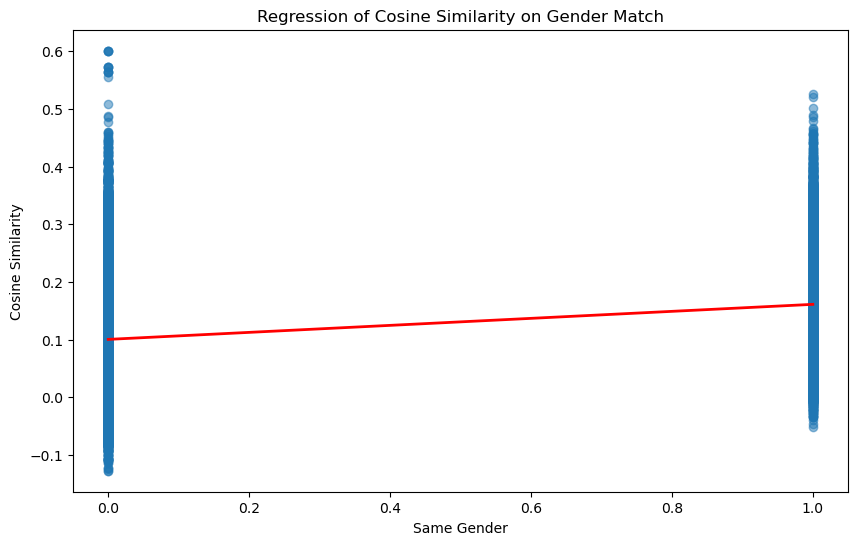

In [54]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind

# Assuming that test_data DataFrame is already defined and populated
test_data['SAME_GENDER'] = test_data['NOUN GRAMMATICAL GENDER'] == test_data['ADJECTIVE ASSOCIATION']

# Calculate average similarity for the same and different gender groups
avg_same_gender = test_data[test_data['SAME_GENDER'] == True]['COSINE SIMILARITY'].mean()
avg_diff_gender = test_data[test_data['SAME_GENDER'] == False]['COSINE SIMILARITY'].mean()

print(f'Average similarity for the same gender: {avg_same_gender}')
print(f'Average similarity for different genders: {avg_diff_gender}')

# Run an independent samples t-test
t_stat, p_val = ttest_ind(test_data[test_data['SAME_GENDER'] == True]['COSINE SIMILARITY'],
                          test_data[test_data['SAME_GENDER'] == False]['COSINE SIMILARITY'])

print(f'T-test statistic: {t_stat}, p-value: {p_val}')

# Fit a regression model
X = sm.add_constant(test_data['SAME_GENDER'].astype(int))  # add an intercept (beta_0) to our model
y = test_data['COSINE SIMILARITY']

model = sm.OLS(y, X)
results = model.fit()

print(results.summary())

# Plotting
plt.figure(figsize=(10,6))
plt.scatter(test_data['SAME_GENDER'], test_data['COSINE SIMILARITY'], alpha=0.5)
plt.plot(test_data['SAME_GENDER'], results.predict(X), color='red', linewidth=2)
plt.xlabel('Same Gender')
plt.ylabel('Cosine Similarity')
plt.title('Regression of Cosine Similarity on Gender Match')
plt.show()
